In [1]:
import numpy as np 
import pathlib 
import h5py
import os
import datetime 
import pandas as pd
import warnings
import scipy
import pathlib
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib_scalebar.scalebar import ScaleBar
import seaborn as sns
# import seaborn_image as isns
sns.set_theme()
sns.set_style("whitegrid")
import os 
import napari
import skimage.measure
import copy
import math
import natsort
import joblib
from joblib import Parallel, delayed

import space
import plotting
import temporal
import utilities
import filehandling
import utilities
import unit_conversion
import contouring
from utilities import multicolour_reshape as reshape 
import signal_analysis
import pickle
from collections.abc import Iterable
# qgrid.enable() 
# import pandasgui
# import tabloo


# %matplotlib widget
# plt.ioff()
# Lazy define some plotting params
chromatic_palette = ['red', 'green', 'blue', 'violet'] # R G B UV
rgbuv_palette = ['red', 'green', 'violet']
chromatic_hues = ["R", "G", "B", "UV"]

achromatic_palette = ['black', 'brown'] # BW BWnoUV 
achromatic_hues = ["BW", "BWnoUV"]
all_palette = chromatic_palette + achromatic_palette
all_hues = ["R", "G", "B", "UV", "BW", "BWnoUV"]
rguv_hues = ["R", "G", "UV"]
nanometers = ["588", "478", "422", "375"]
fish_palette = ["orange", "royalblue","blueviolet", "fuchsia"]


custom_params = {"axes.spines.right": False, "axes.spines.top": False}
sns.set_theme(style="white", rc=custom_params)
sns.set_context("notebook")
matplotlib.rcParams['svg.fonttype'] = 'none'
%reload_ext autoreload
%autoreload 2

# Get data, run analyses, and yield DataFrames

In [2]:
files = filehandling.find_files_in(".h5", r"C:\Users\Simen\Downloads", search_terms = ["ColourSWN", ], recursive=True) #"ColoursSWN"
files = filehandling.find_files_in(".h5", r"D:\Igor analyses", search_terms = ["ColourSWN", ], recursive=True) #"ColoursSWN"
# files = [r"D:\Igor analyses\230613\0_0_ColorSWN_200_0\2023-6-13_0_0_ColourSWN_200_0.h5"]
files


[WindowsPath('D:/Igor analyses/230613/0_0_ColorSWN_200_0/2023-6-13_0_0_ColourSWN_200_0.h5'),
 WindowsPath('D:/Igor analyses/230613/0_1_ColorSWN_200_0/2023-6-13_0_1_ColourSWN_200_0.h5'),
 WindowsPath('D:/Igor analyses/230614/0_1_ColorSWN_200_0/2023-6-14_SMP_0_2_ColourSWN_200_0.h5'),
 WindowsPath("D:/Igor analyses/230614/0_2_ColorSWN_200_0/2023-6-14_'0_2_ColourSWN_200_0'.h5"),
 WindowsPath("D:/Igor analyses/230718/0_1_ColorSWN_200_0/2023-7-18_'0_1_ColourSWN_200_0'.h5"),
 WindowsPath('D:/Igor analyses/230718/0_4_ColorSWN_200_0/2023-7-18_ColourSWN_200_0_4.h5'),
 WindowsPath("D:/Igor analyses/230731/0_1_ColourSWN_200_0/2023-7-31_'0_1_ColourSWN_200_0'.h5"),
 WindowsPath("D:/Igor analyses/230801/0_0_ColourSWN_0/2023-8-1_'0_0_ColourSWN_200_0'.h5"),
 WindowsPath("D:/Igor analyses/230802/0_1_ColourSWN_0/2023-8-2_'0_1_ColourSWN_200_0'.h5"),
 WindowsPath("D:/Igor analyses/230802/0_1_ColourSWN_1H/2023-8-2_'0_1_ColourSWN_200_1H'.h5"),
 WindowsPath('D:/Igor analyses/231107 rfs here/2023-11-7_0_0_Colo

In [3]:
loads = [filehandling.load_strf_data(i) for i in files]

C:\Users\SimenLab\AppData\Local\Temp\ipykernel_5212\1973573466.py:1: UserWarning: Rotation detected and corrected for D:\Igor analyses\230613\0_0_ColorSWN_200_0\2023-6-13_0_0_ColourSWN_200_0.h5
  loads = [filehandling.load_strf_data(i) for i in files]
C:\Users\SimenLab\AppData\Local\Temp\ipykernel_5212\1973573466.py:1: UserWarning: Rotation detected and corrected for D:\Igor analyses\230613\0_1_ColorSWN_200_0\2023-6-13_0_1_ColourSWN_200_0.h5
  loads = [filehandling.load_strf_data(i) for i in files]
C:\Users\SimenLab\AppData\Local\Temp\ipykernel_5212\1973573466.py:1: UserWarning: Rotation detected and corrected for D:\Igor analyses\230614\0_1_ColorSWN_200_0\2023-6-14_SMP_0_2_ColourSWN_200_0.h5
  loads = [filehandling.load_strf_data(i) for i in files]
C:\Users\SimenLab\AppData\Local\Temp\ipykernel_5212\1973573466.py:1: UserWarning: Rotation detected and corrected for D:\Igor analyses\230614\0_2_ColorSWN_200_0\2023-6-14_'0_2_ColourSWN_200_0'.h5
  loads = [filehandling.load_strf_data(i) fo

KeyboardInterrupt: 

In [4]:
filehandling.picklestore_objects(files, r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Pickles", do_bootstrap=True)

Iterating through, loading, and storing listed files as objects:   0%|          | 0/15 [00:00<?, ?it/s]

Output()

In [2]:
# pkl_files = filehandling.find_files_in(".pkl", r"D:\Pickles")
user = pathlib.Path(os.getcwd()).parts[2]
pkl_files = filehandling.find_files_in(".pkl", fr"C:\Users\{user}\OneDrive\Universitet\PhD\Pickles")
pkl_files

[WindowsPath('C:/Users/SimenLab/OneDrive/Universitet/PhD/Pickles/2023-11-7_0_0_ColourSWN_200.pkl'),
 WindowsPath('C:/Users/SimenLab/OneDrive/Universitet/PhD/Pickles/2023-11-7_0_2_ColourSWN_200_1.pkl'),
 WindowsPath('C:/Users/SimenLab/OneDrive/Universitet/PhD/Pickles/2023-11-7_0_4_ColourSWN_200.pkl'),
 WindowsPath('C:/Users/SimenLab/OneDrive/Universitet/PhD/Pickles/2023-11-7_MP_0_3_ColourSWN_200_.pkl'),
 WindowsPath('C:/Users/SimenLab/OneDrive/Universitet/PhD/Pickles/2023-11-8_MP_0_0_ColourSWN_200_.pkl'),
 WindowsPath('C:/Users/SimenLab/OneDrive/Universitet/PhD/Pickles/2023-6-13_0_0_ColourSWN_200_0.pkl'),
 WindowsPath('C:/Users/SimenLab/OneDrive/Universitet/PhD/Pickles/2023-6-13_0_1_ColourSWN_200_0.pkl'),
 WindowsPath("C:/Users/SimenLab/OneDrive/Universitet/PhD/Pickles/2023-6-14_'0_2_ColourSWN_200_0'.pkl"),
 WindowsPath('C:/Users/SimenLab/OneDrive/Universitet/PhD/Pickles/2023-6-14_SMP_0_2_ColourSWN_200_0.pkl'),
 WindowsPath("C:/Users/SimenLab/OneDrive/Universitet/PhD/Pickles/2023-7-18_'

In [270]:
loadfile = filehandling._load_parser(files[0])

c:\Users\Simen\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:531: UserWarning: Rotation detected and corrected for C:\Users\Simen\Downloads\2023-11-8_MP_0_0_ColourSWN_200_.h5
  loaded = load_strf_data(file_path, do_bootstrap = do_bootstrap)


Hang on, bootstrapping temporal components 2500 times:   0%|          | 0/124 [00:00<?, ?it/s]

Hang on, bootstrapping spatial components 1000 times:   0%|          | 0/124 [00:00<?, ?it/s]

### Run analysis and dump to pickle files

In [13]:
"""
Clearly there is a new paramteter (a bool) that breaks the dictionary compiling 
- Its probably the bootstrapping related param 
- Should figure out a way to auto account for those new params, because this shoulndt be THAT difficult ... (: --> Good luck 

Seems to work now but double check !
"""

'\nClearly there is a new paramteter (a bool) that breaks the dictionary compiling \n- Its probably the bootstrapping related param \n- Should figure out a way to auto account for those new params, because this shoulndt be THAT difficult ... (: --> Good luck \n\nSeems to work now but double check !\n'

In [42]:
roi_df, rec_df, chroma_df = filehandling.compile_chroma_strf_df(pkl_files, do_bootstrap = True) #, store_objects="D:\Pickles")
# roi_df, rec_df, chroma_df = filehandling.compile_chroma_strf_df(files, do_bootstrap = True, store_objects="D:\Pickles")
# Clearly, IPL_depths nan-ing is borked so you MUST have it otherwise the DFs are not the same size. Not bad, but a bit confusing
#rec_df.to_pickle(r"D:\DataFrames\rec_df.pkl")
#chroma_df.to_pickle(r"D:\DataFrames\chroma_df.pkl")

Current file: C:\Users\SimenLab\OneDrive\Universitet\PhD\Pickles\2023-11-7_0_0_ColourSWN_200.pkl
Current file: C:\Users\SimenLab\OneDrive\Universitet\PhD\Pickles\2023-11-7_0_2_ColourSWN_200_1.pkl
Current file: C:\Users\SimenLab\OneDrive\Universitet\PhD\Pickles\2023-11-7_0_4_ColourSWN_200.pkl


KeyboardInterrupt: 

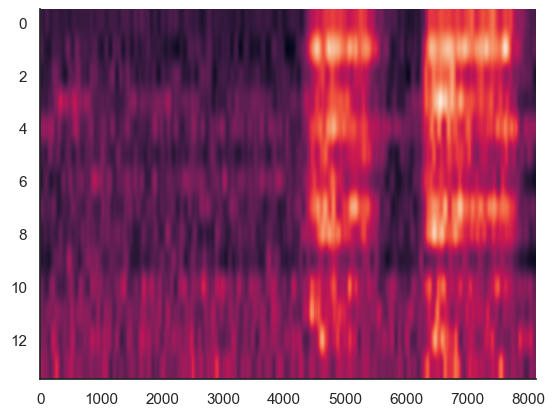

In [26]:
plt.imshow(filehandling.load_from_hdf5(r"D:\Igor analyses\231005\2023-10-5_MP_0_3_FFF_Colour_.h5").Averages0, aspect = "auto")

In [40]:
loaded

AttributeError: 'Data_strf' object has no attribute 'filename'

In [35]:
chroma_df["cell_id"][6]

'11-07-2023_STRF0_6'

In [14]:
filehandling.picklestore_objects(files, r"D:\Pickles\Test_output", do_bootstrap=True)

Iterating through, loading, and storing listed files as objects:   0%|          | 0/1 [00:00<?, ?it/s]

Output()

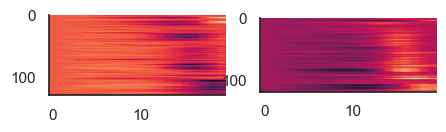

In [93]:
times_pos = []
times_neg = []
for i in range(0, 19):
    for i in roi_df.query(f"dom_peaktime == {i}").iloc:
        # if i["+timecourse"].is_masked 
        if np.all(i["+timecourse"]) != None:
            times_pos.append(i["+timecourse"])
        if np.all(i["-timecourse"]) != None:
            times_neg.append(i["-timecourse"])
times_pos = np.array(times_pos).astype("float")
times_neg = np.array(times_neg).astype("float")
fig, ax = plt.subplots(1, 2, figsize = (5, 5))
ax.flat[0].imshow(times_neg, aspect = .07)
ax.flat[1].imshow(times_pos, aspect = .07)

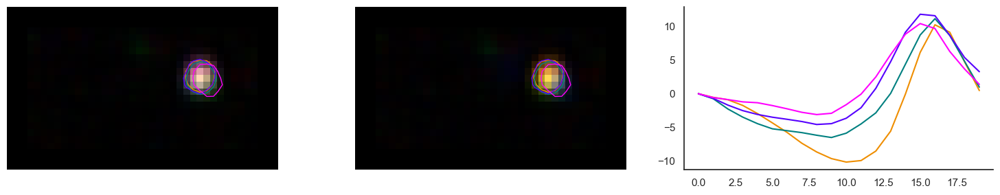

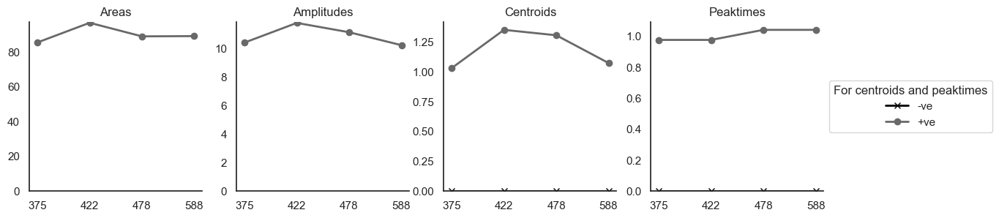

In [ ]:
def tuning_summary(Data_strf_multichrom, roi, um_size = 200):
    fig, ax = plt.subplots(1, 4, figsize = (14, 3))
    # Cycle properties first (otherwise doesnt overwrite)
    for n, i in enumerate(ax[:2]):
        i.set_prop_cycle(color=['dimgrey'], marker=['o'], lw = [2])
    for n, i in enumerate(ax[2:]):
        i.set_prop_cycle(color=['black', "dimgrey"], marker=['x', 'o'], lw = [2, 2])
    ax[0].plot(Data_strf_multichrom.area_tuning_functions(um_size)[roi])
    ax[1].plot(np.abs(Data_strf_multichrom.amplitude_tuning_functions()[roi]))
    ax[2].plot(np.nan_to_num(Data_strf_multichrom.centroid_tuning_functions()[:, roi].T))
    ax[3].plot(np.nan_to_num(Data_strf_multichrom.peaktime_tuning_functions()[:, roi].T), label = ["-ve", "+ve"])
    plt.legend(title = "For centroids and peaktimes", loc='center left', bbox_to_anchor=(1, 0.5))
    titles = ["Areas", "Amplitudes", "Centroids", "Peaktimes"]
    ax[0].set_prop_cycle(color=['red'], marker=['o'])
    for n, i in enumerate(ax):
        i.set_title(titles[n])
        i.set_ylim(0)
        i.set_xticks(np.arange(0, 4), nanometers)
        i.invert_xaxis() 
    plt.show()
roi = 28
plotting.visualise_summary(loadfile, roi)
tuning_summary(loadfile, roi)

In [171]:
# # Clean data
# params =  ["amp", "area", "peak", "cent"] #, "area", "cent", "peak", "pol"

# # Prepare scaled and non scaled version of DFs with empty rows 
# pruned_df = prep_input_df(load_df, params, scaler = StandardScaler())
# pruned_df_nonscale = prep_input_df(load_df, params, scaler=None)
# # temp_cols = cols_like(["ampl"], pruned_df)
# # pruned_df[temp_cols] = pruned_df[temp_cols].apply(sum_normalize_data, axis=0)

# # Run PCA
# pruned_pca, pruned_df_pca = df_pca(pruned_df, whiten=True)
# # Run clustering
# n_clust = 25
# pruned_df_clust = df_AggHierarchy(pruned_df_pca, n_clust)
# # Apply output 
# df_output = apply_clusters(pruned_df, pruned_df_clust)
# load_df_output = apply_clusters(prep_input_df(load_df), pruned_df_clust)

# no_empties_load_df = remove_missing_vals(load_df)
# df_output["ipl_depths"] = no_empties_load_df["ipl_depths"]
# # Write clusters to input data
# #stat_df = apply_clusters(remove_missing_vals(no_empties_load_df, return_numerical_only=True), load_df_output)
# output_df = apply_clusters(remove_missing_vals(load_df), pruned_df_clust)


# # Vizualize first n clusters
# # plots = []
# num_stats = int(len(cols_like(params, output_df)) / 4) - 1
# fig, ax = plt.subplots(n_clust, num_stats, figsize = (num_stats*3, n_clust*3), dpi = 150)
# fig.tight_layout()
# for n, i in enumerate(range(n_clust)):
#     plot_df_tuning(df_output[cols_like(["amp", "area", "peak", "ipl"], df_output)], pruned_df_clust, i, ax = ax[n, 0:num_stats])
# # fig.tight_layout()
# plt.tight_layout()

# # plt.show()
# # sns.boxplot(output_df, x = "cluster_id", y = "ipl_depths")
# # plt.title("Distribution of cell IPL depth by cluster")

# # # PCA for visualisation
# # clustering.display_factorial_planes(pruned_df_pca.to_numpy(), pruned_pca, [(0,1)], labels = pruned_df_clust["cluster_id"], 
# #     illustrative_var = pruned_df_clust["cluster_id"], alpha = 1,  cmap = "rainbow")

# # plot_df_tuning(pruned_df_nonscale, pruned_df_bGMM, [0, 1])

TypeError: float() argument must be a string or a real number, not 'datetime.date'

## PCA

2


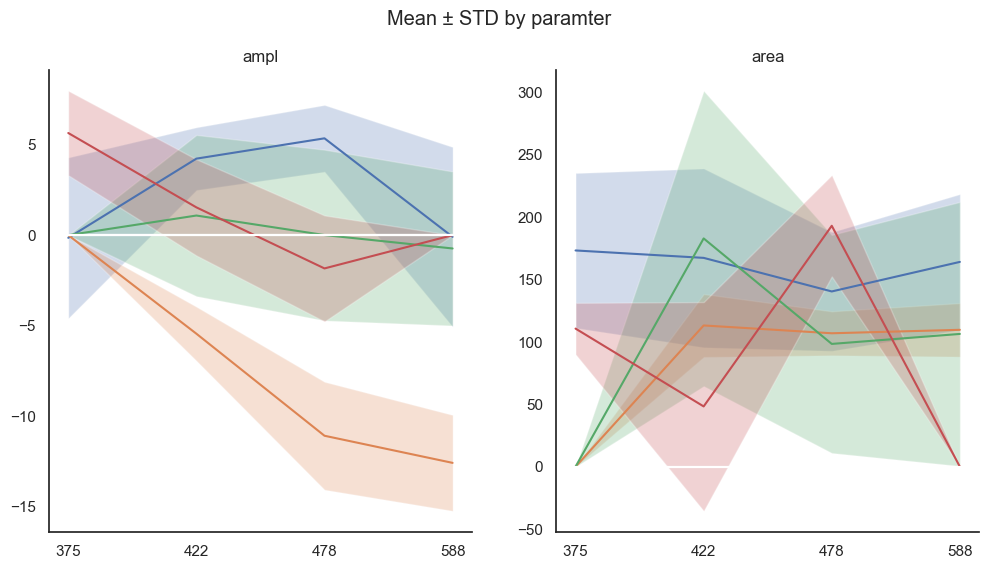

Index(['area_375', 'area_422', 'area_478', 'area_588', 'ampl_375', 'ampl_422',
       'ampl_478', 'ampl_588', 'peak_neg_375', 'peak_neg_422', 'peak_neg_478',
       'peak_neg_588', 'peak_pos_375', 'peak_pos_422', 'peak_pos_478',
       'peak_pos_588'],
      dtype='object')
['ampl' 'area' 'peak']


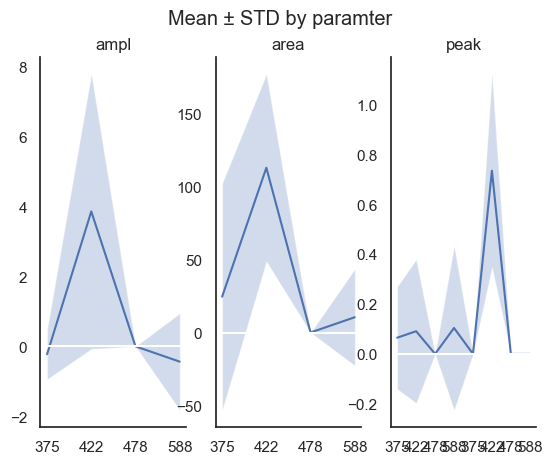

In [512]:
"""
Keep as older backup version:
"""
def plot_df_tuning(describe_df, plot_cols = "all", print_stat = False):
    """plot_df_tuning 
    
    

    Parameters
    ----------
    org_df : _type_
        The DataFrame from which the original data for clustering came from 
    describe_df : _type_
        DataFrame.describe() containing transformed, reduced, or otherwise data that clusters are generated from. 
        "cluster_id" must be present, and org_df and describe_df must contain the same number on indeces (?) 
    plot_cols : str, optional
        _description_, by default "all"
    print_stat : bool, optional
        _description_, by default False

    
    """

    # You will forget to exclude cluster so lets deal with that pre-emptively 
    if "cluster_id" in list(describe_df.columns):
        describe_df = describe_df.drop("cluster_id")
    if "cluster" in list(describe_df.columns):
        describe_df = describe_df.drop("cluster")
    if plot_cols == "all":
        print(describe_df.columns)
        unique_cols_sans_wavelength = np.unique([i.split("_")[0] for i in describe_df.columns])
        num_stats = len(unique_cols_sans_wavelength)
    fig, ax = plt.subplots(1, num_stats)
    fig.suptitle("Mean ± STD by paramter")
    print(unique_cols_sans_wavelength)
    for i, param in zip(ax.flat, unique_cols_sans_wavelength):
        wavelength_params = cols_like([param], describe_df)
        means =  describe_df[wavelength_params].loc["mean"]
        errors = describe_df[wavelength_params].loc["std"]
        if print_stat == True:
            print(results)
        i.set_title(param)
        i.plot(means)
        i.set_xticks(range(len(wavelength_params)), [i.split("_")[-1] for i in wavelength_params])
        i.fill_between(range(len(errors)), means - errors, means + errors, alpha = 0.25)
        i.axhline(0)

input_df_clusts = pruned_df_nonscale.copy()
input_df_clusts["cluster_id"] = pruned_df_kmeans["cluster_id"].values# """ERROR HERE BECAUSE CLUSTERS ARE APPLIED FRONT TO BACK; NOT BY INDEX!!!!"""
# pd.insert()


results = get_cluster_cols(0, ["area", "ampl", "peak"], input_df_clusts).describe()
# plot_df_stats(results)
plot_df_tuning(results)

In [515]:
pruned_df_nonscale

,ampl_375,ampl_422,ampl_478,ampl_588,area_375,area_422,area_478,area_588,cent_neg_375,cent_neg_422,...,peak_neg_478,peak_neg_588,peak_pos_375,peak_pos_422,peak_pos_478,peak_pos_588,pol_375,pol_422,pol_478,pol_588
0,0.0,-3.146731,0.000000,-5.728493,0.0,273.020,0.000,229.862,0.0,1.681273,...,0.000,1.105,0.0,0.000,0.00,0.000,0.0,-1.0,0.0,-1.0
3,0.0,0.000000,0.000000,-2.535450,0.0,0.000,0.000,200.981,0.0,0.000000,...,0.000,1.105,0.0,0.000,0.00,0.000,0.0,0.0,0.0,-1.0
4,0.0,-2.524566,2.490904,3.296836,0.0,169.177,224.711,223.207,0.0,0.941343,...,0.000,0.000,0.0,1.170,1.04,1.040,0.0,2.0,1.0,1.0
5,0.0,2.283270,-1.748282,0.000000,0.0,134.430,166.556,0.000,0.0,0.000000,...,1.040,0.000,0.0,0.975,0.00,0.000,0.0,1.0,-1.0,0.0
6,0.0,0.000000,0.000000,-1.841545,0.0,0.000,0.000,211.349,0.0,0.000000,...,0.000,0.390,0.0,0.000,0.00,1.105,0.0,0.0,0.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
474,0.0,0.000000,0.000000,1.885557,0.0,0.000,0.000,163.501,0.0,0.000000,...,0.000,0.000,0.0,0.000,0.00,0.910,0.0,0.0,0.0,1.0
475,0.0,2.564809,3.203802,-3.900229,0.0,142.619,109.147,206.943,0.0,0.000000,...,0.000,0.715,0.0,0.975,1.04,1.105,0.0,1.0,1.0,2.0
476,0.0,-3.602501,-6.267203,0.000000,0.0,91.226,101.136,0.000,0.0,1.581760,...,0.975,0.000,0.0,0.000,0.00,0.000,0.0,-1.0,-1.0,0.0
477,0.0,0.000000,0.000000,2.871972,0.0,0.000,0.000,106.099,0.0,0.000000,...,0.000,0.000,0.0,0.000,0.00,0.975,0.0,0.0,0.0,1.0


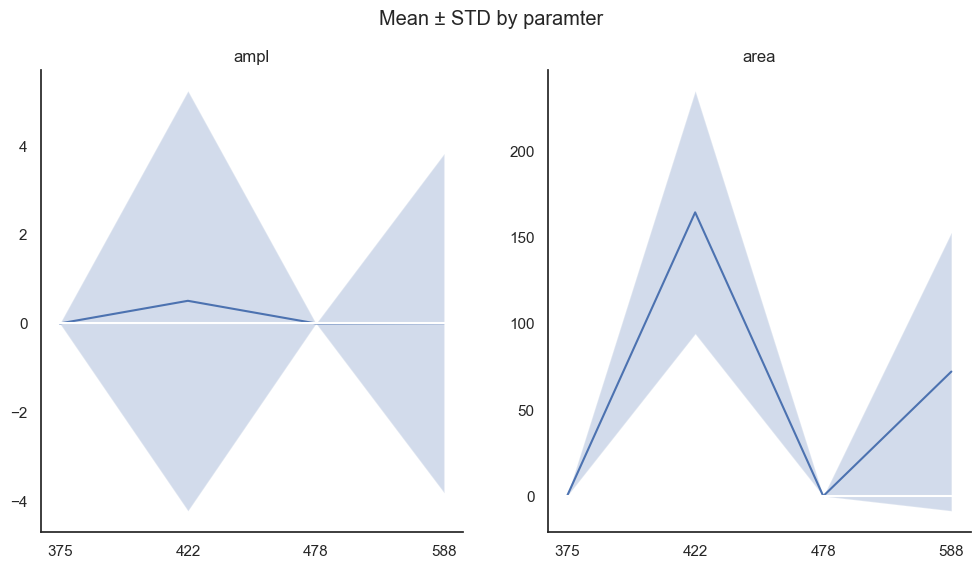

In [549]:
# results
# """
# TODO
# - Sort out input function: What's the simplest, easiest way for user to input data? 
#     -> To me, would make sense to input the original (cleaned) DF array, clusters as a series/list/array, and the metrics as a separate input
#     -> 
# - Plot should be cluster x metric sized, with option of passing only 1 metric or specifying cluster (for 1 ez plot) 
# """

In [531]:
pruned_df_bGMM.describe()

,ampl_375,ampl_422,ampl_478,ampl_588,area_375,area_422,area_478,area_588,centneg_375,centneg_422,...,peakneg_588,peakpos_375,peakpos_422,peakpos_478,peakpos_588,pol_375,pol_422,pol_478,pol_588,cluster_id
count,3.960000e+02,3.960000e+02,3.960000e+02,3.960000e+02,3.960000e+02,3.960000e+02,3.960000e+02,3.960000e+02,3.960000e+02,3.960000e+02,...,3.960000e+02,3.960000e+02,3.960000e+02,3.960000e+02,3.960000e+02,3.960000e+02,3.960000e+02,3.960000e+02,3.960000e+02,396.000000
mean,7.177199e-17,-5.382900e-17,-5.382900e-17,-4.485750e-17,-4.485750e-17,1.525155e-16,-1.345725e-17,-1.794300e-17,1.794300e-17,-7.625774e-17,...,-1.570012e-17,-8.971499e-17,4.485750e-17,-5.831474e-17,-7.177199e-17,3.588600e-17,2.803593e-17,-2.242875e-17,-3.588600e-17,11.292929
std,1.001265e+00,1.001265e+00,1.001265e+00,1.001265e+00,1.001265e+00,1.001265e+00,1.001265e+00,1.001265e+00,1.001265e+00,1.001265e+00,...,1.001265e+00,1.001265e+00,1.001265e+00,1.001265e+00,1.001265e+00,1.001265e+00,1.001265e+00,1.001265e+00,1.001265e+00,6.271902
min,-3.614411e+00,-2.865925e+00,-2.608490e+00,-2.545021e+00,-7.241786e-01,-9.484736e-01,-1.076414e+00,-1.205314e+00,-4.283024e-01,-5.823140e-01,...,-9.354904e-01,-7.468932e-01,-8.667535e-01,-6.283345e-01,-7.249262e-01,-1.663112e+00,-1.494643e+00,-1.057664e+00,-1.034954e+00,0.000000
25%,-1.472154e-01,-4.779052e-01,-5.675950e-01,-6.906133e-01,-7.241786e-01,-9.484736e-01,-1.076414e+00,-3.491505e-01,-4.283024e-01,-5.823140e-01,...,-9.354904e-01,-7.468932e-01,-8.667535e-01,-6.283345e-01,-7.249262e-01,-3.485565e-01,-3.757797e-01,-1.057664e+00,-1.034954e+00,6.000000
50%,-1.472154e-01,-1.409661e-01,2.516495e-01,-2.837689e-02,1.230054e-01,7.987915e-02,5.016549e-02,-6.810661e-02,-4.283024e-01,-5.823140e-01,...,-9.354904e-01,-7.468932e-01,-8.667535e-01,-6.283345e-01,-7.249262e-01,-3.485565e-01,-3.757797e-01,2.180751e-02,3.234231e-02,12.000000
75%,5.775569e-01,7.234963e-01,2.516495e-01,6.476503e-01,4.238683e-01,3.597703e-01,4.755068e-01,4.320347e-01,-4.283024e-01,6.612470e-01,...,9.859525e-01,1.288219e+00,1.034070e+00,1.423511e+00,1.267713e+00,9.659994e-01,7.430831e-01,1.101280e+00,1.099639e+00,16.000000
max,2.444401e+00,2.274225e+00,2.428840e+00,2.758567e+00,6.920128e+00,6.375114e+00,5.698546e+00,6.383209e+00,5.566238e+00,3.831292e+00,...,1.498337e+00,1.830916e+00,1.712935e+00,1.970670e+00,1.757707e+00,2.280555e+00,1.861946e+00,2.180751e+00,2.166935e+00,24.000000


In [524]:
pruned_df.columns

Index(['ampl_375', 'ampl_422', 'ampl_478', 'ampl_588', 'area_375', 'area_422',
       'area_478', 'area_588', 'centneg_375', 'centneg_422', 'centneg_478',
       'centneg_588', 'centpos_375', 'centpos_422', 'centpos_478',
       'centpos_588', 'peakneg_375', 'peakneg_422', 'peakneg_478',
       'peakneg_588', 'peakpos_375', 'peakpos_422', 'peakpos_478',
       'peakpos_588', 'pol_375', 'pol_422', 'pol_478', 'pol_588'],
      dtype='object')

In [525]:
pruned_df_nonscale.columns

Index(['ampl_375', 'ampl_422', 'ampl_478', 'ampl_588', 'area_375', 'area_422',
       'area_478', 'area_588', 'centneg_375', 'centneg_422', 'centneg_478',
       'centneg_588', 'centpos_375', 'centpos_422', 'centpos_478',
       'centpos_588', 'peakneg_375', 'peakneg_422', 'peakneg_478',
       'peakneg_588', 'peakpos_375', 'peakpos_422', 'peakpos_478',
       'peakpos_588', 'pol_375', 'pol_422', 'pol_478', 'pol_588'],
      dtype='object')

In [425]:
results

,area_375,area_422,area_478,area_588,ampl_375,ampl_422,ampl_478,ampl_588,peak_neg_375,peak_neg_422,peak_neg_478,peak_neg_588,peak_pos_375,peak_pos_422,peak_pos_478,peak_pos_588
18,0.000,214.123,155.664,176.536,0.000000,-1.558986,-4.344039,-5.309467,0.00,0.845,1.040,1.040,0.00,1.170,0.000,0.000
20,0.000,199.333,0.000,191.065,0.000000,-2.495522,0.000000,3.410846,0.00,0.390,0.000,0.000,0.00,1.105,0.000,1.040
38,0.000,232.379,175.848,157.732,0.000000,-2.984177,-3.661065,-4.321765,0.00,1.040,1.040,0.975,0.00,1.105,0.000,0.000
52,0.000,263.021,0.000,149.034,0.000000,-3.615754,0.000000,5.231726,0.00,0.585,0.000,0.000,0.00,1.040,0.000,0.975
54,0.000,248.106,0.000,0.000,0.000000,3.156018,0.000000,0.000000,0.00,0.000,0.000,0.000,0.00,0.975,0.000,0.000
55,0.000,180.198,0.000,144.775,0.000000,-4.103755,0.000000,5.222359,0.00,0.715,0.000,0.000,0.00,1.040,0.000,1.040
101,0.000,517.887,0.000,0.000,0.000000,1.455223,0.000000,0.000000,0.00,1.235,0.000,0.000,0.00,0.650,0.000,0.000
119,0.000,587.855,0.000,0.000,0.000000,2.552938,0.000000,0.000000,0.00,1.105,0.000,0.000,0.00,0.845,0.000,0.000
129,0.000,540.849,0.000,451.637,0.000000,1.909620,0.000000,3.043993,0.00,1.040,0.000,0.000,0.00,0.910,0.000,0.975
179,121.977,177.844,129.232,117.832,-6.130845,-2.539401,-2.569183,4.934157,0.91,0.975,0.975,0.000,0.00,1.105,0.000,1.040


In [392]:
input_df_clusts

,ampl_375,ampl_422,ampl_478,ampl_588,area_375,area_422,area_478,area_588,cent_neg_375,cent_neg_422,...,peak_neg_588,peak_pos_375,peak_pos_422,peak_pos_478,peak_pos_588,pol_375,pol_422,pol_478,pol_588,cluster_id
0,0.0,-3.146731,0.000000,-5.728493,0.0,273.020,0.000,229.862,0.0,1.681273,...,1.105,0.0,0.000,0.00,0.000,0.0,-1.0,0.0,-1.0,14
3,0.0,0.000000,0.000000,-2.535450,0.0,0.000,0.000,200.981,0.0,0.000000,...,1.105,0.0,0.000,0.00,0.000,0.0,0.0,0.0,-1.0,6
4,0.0,-2.524566,2.490904,3.296836,0.0,169.177,224.711,223.207,0.0,0.941343,...,0.000,0.0,1.170,1.04,1.040,0.0,2.0,1.0,1.0,11
5,0.0,2.283270,-1.748282,0.000000,0.0,134.430,166.556,0.000,0.0,0.000000,...,0.000,0.0,0.975,0.00,0.000,0.0,1.0,-1.0,0.0,1
6,0.0,0.000000,0.000000,-1.841545,0.0,0.000,0.000,211.349,0.0,0.000000,...,0.390,0.0,0.000,0.00,1.105,0.0,0.0,0.0,2.0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
474,0.0,0.000000,0.000000,1.885557,0.0,0.000,0.000,163.501,0.0,0.000000,...,0.000,0.0,0.000,0.00,0.910,0.0,0.0,0.0,1.0,10
475,0.0,2.564809,3.203802,-3.900229,0.0,142.619,109.147,206.943,0.0,0.000000,...,0.715,0.0,0.975,1.04,1.105,0.0,1.0,1.0,2.0,11
476,0.0,-3.602501,-6.267203,0.000000,0.0,91.226,101.136,0.000,0.0,1.581760,...,0.000,0.0,0.000,0.00,0.000,0.0,-1.0,-1.0,0.0,14
477,0.0,0.000000,0.000000,2.871972,0.0,0.000,0.000,106.099,0.0,0.000000,...,0.000,0.0,0.000,0.00,0.975,0.0,0.0,0.0,1.0,10


In [383]:
input_df_clusts

,ampl_375,ampl_422,ampl_478,ampl_588,area_375,area_422,area_478,area_588,cent_neg_375,cent_neg_422,...,peak_neg_588,peak_pos_375,peak_pos_422,peak_pos_478,peak_pos_588,pol_375,pol_422,pol_478,pol_588,cluster_id
0,0.0,-3.146731,0.000000,-5.728493,0.0,273.020,0.000,229.862,0.0,1.681273,...,1.105,0.0,0.000,0.00,0.000,0.0,-1.0,0.0,-1.0,14
3,0.0,0.000000,0.000000,-2.535450,0.0,0.000,0.000,200.981,0.0,0.000000,...,1.105,0.0,0.000,0.00,0.000,0.0,0.0,0.0,-1.0,6
4,0.0,-2.524566,2.490904,3.296836,0.0,169.177,224.711,223.207,0.0,0.941343,...,0.000,0.0,1.170,1.04,1.040,0.0,2.0,1.0,1.0,11
5,0.0,2.283270,-1.748282,0.000000,0.0,134.430,166.556,0.000,0.0,0.000000,...,0.000,0.0,0.975,0.00,0.000,0.0,1.0,-1.0,0.0,1
6,0.0,0.000000,0.000000,-1.841545,0.0,0.000,0.000,211.349,0.0,0.000000,...,0.390,0.0,0.000,0.00,1.105,0.0,0.0,0.0,2.0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
474,0.0,0.000000,0.000000,1.885557,0.0,0.000,0.000,163.501,0.0,0.000000,...,0.000,0.0,0.000,0.00,0.910,0.0,0.0,0.0,1.0,10
475,0.0,2.564809,3.203802,-3.900229,0.0,142.619,109.147,206.943,0.0,0.000000,...,0.715,0.0,0.975,1.04,1.105,0.0,1.0,1.0,2.0,11
476,0.0,-3.602501,-6.267203,0.000000,0.0,91.226,101.136,0.000,0.0,1.581760,...,0.000,0.0,0.000,0.00,0.000,0.0,-1.0,-1.0,0.0,14
477,0.0,0.000000,0.000000,2.871972,0.0,0.000,0.000,106.099,0.0,0.000000,...,0.000,0.0,0.000,0.00,0.975,0.0,0.0,0.0,1.0,10


In [372]:
help(pd.concatenate())

AttributeError: module 'pandas' has no attribute 'concatenate'

In [369]:
input_df_clusts

,date,path,filename,curr_path,strf_keys,cell_id,size,ipl_depths,opp_bool,ampl_375,...,peak_neg_588,peak_pos_375,peak_pos_422,peak_pos_478,peak_pos_588,pol_375,pol_422,pol_478,pol_588,cluster_id
0,2023-11-07,D:\Igor analyses\231107 rfs here\2023-11-7_0_0...,2023-11-7_0_0_ColourSWN_200.h5,C:\Users\Simen\OneDrive\Universitet\PhD\Pickle...,STRF0_0,11-07-2023_STRF0_0,200,88.0,False,0.0,...,1.105,0.0,0.00,0.00,0.000,NaN,-1.0,NaN,-1.0,1.0
1,2023-11-07,D:\Igor analyses\231107 rfs here\2023-11-7_0_0...,2023-11-7_0_0_ColourSWN_200.h5,C:\Users\Simen\OneDrive\Universitet\PhD\Pickle...,STRF0_1,11-07-2023_STRF0_1,200,70.0,True,0.0,...,0.000,0.0,0.00,0.00,0.000,NaN,NaN,NaN,NaN,16.0
2,2023-11-07,D:\Igor analyses\231107 rfs here\2023-11-7_0_0...,2023-11-7_0_0_ColourSWN_200.h5,C:\Users\Simen\OneDrive\Universitet\PhD\Pickle...,STRF0_2,11-07-2023_STRF0_2,200,52.0,True,0.0,...,0.000,0.0,0.00,0.00,0.000,NaN,NaN,NaN,NaN,23.0
3,2023-11-07,D:\Igor analyses\231107 rfs here\2023-11-7_0_0...,2023-11-7_0_0_ColourSWN_200.h5,C:\Users\Simen\OneDrive\Universitet\PhD\Pickle...,STRF0_3,11-07-2023_STRF0_3,200,90.0,False,0.0,...,1.105,0.0,0.00,0.00,0.000,NaN,NaN,NaN,-1.0,8.0
4,2023-11-07,D:\Igor analyses\231107 rfs here\2023-11-7_0_0...,2023-11-7_0_0_ColourSWN_200.h5,C:\Users\Simen\OneDrive\Universitet\PhD\Pickle...,STRF0_4,11-07-2023_STRF0_4,200,26.0,True,0.0,...,0.000,0.0,1.17,1.04,1.040,NaN,2.0,1.0,1.0,12.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
476,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,C:\Users\Simen\OneDrive\Universitet\PhD\Pickle...,STRF0_20,08-02-2023_STRF0_20,200,83.0,False,0.0,...,0.000,0.0,0.00,0.00,0.000,NaN,-1.0,-1.0,NaN,NaN
477,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,C:\Users\Simen\OneDrive\Universitet\PhD\Pickle...,STRF0_21,08-02-2023_STRF0_21,200,61.0,False,0.0,...,0.000,0.0,0.00,0.00,0.975,NaN,NaN,NaN,1.0,NaN
478,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,C:\Users\Simen\OneDrive\Universitet\PhD\Pickle...,STRF0_22,08-02-2023_STRF0_22,200,84.0,True,0.0,...,0.000,0.0,0.00,0.00,0.000,NaN,NaN,NaN,NaN,NaN
479,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,C:\Users\Simen\OneDrive\Universitet\PhD\Pickle...,STRF0_23,08-02-2023_STRF0_23,200,34.0,False,0.0,...,0.000,0.0,0.00,1.17,0.000,NaN,NaN,2.0,NaN,NaN


In [350]:
pruned_df_kmeans

,area_375,area_422,area_478,area_588,ampl_375,ampl_422,ampl_478,ampl_588
count,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000
mean,119.628033,129.604167,78.863167,166.727633,0.270813,0.847681,0.047915,-1.185989
std,206.400368,129.317574,119.386980,152.672744,4.797307,4.995757,6.237502,7.072582
min,0.000000,0.000000,0.000000,0.000000,-9.497293,-8.765786,-11.878086,-13.118639
25%,0.000000,0.000000,0.000000,95.406750,0.000000,0.000000,-1.343965,-7.975989
50%,42.641500,101.900500,40.994500,112.922500,0.000000,0.000000,0.000000,0.000000
75%,110.651750,212.808250,102.911000,203.947250,1.930629,3.325888,0.000000,3.711826
max,779.198000,500.425000,569.841000,630.536000,10.990853,11.783779,12.207395,10.221946


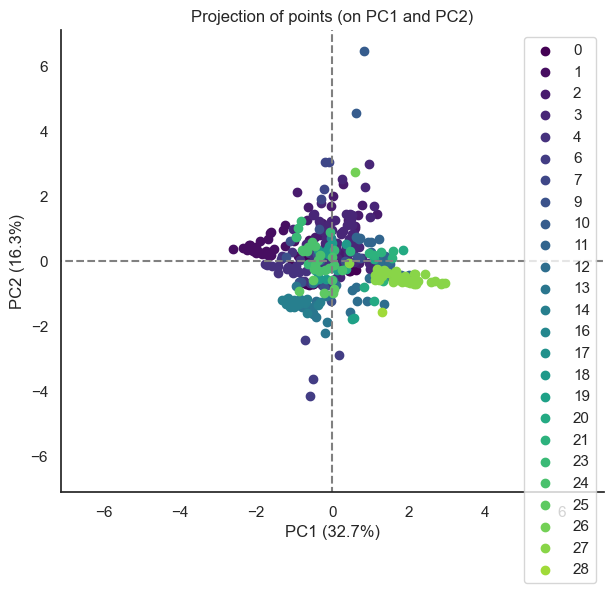

In [167]:
# Clean data
pruned_df = prep_input_df(load_df, ["amp", "area"])
# Run PCA
pruned_pca, pruned_df_pca = df_pca(pruned_df)
# Run clustering
pruned_df_kmeans = df_BayesGMM(pruned_df_pca)
# PCA for visualisation
clustering.display_factorial_planes(pruned_df_pca.to_numpy(), pruned_pca, [(0,1)], labels = pruned_df_kmeans["cluster_id"], illustrative_var = pruned_df_kmeans["cluster_id"], alpha = 1)

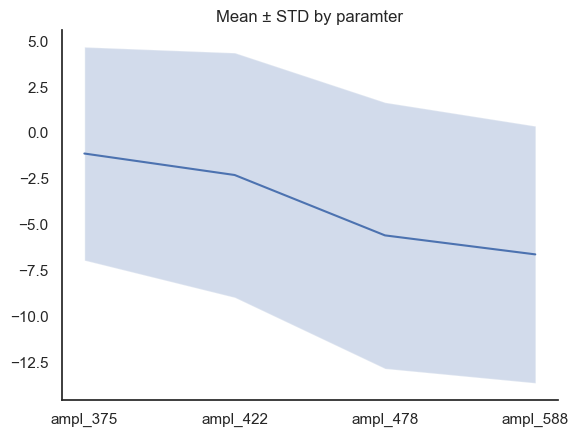

In [168]:
input_df_clusts = df_clust.copy()
input_df_clusts["cluster_id"] = pruned_df_GMM["cluster_id"]
results = get_cluster_cols(0, ["ampl"], input_df_clusts).describe()
plot_df_stats(results)

## PCA

In [112]:
n_comps = 4
pca = PCA(n_components=n_comps, whiten = True)
pca.fit(input_df)
reduced = pca.transform(input_df)
reduced_df = pd.DataFrame(reduced, index = input_df.index, columns = [f"PC{i}" for i in range(n_comps)])

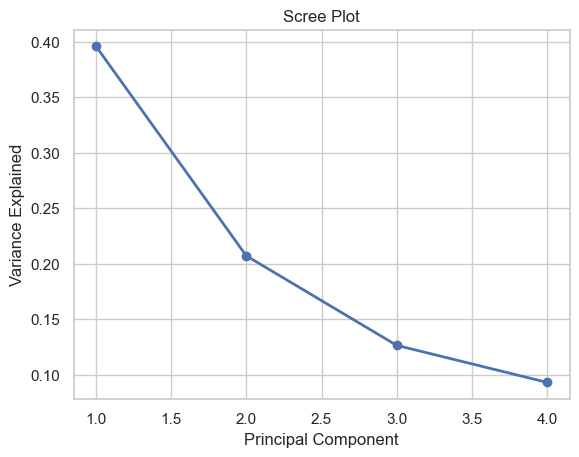

In [113]:
PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'o-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Variance Explained')
plt.show()

### Post-PCA clustering

### Visualize

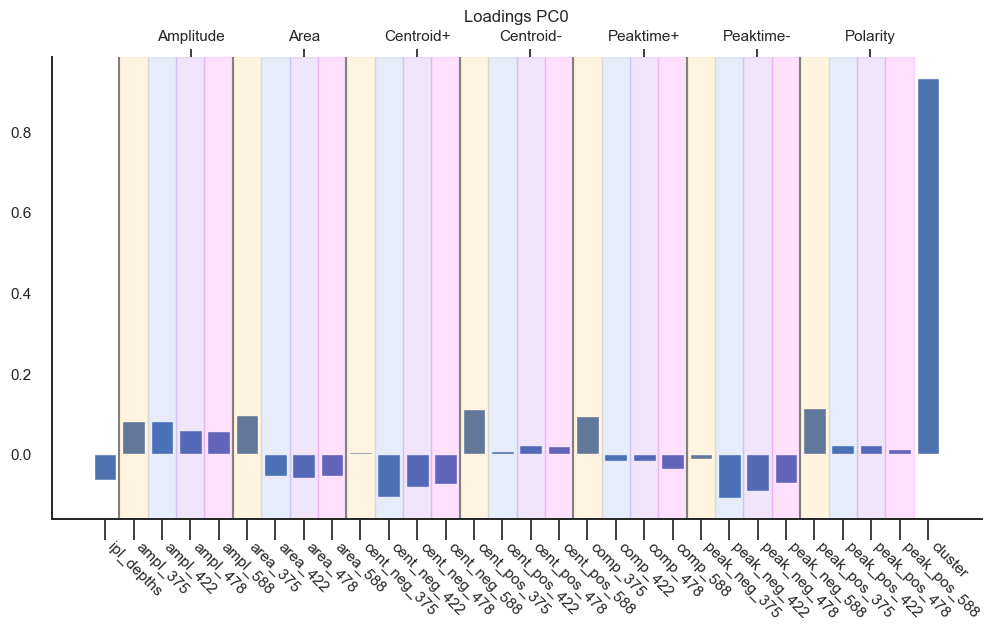

In [229]:
import itertools
colour_cycle = itertools.cycle(fish_palette)
fig, ax = plt.subplots(figsize = (12, 6))
def plot_stat(stat, **kwargs):
    plot_range = range(len(stat))
    ax.bar(plot_range, stat)
    ax.set_xticks(plot_range)
    ax.set_xticklabels(df_clust_scaled.columns, rotation=-45, ha='left');
    ax.tick_params(bottom=True, left=False, length = 15, pad = -.5)
    title_list = ["Amplitude", "Area", "Centroid+", "Centroid-", "Peaktime+", "Peaktime-", "Polarity"]
    for i in range(len(title_list)):
        ax.axvline(4 * i + .5, c = "grey", alpha = 1)
    colour_loop = np.tile(fish_palette, int(25 / 4)+1)
    for i in range(4 * len(title_list)):
        ax.axvspan(i+.5, i+1.5, color = colour_loop[i], alpha = 0.12)
    ax2 = ax.twiny()
    ax2.set_xticks(np.linspace(.15, .88, len(title_list)))
    ax2.set_xticklabels(title_list);
    #np.arange(24)[:5]:
    if "title" in kwargs:
        ax.set_title(kwargs["title"])
num = 0
plot_stat(loadings_df[f"PC{num}"], title = f"Loadings PC{num}")


### Interperting results

IndexError: list index out of range

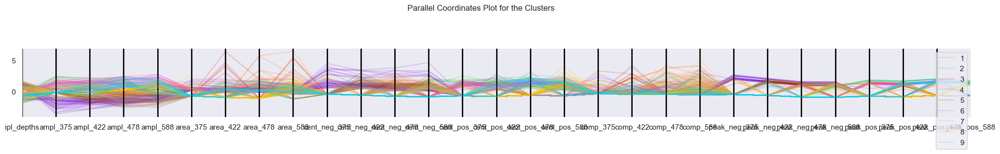

In [193]:
from pandas.plotting import parallel_coordinates

palette = sns.color_palette("bright", 10)
def display_parallel_coordinates(df, num_clusters):
    def addAlpha(colour, alpha):
        '''Add an alpha to the RGB colour'''
        return (colour[0],colour[1],colour[2],alpha)
    '''Display a parallel coordinates plot for the clusters in df'''

    # Select data points for individual clusters
    cluster_points = []
    for i in range(num_clusters):
        cluster_points.append(df[df.cluster==i])
    
    # Create the plot
    fig = plt.figure(figsize=(25, 30))
    title = fig.suptitle("Parallel Coordinates Plot for the Clusters", fontsize=12)
    fig.subplots_adjust(top=0.95, wspace=0)

    # Display one plot for each cluster, with the lines for the main cluster appearing over the lines for the other clusters
    for i in range(num_clusters):    
        plt.subplot(num_clusters, 1, i+1)
        for j,c in enumerate(cluster_points): 
            if i!= j:
                pc = parallel_coordinates(c, 'cluster', color=[addAlpha(palette[j],0.2)])
        pc = parallel_coordinates(cluster_points[i], 'cluster', color=[addAlpha(palette[i],0.5)])

        # Stagger the axes
        ax=plt.gca()
        for tick in ax.xaxis.get_major_ticks()[1::2]:
            tick.set_pad(20)        
    fig.tight_layout()


# Display parallel coordinates plots, one for each cluster
display_parallel_coordinates(X_clustered, n_comps)

### Clustering on the PCA 

Text(0.5, 1.0, 'Clustering on PCA')

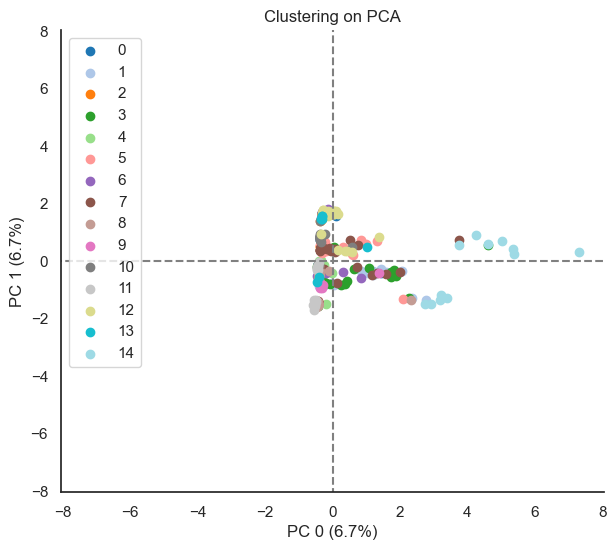

In [236]:
pca.fit(reduced_df)
pca_clust = pca.transform(reduced_df)
pca_clust_df = pd.DataFrame(pca_clust, index = reduced_df.index, columns = [f"PC{i}" for i in range(n_comps)])
pca_kmeans = KMeans(n_clusters=n_comps, random_state=0, n_init="auto")
pca_kmeans.fit(reduced_df)
pca_clusters = pca_kmeans.predict(reduced_df)
display_factorial_planes(reduced, pca, [(0,1)], category_lables = pca_clusters, alpha = 1)
plt.title("Clustering on PCA")

### Gaussian mixed model 

In [409]:
import numpy as np
from sklearn.mixture import BayesianGaussianMixture
X = df_clust_scaled
gm = BayesianGaussianMixture(n_components=15, random_state=0, max_iter = 1000, covariance_type="full").fit(X[:int( len(X) - len(X) * 0.1)])
labels = gm.predict(X)
# display_factorial_planes(reduced, pca, [(0,1)], category_lables = labels, alpha = 1)
labels

array([ 8,  2,  9,  7,  2,  9,  2,  7,  7,  7,  9,  7,  2,  8,  9,  2,  9,
       10,  7,  2,  7,  2,  4,  2,  8,  3, 11,  5, 14,  2,  5, 14,  9, 14,
        9,  2,  0,  9,  2,  2, 14, 13, 13,  2,  2,  8, 13,  6,  6,  6,  6,
        6,  6,  6,  6,  6, 13, 13,  0, 13, 12, 12, 11,  3,  3,  3,  3,  3,
        3, 12,  7, 13, 11, 12, 10, 13, 13,  0,  9, 14,  6,  4,  4, 14, 14,
       14,  0, 14,  4,  9,  2,  9,  9,  3,  4,  2,  3,  2,  2,  7,  9,  9,
        9,  4,  7,  4,  6,  3, 14,  3,  6,  6,  3, 12, 12,  6,  6, 12,  3,
        3,  6, 12,  3,  6,  6, 11, 14,  6, 12,  3,  6,  3,  6,  6,  3,  6,
       14,  3, 12,  1,  3, 13,  6,  7,  3,  3,  9,  2,  1, 14,  4, 13,  2,
        2,  1,  8, 13,  2,  7, 14,  4,  1,  6,  6,  6,  6, 14,  6,  0,  8,
        8,  2,  0,  2,  0,  0,  3,  3,  3,  3,  3,  0,  0, 11,  9, 14, 14,
        2,  7, 14,  0, 11,  7,  1, 14, 11,  3, 10, 12, 12, 14,  3, 12,  4,
       12,  4, 11,  4, 11,  3, 14, 11,  1, 12,  3,  1,  1, 12, 12,  3, 14,
        3,  0, 14, 11, 11

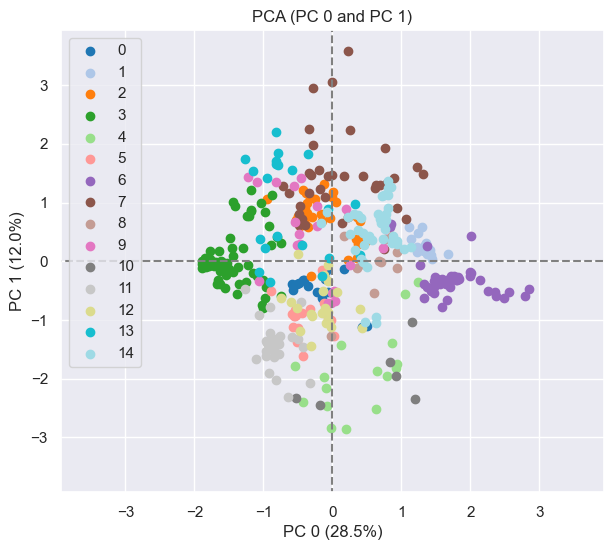

In [410]:
display_factorial_planes(reduced, pca, [(0,1)], category_lables = labels, alpha = 1)


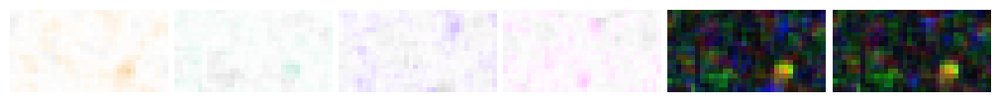

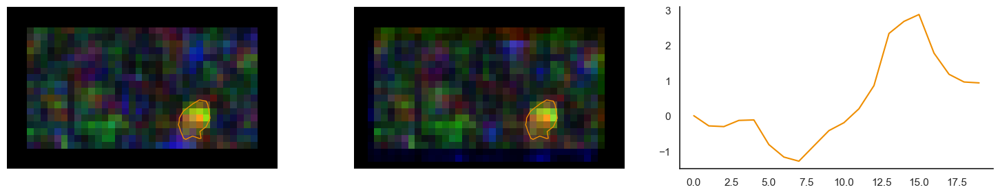

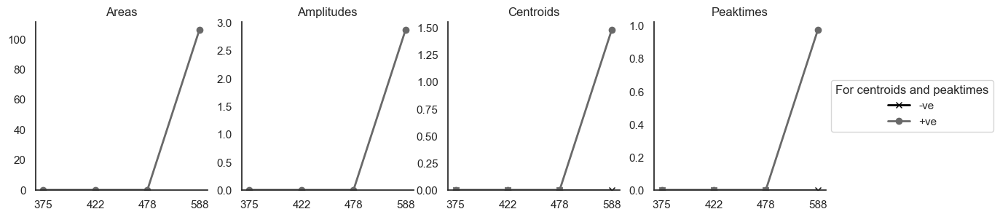

In [ ]:
# Doing this, it seems like the clustering has definitively picked up a pattern 
index = 255
name_load = pathlib.Path(chroma_df.iloc[index]["filename"]).stem
roi = int(chroma_df.iloc[index]["strf_keys"].split('_')[1])
temp_load = filehandling.load(rf"C:\Users\Simen\OneDrive\Universitet\PhD\Pickles\{name_load}.pkl")
plotting.chroma_overview(temp_load, roi)
plotting.visualise_summary(temp_load, roi)
tuning_summary(temp_load, roi)


In [ ]:
temp_load.calc_LED_offset()

array([ 0.26682562, -2.53047491])

### Save anaylsis files as pickle files 

In [ ]:
roi_df.to_pickle(r"D:\DataFrames\roi_df_bootstrapped.pkl")
rec_df.to_pickle(r"D:\DataFrames\rec_df_bootstrapped.pkl")
chroma_df.to_pickle(r"D:\DataFrames\chroma_df_bootstrapped.pkl")

### Load analysis from pickle files 

In [ ]:
roi_df = pd.read_pickle(r"D:\DataFrames\roi_df.pkl")
rec_df = pd.read_pickle(r"D:\DataFrames\rec_df.pkl")
chroma_df = pd.read_pickle(r"D:\DataFrames\chroma_df.pkl")

In [ ]:
chroma_df

,date,path,filename,strf_keys,cell_id,size,ipl_depths,area_r,area_g,area_b,...,pos_cent_b,pos_cent_uv,neg_peak_r,neg_peak_g,neg_peak_b,neg_peak_uv,pos_peak_r,pos_peak_g,pos_peak_b,pos_peak_uv
0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_0,06-13-2023_STRF0_0,200,74.0,141.409,149.610,0.000,...,NaN,NaN,0.975,0.975,0.00,0.0,0.000,0.00,0.000,0.000
1,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_1,06-13-2023_STRF0_1,200,10.0,0.000,0.000,169.899,...,0.842077,0.900334,0.000,0.000,0.00,0.0,0.000,0.00,0.910,0.845
2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_2,06-13-2023_STRF0_2,200,48.0,0.000,0.000,164.498,...,0.804231,1.404772,0.000,0.000,0.00,0.0,0.000,0.00,0.845,0.975
3,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_3,06-13-2023_STRF0_3,200,67.0,194.347,175.206,0.000,...,NaN,NaN,0.975,0.975,0.00,0.0,0.000,0.00,0.000,0.000
4,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_4,06-13-2023_STRF0_4,200,90.0,111.198,122.016,122.506,...,NaN,NaN,1.040,1.105,1.04,0.0,0.000,0.00,0.000,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
476,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_26,11-08-2023_STRF0_26,200,79.0,139.361,187.257,97.607,...,0.929331,NaN,0.000,1.105,1.17,0.0,0.975,0.00,0.845,0.000
477,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_27,11-08-2023_STRF0_27,200,91.0,81.190,96.110,119.895,...,0.984105,NaN,1.040,1.040,0.00,0.0,0.000,0.00,0.910,0.000
478,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_28,11-08-2023_STRF0_28,200,92.0,88.190,93.136,111.828,...,0.882257,NaN,0.975,0.975,0.00,0.0,0.000,0.00,0.910,0.000
479,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_29,11-08-2023_STRF0_29,200,94.0,137.403,0.000,0.000,...,NaN,NaN,0.000,0.000,0.00,0.0,1.040,0.00,0.000,0.000


In [ ]:
r_strfs = chroma_rois.query("colour == 'R' & total_contour_count > 0")
g_strfs = chroma_rois.query("colour == 'G' & total_contour_count > 0")
b_strfs = chroma_rois.query("colour == 'B' & total_contour_count > 0")
uv_strfs = chroma_rois.query("colour == 'UV' & total_contour_count > 0")
all_strfs = chroma_rois
l = len(chroma_df["cell_id"])
print(f"BC n = {l} in current dataset")
# Was 144, 236

BC n = 481 in current dataset


In [ ]:
roi_df.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'do_bootstrap',
       'time_sig_thresh', 'space_sig_thresh', 'time_bs_n', 'space_bs_n', 'roi',
       'date', 'path', 'filename', 'colour', 'simultaneous', 'combo', 'size',
       'shapeZ', 'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency',
       'noise', 'time_pval', 'space_pval', 'neg_contour_bool',
       'pos_contour_bool', 'neg_contour_count', 'pos_contour_count',
       'total_contour_count', 'neg_contour_areas', 'pos_contour_areas',
       'neg_contour_area_total', 'pos_contour_area_total',
       'contour_area_total', 'contour_complexity', 'neg_extrema',
       'pos_extrema', 'polarities', 'neg_biphasic_index', 'pos_biphasic_index',
       'dom_biphasic_index', 'pols_corr', 'neg_auc', 'pos_auc', 'neg_peaktime',
       'pos_peaktime', 'dom_peaktime', 'neg_centroids', 'pos_centroids',
       'dom_centroids', 'cell_id'],
      dtype='object')

In [ ]:
df = roi_df.sort_values("total_contour_count").query("total_contour_count < 3")
df[["total_contour_count", "contour_complexity", "filename", "roi", "pols_corr", "size"]]

,total_contour_count,contour_complexity,filename,roi,pols_corr,size
1923,0,NaN,2023-11-8_MP_0_0_ColourSWN_200_.h5,30,NaN,200
782,0,NaN,2023-8-1_'0_0_ColourSWN_200_0'.h5,0,NaN,200
783,0,NaN,2023-8-1_'0_0_ColourSWN_200_0'.h5,0,NaN,200
784,0,NaN,2023-8-1_'0_0_ColourSWN_200_0'.h5,1,NaN,200
785,0,NaN,2023-8-1_'0_0_ColourSWN_200_0'.h5,1,NaN,200
...,...,...,...,...,...,...
1544,2,0.009913,2023-11-7_0_4_ColourSWN_200.h5,27,NaN,200
1459,2,0.064305,2023-11-7_0_4_ColourSWN_200.h5,5,NaN,200
597,2,0.120269,2023-7-18_'0_1_ColourSWN_200_0'.h5,9,-0.139850,200
580,2,0.059077,2023-7-18_'0_1_ColourSWN_200_0'.h5,5,NaN,200


In [ ]:
temp_load = filehandling.load_strf_by_df_index(df, 397, do_bootstrap = False)

TypeError: load_strf_by_df_index() missing 1 required positional argument: 'index'

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\utilities.py:133: UserWarning: Destructive method. You lose data, with no way of recovering original shape!
  warnings.warn("Destructive method. You lose data, with no way of recovering original shape!")
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:198: RuntimeWarning: Mean of empty slice
  return np.nanmean(self.contours_centres_by_pol, axis = 0)


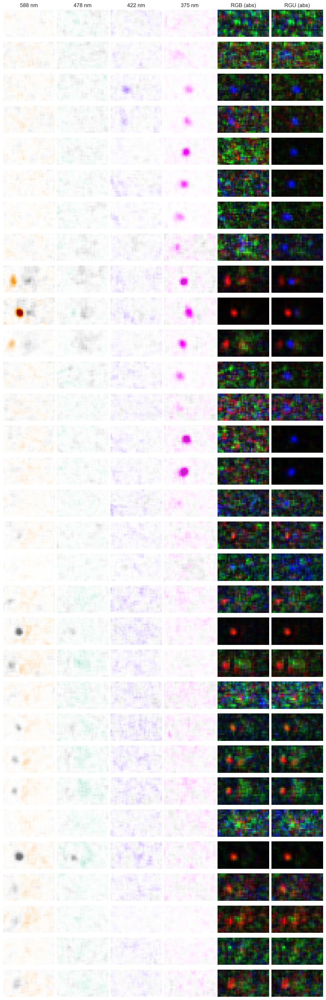

In [ ]:
plotting.chroma_overview(temp_load)

In [ ]:
"""
The way cell_id works is suboptimal, because cells from the same experiment date will get the same cell_id until you run out of roi numbers, 
only then will they no longer overlap.
"""

In [ ]:
chroma_df["cell_id"]

0       06-13-2023_STRF0_0
1       06-13-2023_STRF0_1
2       06-13-2023_STRF0_2
3       06-13-2023_STRF0_3
4       06-13-2023_STRF0_4
              ...         
476    11-08-2023_STRF0_26
477    11-08-2023_STRF0_27
478    11-08-2023_STRF0_28
479    11-08-2023_STRF0_29
480    11-08-2023_STRF0_30
Name: cell_id, Length: 481, dtype: object

In [ ]:
chroma_df

,date,path,filename,strf_keys,cell_id,size,ipl_depths,area_r,area_g,area_b,...,pos_cent_b,pos_cent_uv,neg_peak_r,neg_peak_g,neg_peak_b,neg_peak_uv,pos_peak_r,pos_peak_g,pos_peak_b,pos_peak_uv
0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_0,06-13-2023_STRF0_0,200,74.0,141.409,149.610,0.000,...,NaN,NaN,0.975,0.975,0.00,0.0,0.000,0.00,0.000,0.000
1,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_1,06-13-2023_STRF0_1,200,10.0,0.000,0.000,169.899,...,0.842077,0.900334,0.000,0.000,0.00,0.0,0.000,0.00,0.910,0.845
2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_2,06-13-2023_STRF0_2,200,48.0,0.000,0.000,164.498,...,0.804231,1.404772,0.000,0.000,0.00,0.0,0.000,0.00,0.845,0.975
3,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_3,06-13-2023_STRF0_3,200,67.0,194.347,175.206,0.000,...,NaN,NaN,0.975,0.975,0.00,0.0,0.000,0.00,0.000,0.000
4,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_4,06-13-2023_STRF0_4,200,90.0,111.198,122.016,122.506,...,NaN,NaN,1.040,1.105,1.04,0.0,0.000,0.00,0.000,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
476,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_26,11-08-2023_STRF0_26,200,79.0,139.361,187.257,97.607,...,0.929331,NaN,0.000,1.105,1.17,0.0,0.975,0.00,0.845,0.000
477,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_27,11-08-2023_STRF0_27,200,91.0,81.190,96.110,119.895,...,0.984105,NaN,1.040,1.040,0.00,0.0,0.000,0.00,0.910,0.000
478,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_28,11-08-2023_STRF0_28,200,92.0,88.190,93.136,111.828,...,0.882257,NaN,0.975,0.975,0.00,0.0,0.000,0.00,0.910,0.000
479,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_29,11-08-2023_STRF0_29,200,94.0,137.403,0.000,0.000,...,NaN,NaN,0.000,0.000,0.00,0.0,1.040,0.00,0.000,0.000


In [ ]:
plotting.ipl_summary_chroma(chroma_df)

NameError: name 'chroma_df' is not defined

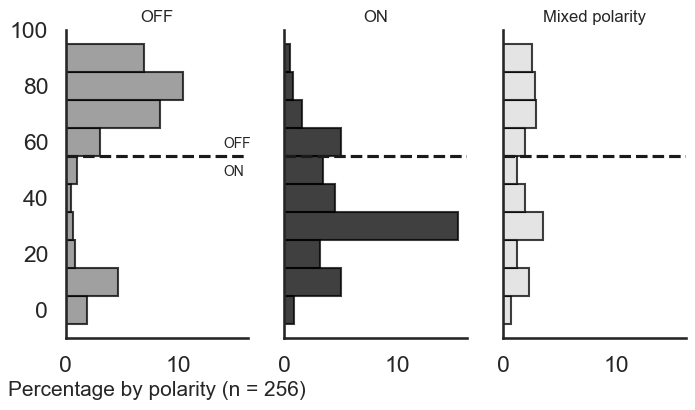

In [ ]:
plotting.ipl_summary_polarity(chroma_rois)

In [ ]:
roi_df.keys()

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'neg_contour_count', 'pos_contour_count',
       'total_contour_count', 'neg_contour_areas', 'pos_contour_areas',
       'neg_contour_area_total', 'pos_contour_area_total',
       'contour_area_total', 'contour_complexity', 'neg_extrema',
       'pos_extrema', 'polarities', 'neg_biphasic_index', 'pos_biphasic_index',
       'dom_biphasic_index', 'pols_corr', 'neg_auc', 'pos_auc', 'neg_peaktime',
       'pos_peaktime', 'dom_peaktime', 'neg_centroids', 'pos_centroids',
       'dom_centroids', 'cell_id'],
      dtype='object')

In [ ]:
chroma_rois

,ipl_depths,strf_keys,multicolour,roi,date,path,filename,colour,simultaneous,combo,...,pols_corr,neg_auc,pos_auc,neg_peaktime,pos_peaktime,dom_peaktime,neg_centroids,pos_centroids,dom_centroids,cell_id
0,74.0,STRF0_0_0,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,NaN,-36.363955,NaN,15,0,15,0.848789,NaN,0.848789,06-13-2023_STRF0_0
1,74.0,STRF0_0_1,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,G,n,NaN,...,NaN,-23.473498,NaN,15,0,15,0.803238,NaN,0.803238,06-13-2023_STRF0_0
6,10.0,STRF0_1_2,True,1,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,B,n,NaN,...,NaN,NaN,23.379190,0,14,14,NaN,0.842077,0.842077,06-13-2023_STRF0_1
10,48.0,STRF0_2_2,True,2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,B,n,NaN,...,NaN,NaN,20.253181,0,13,13,NaN,0.804231,0.804231,06-13-2023_STRF0_2
11,48.0,STRF0_2_3,True,2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,UV,n,NaN,...,NaN,NaN,16.107790,0,15,15,NaN,1.404772,1.404772,06-13-2023_STRF0_2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1916,94.0,STRF0_29_0,True,29,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,R,n,NaN,...,NaN,NaN,0.813489,0,16,16,NaN,2.223183,2.223183,11-08-2023_STRF0_29
1918,94.0,STRF0_29_2,True,29,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,B,n,NaN,...,-0.458647,-6.510574,4.535328,8,11,11,1.494549,2.253036,2.253036,11-08-2023_STRF0_29
1920,96.0,STRF0_30_0,True,30,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,R,n,NaN,...,NaN,NaN,10.042688,0,15,15,NaN,1.172736,1.172736,11-08-2023_STRF0_30
1921,96.0,STRF0_30_1,True,30,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,G,n,NaN,...,-0.300752,-22.195035,23.581150,16,16,16,1.209904,1.204083,1.204083,11-08-2023_STRF0_30


In [ ]:
load_file = filehandling.load_strf_by_df_index(chroma_rois, 1922, do_bootstrap=True)

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:523: UserWarning: Rotation detected and corrected for D:\Igor analyses\231108\2023-11-8_MP_0_0_ColourSWN_200_.h5
  loaded_data = load_strf_data(path, bootstrap_bool = do_bootstrap)


In [ ]:
load_file.space_bs_n

250

In [ ]:
"""
A better system would be to specify the metric and then auto-calc, but not sure how feasable
"""

In [ ]:
load_file.__annotations__

{'strfs': numpy.ndarray,
 'ipl_depths': numpy.ndarray,
 'strf_keys': numpy.ndarray,
 'multicolour': bool,
 'do_bootstrap': bool,
 'time_bs_n': int,
 'space_bs_n': int}

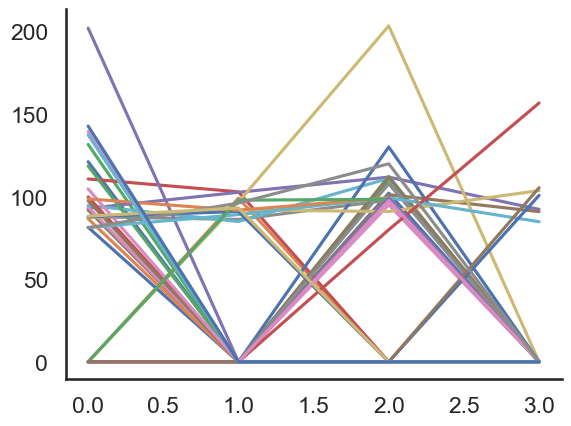

In [ ]:
plt.plot(load_file.area_tuning_functions(200).T)

In [ ]:
chroma_df.columns

Index(['date', 'path', 'filename', 'strf_keys', 'cell_id', 'size',
       'ipl_depths', 'chroma_label', 'chroma_label_simplified',
       'opponent_bool', 'non_opp_pol', 'avg_area', 'avg_centroids'],
      dtype='object')

In [ ]:
roi_df.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'neg_contour_count', 'pos_contour_count',
       'total_contour_count', 'neg_contour_areas', 'pos_contour_areas',
       'neg_contour_area_total', 'pos_contour_area_total',
       'contour_area_total', 'contour_complexity', 'neg_extrema',
       'pos_extrema', 'polarities', 'neg_biphasic_index', 'pos_biphasic_index',
       'dom_biphasic_index', 'pols_corr', 'neg_auc', 'pos_auc', 'neg_peaktime',
       'pos_peaktime', 'dom_peaktime', 'neg_centroids', 'pos_centroids',
       'dom_centroids', 'cell_id'],
      dtype='object')

In [ ]:
chroma_df

,date,path,filename,strf_keys,cell_id,size,ipl_depths,chroma_label,chroma_label_simplified,opponent_bool,non_opp_pol,avg_area,avg_centroids
0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_0,06-13-2023_STRF0_0,200,74.0,long,long,False,-1.0,145.509500,0.826014
1,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_1,06-13-2023_STRF0_1,200,10.0,blue,mid,False,1.0,169.899000,0.842077
2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_2,06-13-2023_STRF0_2,200,48.0,short,short,False,1.0,152.787500,1.104501
3,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_3,06-13-2023_STRF0_3,200,67.0,long,long,True,0.0,184.776500,1.195070
4,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_4,06-13-2023_STRF0_4,200,90.0,long,long,False,-1.0,118.573333,1.090463
...,...,...,...,...,...,...,...,...,...,...,...,...,...
476,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_26,11-08-2023_STRF0_26,200,79.0,blue,mid,True,0.0,118.484000,0.992894
477,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_27,11-08-2023_STRF0_27,200,91.0,mid_opp,mid_opp,True,0.0,100.542500,1.026860
478,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_28,11-08-2023_STRF0_28,200,92.0,long,long,False,-1.0,90.663000,0.754413
479,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_29,11-08-2023_STRF0_29,200,94.0,long,long,True,0.0,137.403000,2.238109


In [ ]:
roi_df

,ipl_depths,strf_keys,multicolour,roi,date,path,filename,colour,simultaneous,combo,...,pols_corr,neg_auc,pos_auc,neg_peaktime,pos_peaktime,dom_peaktime,neg_centroids,pos_centroids,dom_centroids,cell_id
0,74.0,STRF0_0_0,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,NaN,-36.363955,NaN,15,0,15,0.848789,NaN,0.848789,06-13-2023_STRF0_0
1,74.0,STRF0_0_1,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,G,n,NaN,...,NaN,-23.473498,NaN,15,0,15,0.803238,NaN,0.803238,06-13-2023_STRF0_0
2,74.0,STRF0_0_2,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,B,n,NaN,...,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,06-13-2023_STRF0_0
3,74.0,STRF0_0_3,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,UV,n,NaN,...,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,06-13-2023_STRF0_0
4,10.0,STRF0_1_0,True,1,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,06-13-2023_STRF0_1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1919,94.0,STRF0_29_3,True,29,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,UV,n,NaN,...,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,11-08-2023_STRF0_29
1920,96.0,STRF0_30_0,True,30,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,R,n,NaN,...,NaN,NaN,10.042688,0,15,15,NaN,1.172736,1.172736,11-08-2023_STRF0_30
1921,96.0,STRF0_30_1,True,30,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,G,n,NaN,...,-0.300752,-22.195035,23.581150,16,16,16,1.209904,1.204083,1.204083,11-08-2023_STRF0_30
1922,96.0,STRF0_30_2,True,30,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,B,n,NaN,...,-0.899248,4.071150,7.690642,15,14,14,1.755942,1.485056,1.485056,11-08-2023_STRF0_30


In [ ]:
d

In [ ]:
utilities.multicolour_reshape(load_file.contours, 4).shape

(4, 31, 2)

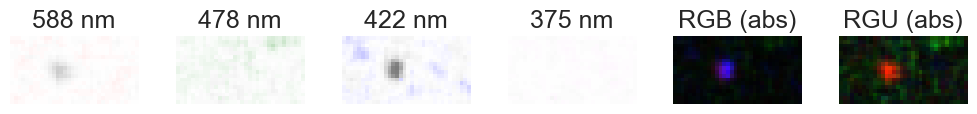

In [ ]:
plotting.chroma_overview(load_file, 0)

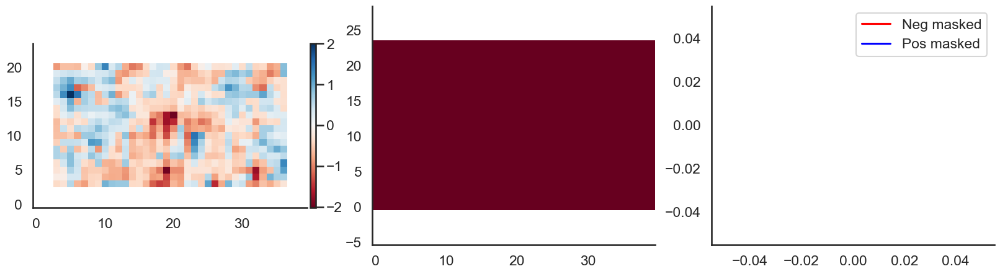

In [ ]:
plotting.contouring_demo(utilities.multicolour_reshape(load_file.strfs, 4)[3, 11])

In [ ]:
load_file.spectral_centroids()[1].data

array([       nan,        nan, 1.45089229, 1.32544884,        nan,
              nan, 0.84207662, 0.90033391,        nan,        nan,
       0.8042306 , 1.40477211,        nan,        nan, 1.57158264,
       1.56861613,        nan,        nan,        nan,        nan,
              nan,        nan,        nan, 1.27569528,        nan,
              nan, 0.87993312, 1.0982425 , 1.44365329, 1.72545847,
       1.47294044, 1.13637967,        nan,        nan, 2.03111487,
       1.4850098 , 1.81190187,        nan, 1.01315287, 2.32523815,
              nan,        nan, 2.06843103, 1.81393365,        nan,
              nan, 1.02710628, 2.25770086, 1.29911733, 1.30087395,
       1.15415398, 1.83773189,        nan,        nan, 1.09623585,
       1.42912377,        nan,        nan,        nan, 1.27427944,
              nan,        nan, 1.27652699, 1.65117036,        nan,
              nan, 3.96837488, 2.2564569 ,        nan,        nan,
       0.83404973, 1.46947603,        nan,        nan, 3.46060

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\utilities.py:133: UserWarning: Destructive method. You lose data, with no way of recovering original shape!
  warnings.warn("Destructive method. You lose data, with no way of recovering original shape!")
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:157: RuntimeWarning: Mean of empty slice
  return np.nanmean(self.contours_centres_by_pol, axis = 0)


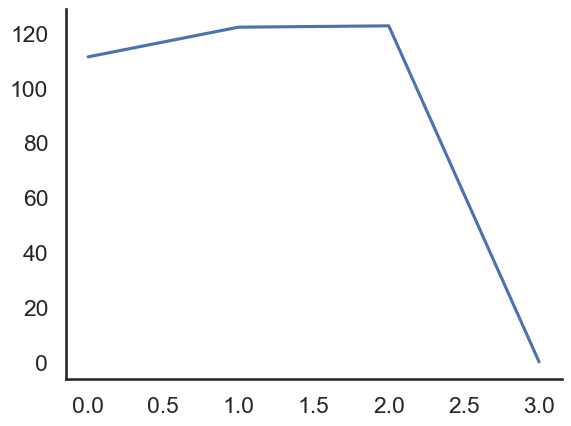

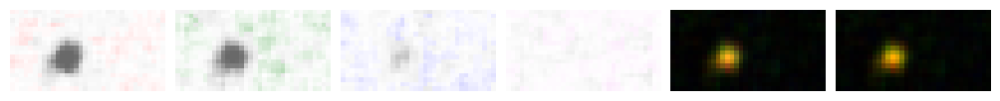

In [ ]:
1
roi = 4
plt.plot(area_by_colour[roi].T)
plotting.chroma_overview(load_file, roi)

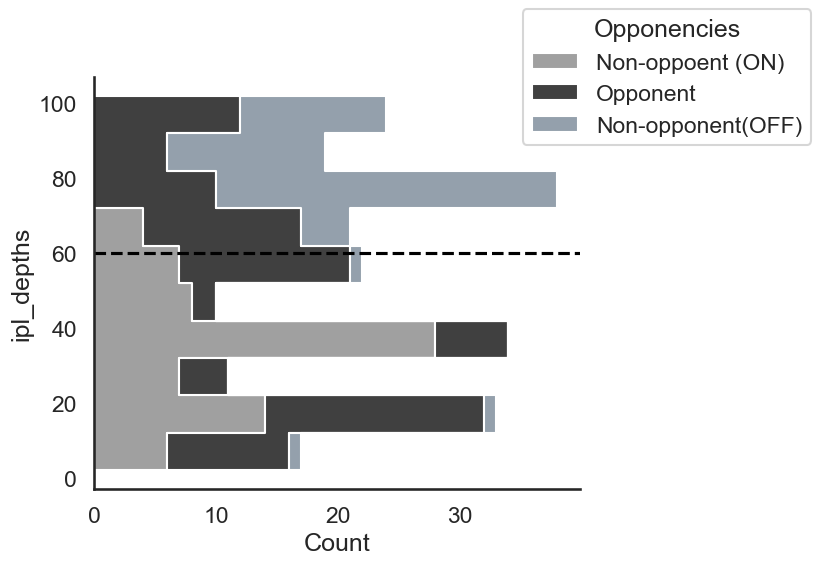

In [ ]:
fig, ax = plt.subplots(1, 1, figsize = (10, 6), sharex=True, sharey=True)
label_list = ["long_opp", "mid_opp", "short_opp"]
sns.histplot(data = chroma_df.query(f"non_opp_pol != 2"), y = "ipl_depths", element = "step", 
multiple = "stack", binwidth = 10, hue = "non_opp_pol", palette=["slategrey", "black", "grey"])
plt.legend(["Non-oppoent (ON)", "Opponent", "Non-opponent(OFF)"], title = "Opponencies")
sns.move_legend(ax, 'center right', bbox_to_anchor=(1.5, 1))
ax.axhline(60, c = "black", ls = "--")
plt.tight_layout()
# plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\chromatic_opponency_by_IPL_dist2.svg")

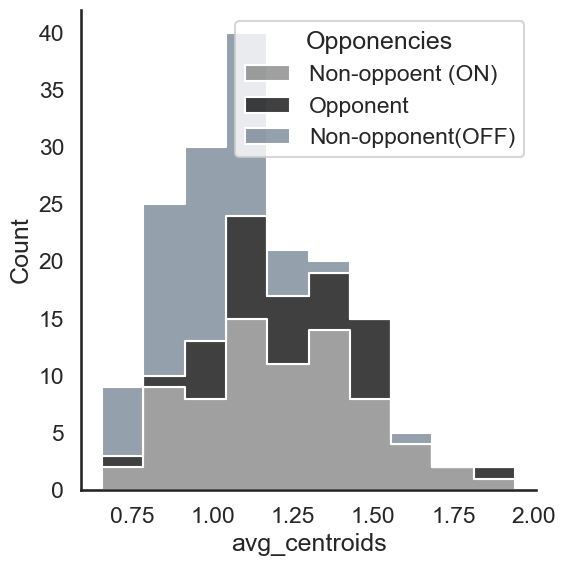

In [ ]:
fig, ax = plt.subplots(1, 1, figsize = (6, 6), sharex=True, sharey=True)
label_list = ["long_opp", "mid_opp", "short_opp"]
sns.histplot(data = chroma_df.query(f"non_opp_pol != 2"), x = "avg_centroids", element = "step", 
multiple = "stack", hue = "non_opp_pol", palette=["slategrey", "black", "grey"])
plt.legend(["Non-oppoent (ON)", "Opponent", "Non-opponent(OFF)"], title = "Opponencies")

plt.tight_layout()
# plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\chromatic_opponency_by_IPL_dist2.svg")

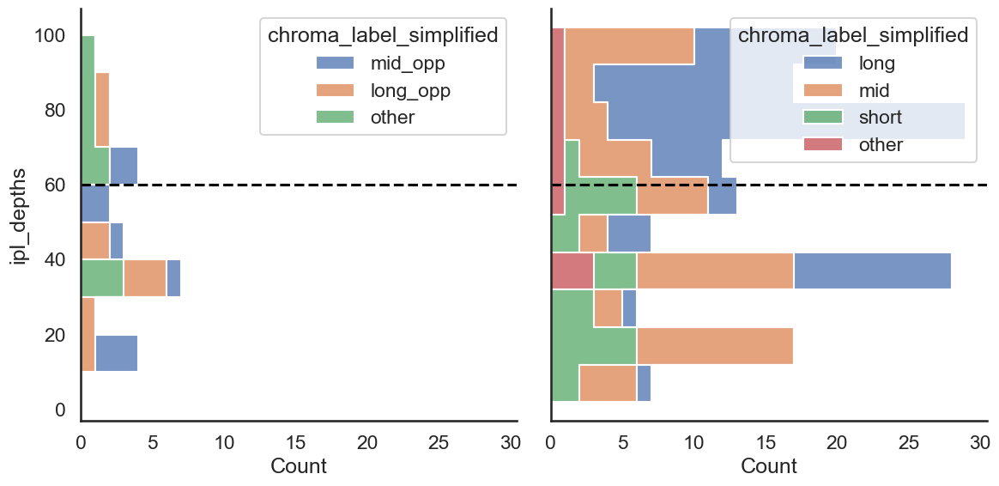

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (12, 6), sharex=True, sharey=True)

sns.histplot(data = chroma_df.query(f"chroma_label_simplified != 'non_resp' and chroma_label_simplified != 'long' and chroma_label_simplified != 'mid' and chroma_label_simplified != 'short'"), y = "ipl_depths", element = "step", 
multiple = "stack", binwidth = 10, hue = "chroma_label_simplified", ax = ax[0])
sns.histplot(data = chroma_df.query(f"chroma_label_simplified != 'non_resp' and chroma_label_simplified != 'long_opp' and chroma_label_simplified != 'mid_opp' and chroma_label_simplified != 'short_opp'"), y = "ipl_depths", element = "step", 
multiple = "stack", binwidth = 10, hue = "chroma_label_simplified", ax = ax[1])
# sns.move_legend(ax[0], 'center right', bbox_to_anchor=(1.5, 1))

for ax in ax:
    ax.axhline(60, c = "black", ls = "--")
plt.tight_layout()
#plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\chromatic_opponency_by_IPL_dist.svg")

In [ ]:
pd.unique(chroma_info["chroma_label"])

array(['long', 'blue', 'short', 'mid', 'mid_opp', 'long_opp', 'other',
       'short_opp', 'green', 'non_resp'], dtype=object)

In [ ]:
signal_analysis.

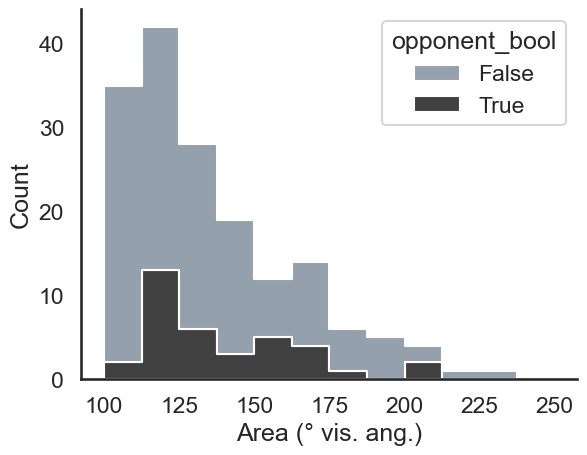

In [ ]:
sns.histplot(chroma_df, x = "avg_area", hue = "opponent_bool", multiple="stack", element = "step", binrange = (100, 250), palette=["slategray", "black"])
plt.xlabel("Area (° vis. ang.)")
plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Opponency plots\area_by_opponencybool.svg")


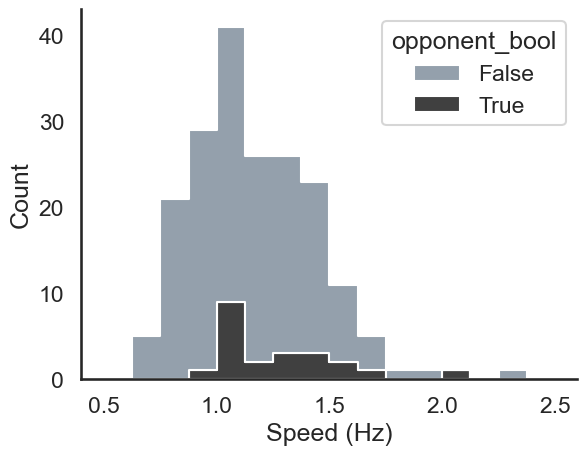

In [ ]:
sns.histplot(chroma_info, x = "avg_centroids", hue = "opponent_bool",  multiple="stack", element = "step", binrange=(.5, 2.5), palette=["slategray", "black"])
plt.xlabel("Speed (Hz)")
plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Opponency plots\speed_by_opponencybool.svg")

<Axes: xlabel='avg_area', ylabel='ipl_depths'>

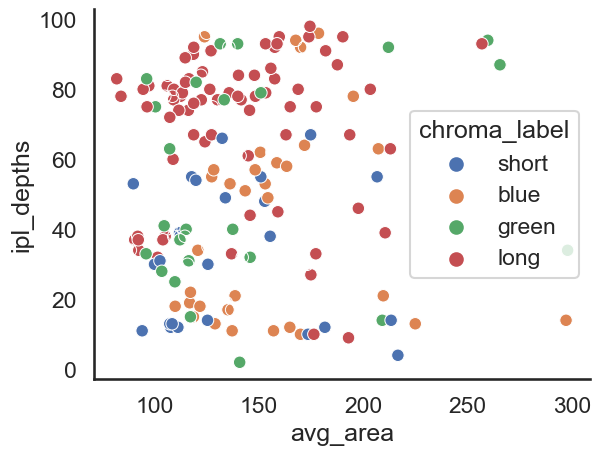

In [ ]:
sns.scatterplot(chroma_info, x = "avg_area", y = "ipl_depths", hue = "chroma_label", hue_order = ["short", "blue", "green", "long"])

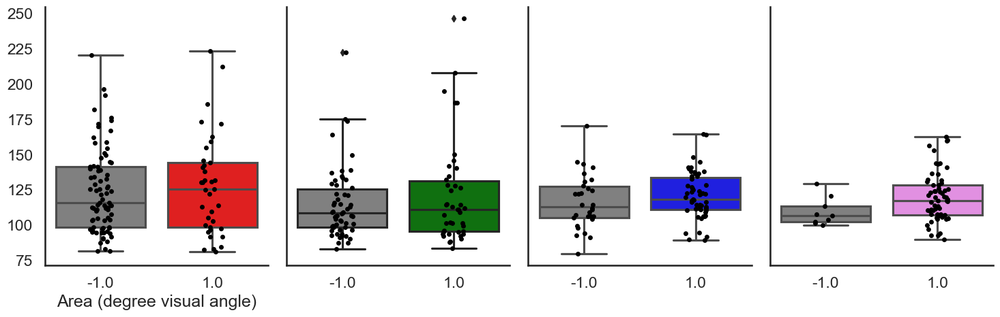

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.boxplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "contour_area_total", x = "polarities", ax = i, palette = ["grey", colours_name[n]], whis = 3)
    sns.stripplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "contour_area_total", x = "polarities", ax = i, color = "black")
    i.legend([], frameon = False)
    i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_xlabel("Area (degree visual angle)")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

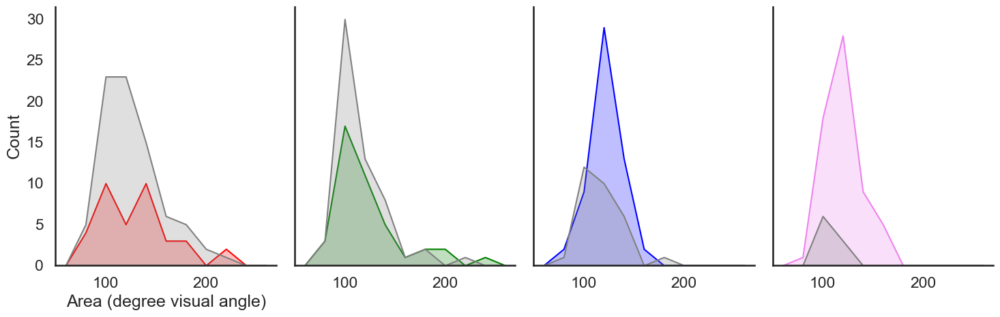

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True, sharex= True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    x = "contour_area_total", hue = "polarities", ax = i, palette = ["grey", colours_name[n]], element = "poly", binrange=(50, 255), binwidth=20)
    i.legend([], frameon = False)
    i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("Count")
ax[0].set_xlabel("Area (degree visual angle)")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

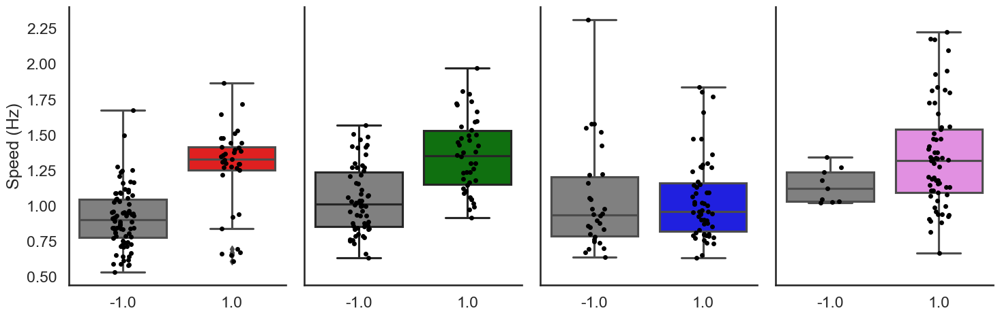

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.boxplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "dom_centroids", x = "polarities", ax = i, palette = ["grey", colours_name[n]], whis = 3)
    sns.stripplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "dom_centroids", x = "polarities", ax = i, color = "black")
    i.legend([], frameon = False)
    i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("Speed (Hz)")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

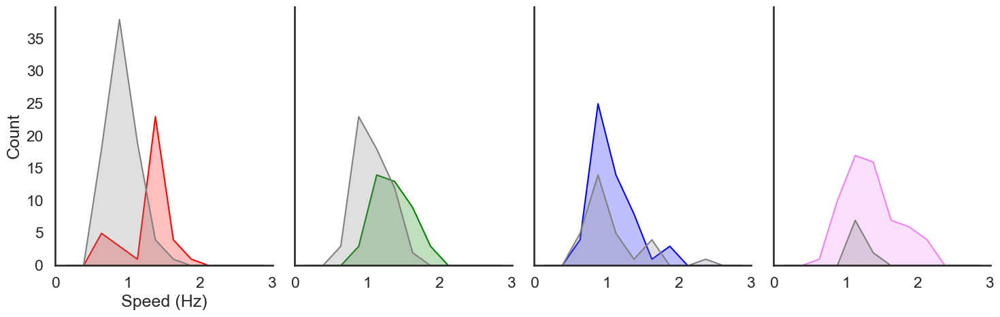

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    x = "dom_centroids", hue = "polarities", ax = i, palette = ["grey", colours_name[n]], element = "poly", binwidth=.25, binrange=(0, 3))
    i.legend([], frameon = False)
    i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("Count")
ax[0].set_xlabel("Speed (Hz)")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

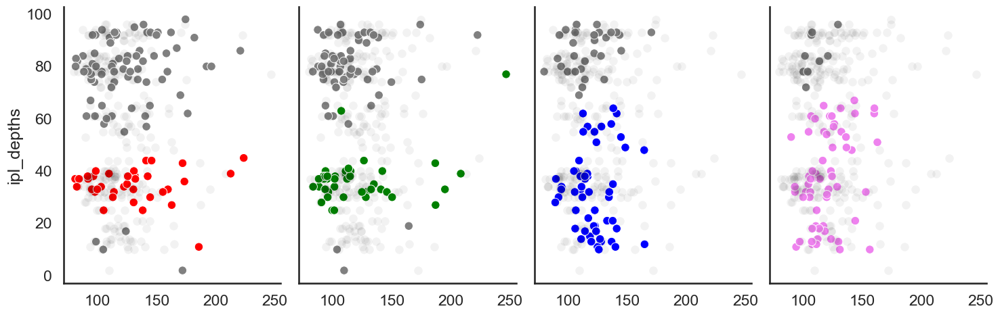

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True, sharex= True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.scatterplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "ipl_depths", x = "contour_area_total", hue = "polarities", ax = i, palette = ["grey", colours_name[n]])
    sns.scatterplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour != '{colours[n]}' & polarities != (2, 0)"),
    y = "ipl_depths", x = "contour_area_total", ax = i, color = "black", alpha = 0.05, linewidth = 0)
    i.legend([], frameon = False)
    # i.set_ylabel("")
    i.set_xlabel("")
# ax[0].set_ylabel("IPL depth")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

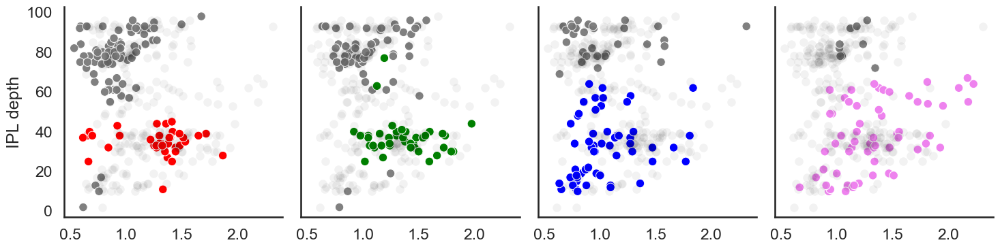

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 4), sharey = True, sharex = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.scatterplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "ipl_depths", x = "dom_centroids", hue = "polarities", ax = i, palette = ["grey", colours_name[n]])
    sns.scatterplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour != '{colours[n]}' & polarities != (2, 0)"),
    y = "ipl_depths", x = "dom_centroids", ax = i, color = "black", alpha = 0.05, linewidth = 0)
    i.legend([], frameon = False)
    # i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("IPL depth")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

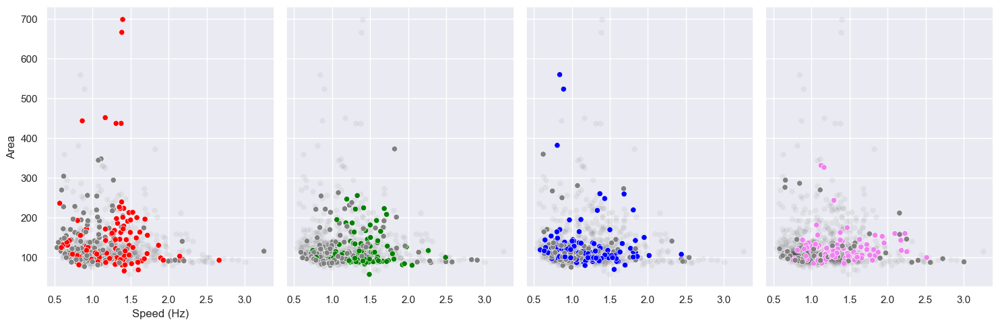

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True, sharex = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.scatterplot(data = chroma_rois_cleaned.query(f"colour != '{colours[n]}' & polarities != (2, 0)"),
    y = "contour_area_total", x = "dom_centroids", ax = i, color = "black", alpha = 0.05, linewidth = 0)
    sns.scatterplot(data = chroma_rois_cleaned.query(f"colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "contour_area_total", x = "dom_centroids", hue = "polarities", ax = i, palette = ["grey", colours_name[n]])
    i.legend([], frameon = False)
    # i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("Area")
ax[0].set_xlabel("Speed (Hz)")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_vs_speed.svg")

Text(0.5, 0, 'Area (° vis. ang.)')

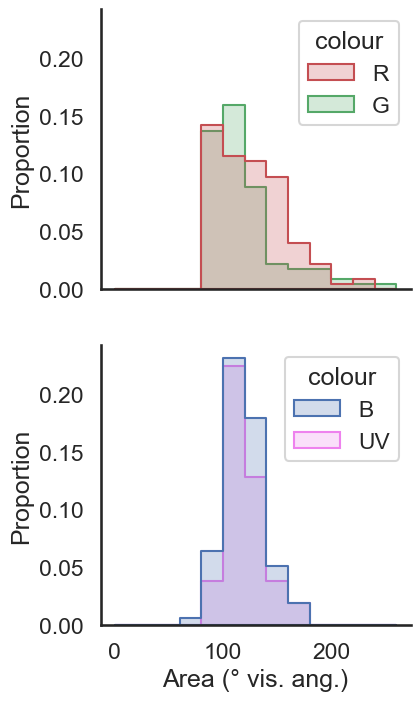

In [ ]:
fig, ax = plt.subplots(2, 1, sharex = True,  sharey = True, figsize = (4, 8))
colour_comp = [('R', 'G'), ('B', 'UV')]
comp_pallette = [["r", "g"], ["b","violet"]]
for n, i in enumerate(ax.flat):
    sns.histplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == {colour_comp[n]}"), ax = i,
    x = "contour_area_total", hue = "colour", palette = comp_pallette[n], element = "step", binrange = (0, 250), binwidth = 20, stat = "proportion")
    i.set_xlabel("")
ax[1].set_xlabel("Area (° vis. ang.)")
# fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\R_G_and_B_UV_area.svg")

Text(0.5, 0, 'Area (° vis. ang.)')

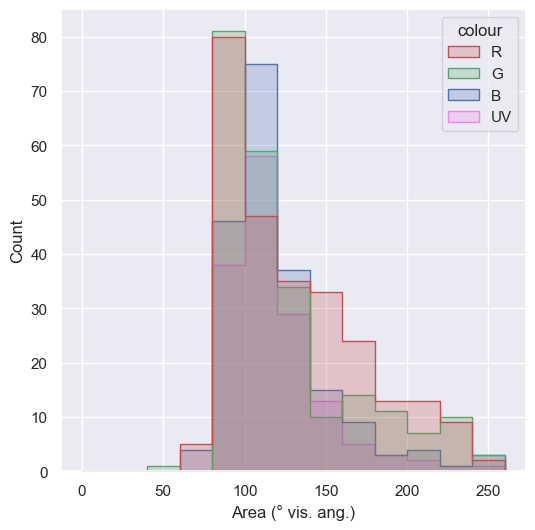

In [ ]:
fig, ax = plt.subplots(1, 1, sharex = True,  sharey = True, figsize = (6, 6))
sns.histplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == ('R', 'G', 'B', 'UV')"), ax = ax,
x = "contour_area_total", hue = "colour", palette = ["r", "g", "b","violet"], element = "step", binrange = (0, 250), binwidth = 20)
ax.set_xlabel("")
ax.set_xlabel("Area (° vis. ang.)")

Text(0.5, 0, 'Speed (Hz)')

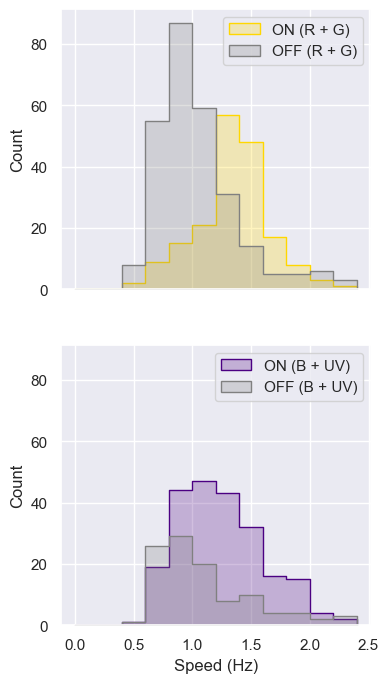

In [ ]:
fig, ax = plt.subplots(2, 1, sharex = True,  sharey = True, figsize = (4, 8))
colour_comp = [('R', 'G'), ('B', 'UV')]
label_list = ["R + G", "B + UV"]
comp_pallette = [["grey", "gold"], ["grey", "indigo"]]
for n, i in enumerate(ax.flat):
    sns.histplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & polarities != (2, 0) & colour == {colour_comp[n]}"), ax = i,
    x = "dom_centroids", hue = "polarities", palette = comp_pallette[n], element = "step", binwidth=.2, binrange=(0, 2.2))
    i.legend([f"ON ({label_list[n]})", f"OFF ({label_list[n]})"])
    i.set_xlabel("")
ax[1].set_xlabel("Speed (Hz)")
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\R+G_and_B+UV_speed.svg")

# Full search 

In [ ]:
files = filehandling.find_files_in(".h5", r"D:\Igor analyses", search_term = "25", recursive=True)
files

[WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5"),
 WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN0_BW_800_25%_v_1'.h5"),
 WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN0_R_400_25%_v_0'.h5"),
 WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN_BW_200_25%_h_0'.h5"),
 WindowsPath('D:/Igor analyses/220824/SMP_0_4_SWN_UV200_25p_0.h5'),
 WindowsPath('D:/Igor analyses/220825/SMP_0_0_SWN200_25p_R_0.h5'),
 WindowsPath('D:/Igor analyses/230502/2023-5-2_SMP_0_0_SWN_UV_25_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP_0_0_SWN200_25p_R_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP_0_0_SWN200_25p_UV_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP_0_10_SWN200_25p_R_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP_0_10_SWN200_25p_UV_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP_0_11_SWN200_25p_R_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP_0_11_SWN200_25p_UV_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP

In [ ]:
roi_df, rec_df = filehandling.compile_strf_df(files);
roi_df

Current file: D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:953: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5
  loaded = load_strf_data(i)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 17.664488949361154)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 14.527531515162059)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 8.788536920311916)
  contour_lower, contour_upper = _d

Current file: D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_800_25%_v_1'.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:953: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_800_25%_v_1'.h5
  loaded = load_strf_data(i)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 10.393928159846414)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 9.37322214792567)
  contour_lower, contour_upper = _draw_con

Current file: D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_R_400_25%_v_0'.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:953: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_R_400_25%_v_0'.h5
  loaded = load_strf_data(i)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 5.28830593329616)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)


Current file: D:\Igor analyses\220803\2022-8-3_'SMP_SWN_BW_200_25%_h_0'.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:953: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\220803\2022-8-3_'SMP_SWN_BW_200_25%_h_0'.h5
  loaded = load_strf_data(i)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 12.580901728812403)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 5.803336548273726)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 7.430669233169884)
  contour_lower, contour_upper = _dra

Current file: D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:953: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_0.h5
  loaded = load_strf_data(i)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\220825\SMP_0_0_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:953: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\220825\SMP_0_0_SWN200_25p_R_0.h5
  loaded = load_strf_data(i)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 5.73399255795554)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 2.2643428107048336)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Us

Current file: D:\Igor analyses\230502\2023-5-2_SMP_0_0_SWN_UV_25_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 4.151217116945835)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 4.382014946024355)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data

Current file: D:\Igor analyses\H5 exports\SMP_0_0_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 5.1727265972607555)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 2.6411831804442936)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 4.515769294596242)
  contour_lower, contour_upper =

Current file: D:\Igor analyses\H5 exports\SMP_0_0_SWN200_25p_UV_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\H5 exports\SMP_0_10_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\H5 exports\SMP_0_10_SWN200_25p_UV_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\H5 exports\SMP_0_11_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 2.5040888858287498)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 3.529170985372095)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, dat

Current file: D:\Igor analyses\H5 exports\SMP_0_11_SWN200_25p_UV_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 2.163937416789472)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(w

Current file: D:\Igor analyses\H5 exports\SMP_0_1_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 2.6221253644552136)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 3.692390431440299)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 3.344378582137904)
  contour_lower, contour_upper = 

Current file: D:\Igor analyses\H5 exports\SMP_0_1_SWN200_25p_UV_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\H5 exports\SMP_0_2_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 4.134377003257127)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 2.800086635908962)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data

Current file: D:\Igor analyses\H5 exports\SMP_0_6_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\H5 exports\SMP_0_6_SWN200_25p_UV_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 2.570966345919067)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(w

Current file: D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p_UV_0.h5
The following files are missing key 'Positions' resulting in np.nan for 'ipl_depths':
 
 [WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5")
 WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN0_BW_800_25%_v_1'.h5")
 WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN0_R_400_25%_v_0'.h5")
 WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN_BW_200_25%_h_0'.h5")
 WindowsPath('D:/Igor analyses/220824/SMP_0_4_SWN_UV200_25p_0.h5')
 WindowsPath('D:/Igor analyses/220825/SMP_0_0_SWN200_25p_R_0.h5')]


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


,ipl_depths,strf_keys,multicolour,roi,date,path,filename,colour,simultaneous,combo,...,dom_biphasic_index,pols_corr,neg_auc,pos_auc,neg_peaktime,pos_peaktime,dom_peaktime,neg_centroids,pos_centroids,dom_centroids
0,NaN,STRF0_0,False,0,2022-08-03,D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_...,2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5,BW,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
1,NaN,STRF0_1,False,1,2022-08-03,D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_...,2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5,BW,n,NaN,...,-0.805035,NaN,-17.718057,NaN,7,0,7,1.659654,NaN,1.659654
2,NaN,STRF0_2,False,2,2022-08-03,D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_...,2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5,BW,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
3,NaN,STRF0_3,False,3,2022-08-03,D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_...,2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5,BW,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
4,NaN,STRF0_4,False,4,2022-08-03,D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_...,2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5,BW,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
309,58.0,STRF0_17,False,17,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_UV_0.h5,UV,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
310,74.0,STRF0_18,False,18,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_UV_0.h5,UV,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
311,34.0,STRF0_19,False,19,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_UV_0.h5,UV,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
312,63.0,STRF0_20,False,20,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_UV_0.h5,UV,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN


In [ ]:
index = 311
test_load = filehandling.load_strf_by_df_index(roi_df, index)
roi = roi_df["roi"][index]
plotting.play_movie(test_load.strfs[roi])

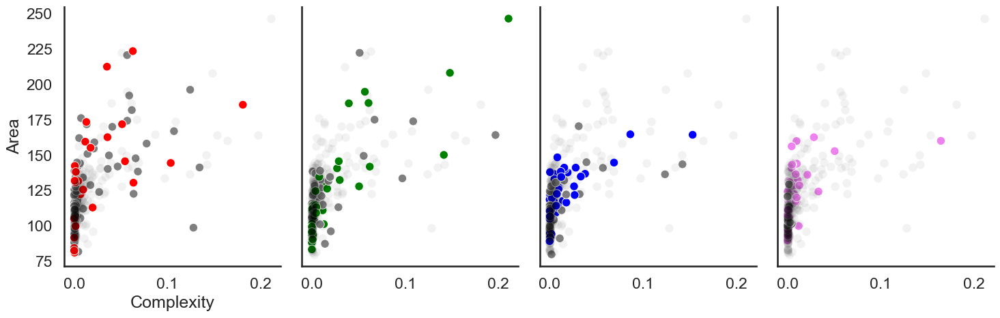

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True, sharex = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.scatterplot(data = chroma_rois_cleaned.query(f"colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "contour_area_total", x = "contour_complexity", hue = "polarities", ax = i, palette = ["grey", colours_name[n]])
    sns.scatterplot(data = chroma_rois_cleaned.query(f"colour != '{colours[n]}' & polarities != (2, 0)"),
    y = "contour_area_total", x = "contour_complexity", ax = i, color = "black", alpha = 0.05, linewidth = 0)
    i.legend([], frameon = False)
    # i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("Area")
ax[0].set_xlabel("Complexity")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

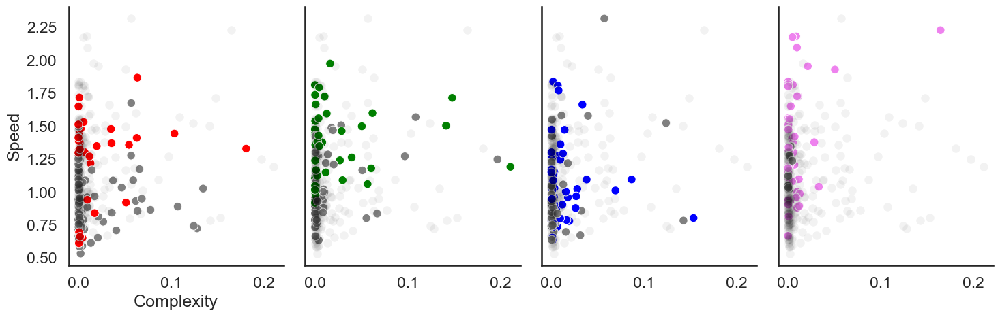

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True, sharex = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.scatterplot(data = chroma_rois_cleaned.query(f"colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "dom_centroids", x = "contour_complexity", hue = "polarities", ax = i, palette = ["grey", colours_name[n]])
    sns.scatterplot(data = chroma_rois_cleaned.query(f"colour != '{colours[n]}' & polarities != (2, 0)"),
    y = "dom_centroids", x = "contour_complexity", ax = i, color = "black", alpha = 0.05, linewidth = 0)
    i.legend([], frameon = False)
    # i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("Speed")
ax[0].set_xlabel("Complexity")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

In [ ]:
chroma_rois_cleaned.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'neg_extrema', 'pos_extrema',
       'neg_biphasic_index', 'pos_biphasic_index', 'pols_corr', 'neg_auc',
       'pos_auc', 'neg_peaktime', 'pos_peaktime', 'neg_contour_count',
       'pos_contour_count', 'total_contour_count', 'neg_contour_areas',
       'pos_contour_areas', 'neg_contour_area_total', 'pos_contour_area_total',
       'contour_area_total', 'contour_complexity', 'polarities',
       'neg_centroids', 'pos_centroids', 'dom_centroids', 'cell_id'],
      dtype='object')

In [ ]:

test_path = r"D:\Igor analyses\230613\0_1_ColorSWN_200_0\2023-6-13_0_1_ColourSWN_200_0.h5"
loadfile = filehandling.load_strf_data(test_path)

C:\Users\SimenLab\AppData\Local\Temp\ipykernel_24376\531283413.py:2: UserWarning: Rotation detected and corrected for D:\Igor analyses\230613\0_1_ColorSWN_200_0\2023-6-13_0_1_ColourSWN_200_0.h5
  loadfile = filehandling.load_strf_data(test_path)


In [ ]:
np.where(chroma_rois["neg_contour_area_total"] > chroma_rois["pos_contour_area_total"], chroma_rois["neg_centroids"],  chroma_rois["pos_centroids"])

array([0.84878931, 0.80323811,        nan, ...,        nan,        nan,
              nan])

In [ ]:
fig, ax = plt.subplots(1, 8, figsize = (15, 5), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.tile(["OFF", "ON"], 4)
colours = np.repeat(["R", "G", "B", "UV"], 2)
colours_name = ["grey", "red", "grey", "green", "grey", "blue", "grey", "violet"]

for n, i in enumerate(ax):
    sns.boxplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}'"),
    y = "contour_area_total", ax = i, color = colours_name[n], whis = 3, fliersize=0)
    sns.stripplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}'"),
    y = "contour_area_total", ax = i, color = "black", alpha = 0.5)
    i.legend([], frameon = False)
    i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_xlabel("Area (° vis. ang.)")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

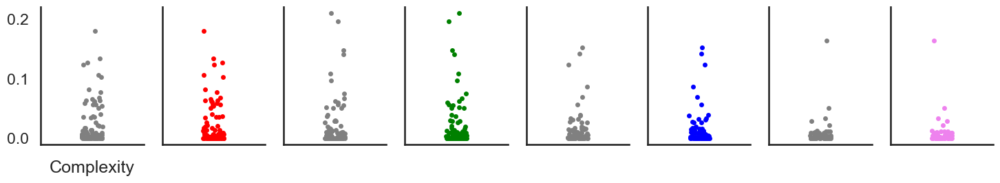

In [ ]:
fig, ax = plt.subplots(1, 8, figsize = (15, 3), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.tile(["OFF", "ON"], 4)
colours = np.repeat(["R", "G", "B", "UV"], 2)
colours_name = ["grey", "red", "grey", "green", "grey", "blue", "grey", "violet"]
for n, i in enumerate(ax):
    sns.stripplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}'"),
    y = "contour_complexity", ax = i, color = colours_name[n])
    i.legend([], frameon = False)
    # i.set_title(colours[n] + " " +titles[n])
    i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_xlabel("Complexity")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

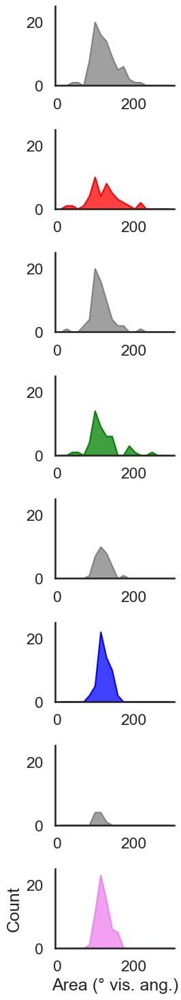

In [ ]:
fig, ax = plt.subplots(8, 1, figsize = (3, 15), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.tile(["OFF", "ON"], 4)
colours = np.repeat(["R", "G", "B", "UV"], 2)
colours_name = ["grey", "red", "grey", "green", "grey", "blue", "grey", "violet"]
y_axis = np.tile(["neg_contour_area_total", "pos_contour_area_total"], 4)
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois.query(f"total_contour_count > 0 & colour == '{colours[n]}'"), x = y_axis[n], element = "poly",
    ax = i, color = colours_name[n], multiple = "layer", binrange = (1, 300), binwidth = 15)
    i.legend([], frameon = False)
    # i.set_title(colours[n] + " " +titles[n])
    i.set_ylim(0, 25)
    if n != len(ax)-1:
        i.set_ylabel("")
        i.set_xlabel("")
ax[-1].set_xlabel("Area (° vis. ang.)")
fig.tight_layout()
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

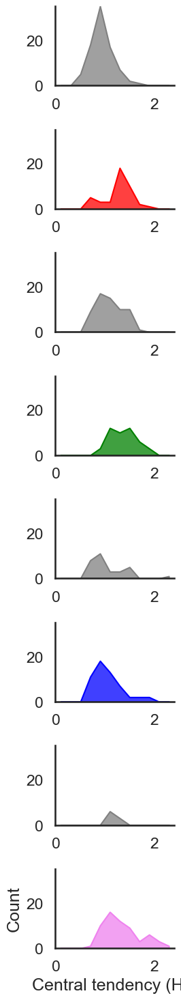

In [ ]:
fig, ax = plt.subplots(8, 1, figsize = (3, 15), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.tile(["OFF", "ON"], 4)
colours = np.repeat(["R", "G", "B", "UV"], 2)
colours_name = ["grey", "red", "grey", "green", "grey", "blue", "grey", "violet"]
y_axis = np.tile(["neg_centroids", "pos_centroids"], 4)
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois.query(f"total_contour_count > 0 & colour == '{colours[n]}'"), x = y_axis[n], element = "poly",
    ax = i, color = colours_name[n], multiple = "layer",  binrange = (0, 2.3), binwidth = .2)
    i.legend([], frameon = False)
    # i.set_title(colours[n] + " " +titles[n])
    i.set_ylim(0, 35)
    if n != len(ax)-1:
        i.set_ylabel("")
        i.set_xlabel("")
fig.tight_layout()
ax[-1].set_xlabel("Central tendency (Hz)")
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\centroids_distributions.svg")

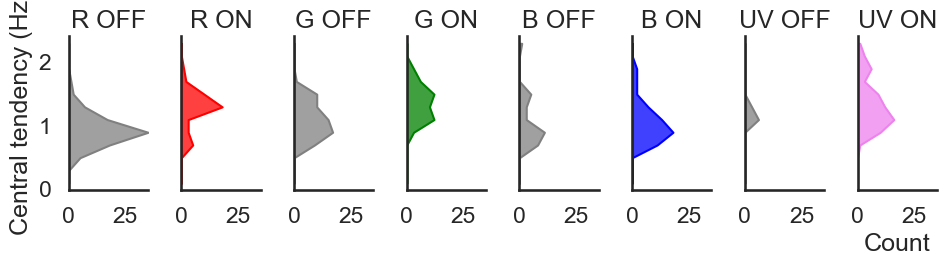

In [ ]:
fig, ax = plt.subplots(1, 8, figsize = (10, 3), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.tile(["OFF", "ON"], 4)
colours = np.repeat(["R", "G", "B", "UV"], 2)
# colours_name = ["darkred", "darkgreen", "darkblue", "darkviolet", "r", "g", "b", "violet"]
colours_name = ["grey", "red", "grey", "green", "grey", "blue", "grey", "violet"]
y_axis = np.tile(["neg_centroids", "pos_centroids"], 4)
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois.query(f"total_contour_count > 0 & colour == '{colours[n]}'"), y = y_axis[n], element = "poly",
    ax = i, color = colours_name[n], multiple = "layer", binrange = (0, 2.2), binwidth = .2)
    i.legend([], frameon = False)
    i.set_title(colours[n] + " " +titles[n])
    i.set_xlim(0, 35)
    if n != len(ax)-1:
        i.set_ylabel("")
        i.set_xlabel("")
ax[0].set_ylabel("Central tendency (Hz)")
fig.tight_layout()
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\centroids_distributions_alternative.svg")

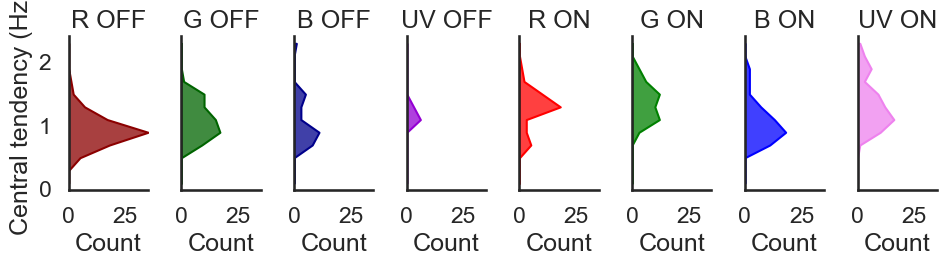

In [ ]:
fig, ax = plt.subplots(1, 8, figsize = (10, 3), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.repeat(["OFF", "ON"], 4)
colours = np.tile(["R", "G", "B", "UV"], 2)
colours_name = ["darkred", "darkgreen", "darkblue", "darkviolet", "red", "green", "blue", "violet"]
y_axis = np.repeat(["neg_centroids", "pos_centroids"], 4)
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois.query(f"total_contour_count > 0 & colour == '{colours[n]}'"), y = y_axis[n], element = "poly",
    ax = i, color = colours_name[n], multiple = "layer", binrange = (0, 2.2), binwidth = .2)
    i.legend([], frameon = False)
    i.set_title(colours[n] + " " +titles[n])
    i.set_xlim(0, 35)
ax[0].set_ylabel("Central tendency (Hz)")
fig.tight_layout()


In [ ]:
fig, ax = plt.subplots(1, 8, figsize = (10, 3), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.tile(["OFF", "ON"], 4)
colours = np.repeat(["R", "G", "B", "UV"], 2)
# colours_name = ["darkred", "darkgreen", "darkblue", "darkviolet", "r", "g", "b", "violet"]
colours_name = ["grey", "red", "grey", "green", "grey", "blue", "grey", "violet"]
y_axis = np.tile(["neg_centroids", "pos_centroids"], 4)
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois.query(f"total_contour_count > 0 & colour == '{colours[n]}'"), y = y_axis[n], element = "poly",
    ax = i, color = colours_name[n], multiple = "layer", binrange = (0, 2.2), binwidth = .2)
    i.legend([], frameon = False)
    i.set_title(colours[n] + " " +titles[n])
    i.set_xlim(0, 35)
ax[0].set_ylabel("Central tendency (Hz)")
fig.tight_layout()


In [ ]:
chroma_rois.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'polarities', 'neg_centroids',
       'pos_centroids', 'neg_extrema', 'pos_extrema', 'neg_biphasic_index',
       'pos_biphasic_index', 'pols_corr', 'neg_auc', 'pos_auc', 'neg_peaktime',
       'pos_peaktime', 'neg_contour_count', 'pos_contour_count',
       'total_contour_count', 'neg_contour_areas', 'pos_contour_areas',
       'neg_contour_area_total', 'pos_contour_area_total',
       'contour_area_total', 'contour_complexity'],
      dtype='object')

In [ ]:
pd.unique(chroma_rois["size"])

array([200], dtype=int64)

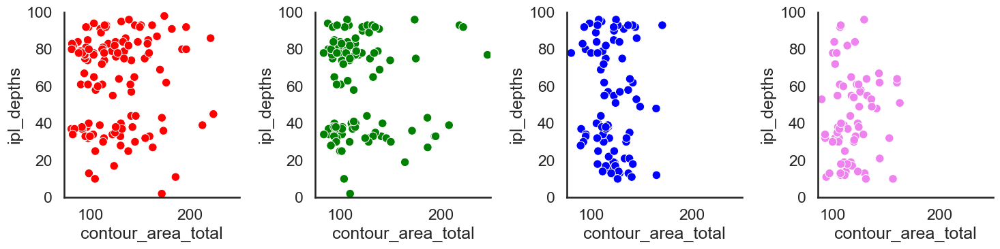

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 4))
colours = np.tile(["R", "G", "B", "UV"], 2)
x_axis = np.repeat(["contour_area_total"], 4)
for n, curr_ax in enumerate(ax.flat):
    sns.scatterplot(data = chroma_rois.query(f"contour_area_total > 0 & colour == '{colours[n]}'"), x = "contour_area_total", y = "ipl_depths", hue = "colour", 
    palette = chromatic_palette, hue_order=chromatic_hues, ax = curr_ax)
    curr_ax.set_xlim(right = 250)
    curr_ax.set_ylim(0, 100)
for ax in ax.flat:
    ax.legend([], [], frameon=False)
fig.tight_layout()

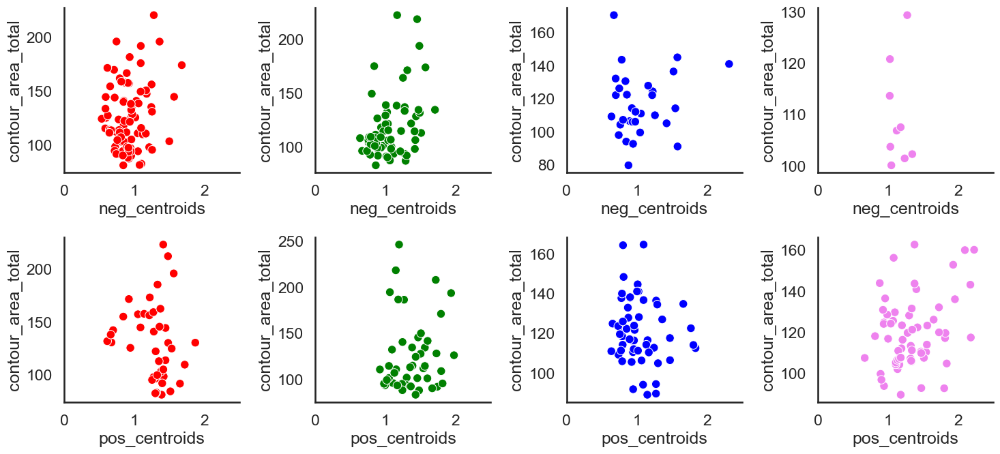

In [ ]:
fig, ax = plt.subplots(2, 4, figsize = (15, 7))
colours = np.tile(["R", "G", "B", "UV"], 2)
x_axis = np.repeat(["neg_centroids", "pos_centroids"], 4)
y_axis = np.repeat(["contour_area_total", "contour_area_total"], 4)
for n, curr_ax in enumerate(ax.flat):
    sns.scatterplot(data = chroma_rois.query(f"contour_area_total > 0 & colour == '{colours[n]}'"), y = y_axis[n], x = x_axis[n], hue = "colour", 
    palette = chromatic_palette, hue_order=chromatic_hues, ax = curr_ax)
    curr_ax.set_xlim(0, 2.5)
for ax in ax.flat:
    ax.legend([], [], frameon=False)
fig.tight_layout()

In [ ]:
chroma_rois.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'polarities', 'neg_centroids',
       'pos_centroids', 'neg_extrema', 'pos_extrema', 'neg_biphasic_index',
       'pos_biphasic_index', 'pols_corr', 'neg_auc', 'pos_auc', 'neg_peaktime',
       'pos_peaktime', 'neg_contour_count', 'pos_contour_count',
       'total_contour_count', 'neg_contour_areas', 'pos_contour_areas',
       'neg_contour_area_total', 'pos_contour_area_total',
       'contour_area_total', 'contour_complexity'],
      dtype='object')

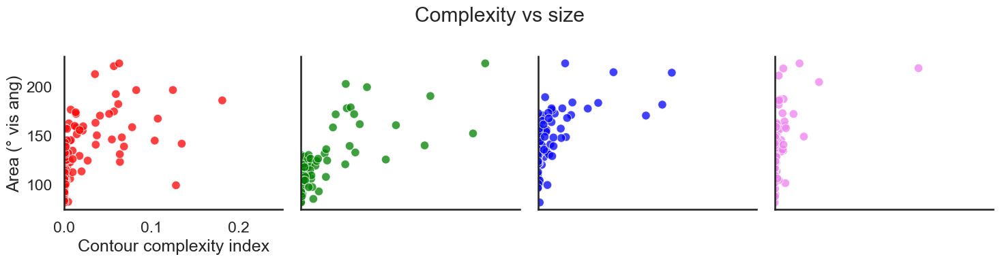

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 4))
colours = np.tile(["R", "G", "B", "UV"], 2)

for n, curr_ax in enumerate(ax.flat):
    # Reference datat from pop
    # sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "contour_area_total", x = "neg_centroids", ax = curr_ax, color = ["gainsboro"], alpha = .33, linewidth = 0)
    # sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "contour_area_total", x = "pos_centroids", ax = curr_ax, color = ["gainsboro"], alpha = .33, linewidth = 0)
    # Per colour and polarity
    sns.scatterplot(data = chroma_rois.query(f"contour_area_total > 0 & colour == '{colours[n]}'"), y = "contour_area_total", x = "contour_complexity", hue = "colour", 
    palette = chromatic_palette, hue_order=chromatic_hues, ax = curr_ax, alpha = 0.75)
    # sns.scatterplot(data = uv_strfs.query("contour_area_total > 0"), y = "contour_area_total", x = "pos_centroids", hue = "colour", 
    # palette = chromatic_palette, hue_order=chromatic_hues, ax = curr_ax.flat[0])
    curr_ax.set_xlim(0, 0.25)
    if n != 0:
        curr_ax.set_ylabel("")
        curr_ax.set_xlabel("")
        curr_ax.set_xticks([])
        curr_ax.set_yticks([])
for cax in ax.flat:
    cax.legend([], [], frameon=False)
fig.suptitle("Complexity vs size")
ax[0].set_xlabel("Contour complexity index")
ax[0].set_ylabel("Area (° vis ang)")
fig.tight_layout()
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\complexity_vs_size.svg")

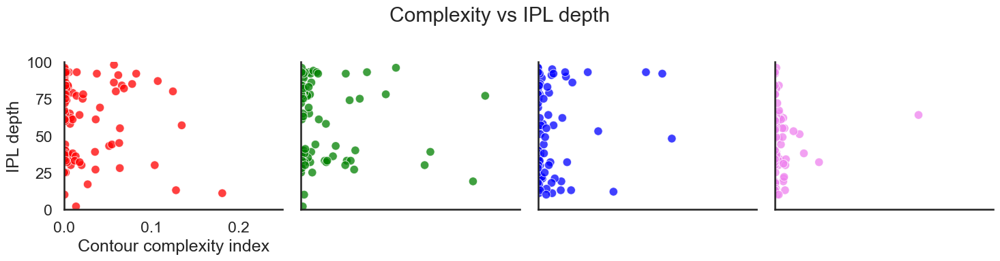

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 4))
colours = np.tile(["R", "G", "B", "UV"], 2)

for n, curr_ax in enumerate(ax.flat):
    # Reference datat from pop
    # sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "contour_area_total", x = "neg_centroids", ax = curr_ax, color = ["gainsboro"], alpha = .33, linewidth = 0)
    # sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "contour_area_total", x = "pos_centroids", ax = curr_ax, color = ["gainsboro"], alpha = .33, linewidth = 0)
    # Per colour and polarity
    sns.scatterplot(data = chroma_rois.query(f"contour_area_total > 0 & colour == '{colours[n]}'"), y = "ipl_depths", x = "contour_complexity", hue = "colour", 
    palette = chromatic_palette, hue_order=chromatic_hues, ax = curr_ax, alpha = 0.75)
    # sns.scatterplot(data = uv_strfs.query("contour_area_total > 0"), y = "contour_area_total", x = "pos_centroids", hue = "colour", 
    # palette = chromatic_palette, hue_order=chromatic_hues, ax = curr_ax.flat[0])
    curr_ax.set_ylim(bottom=0,top = 100)
    curr_ax.set_xlim(0, 0.25)
    if n != 0:
        curr_ax.set_ylabel("")
        curr_ax.set_xlabel("")
        curr_ax.set_xticks([])
        curr_ax.set_yticks([])
for cax in ax.flat:
    cax.legend([], [], frameon=False)
ax[0].set_xlabel("Contour complexity index")
ax[0].set_ylabel("IPL depth")
fig.suptitle("Complexity vs IPL depth")
fig.tight_layout()
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\IPL_vs_complexity.svg")


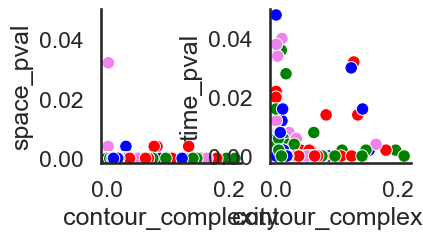

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (4, 2))
sns.scatterplot(data = chroma_rois.query(f"contour_area_total > 0"), y = "space_pval", x = "contour_complexity", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[0])
sns.scatterplot(data = chroma_rois.query(f"contour_area_total > 0"), y = "time_pval", x = "contour_complexity", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[1])
for n, i in enumerate(ax):
    i.legend([], [], frameon = False)
    i.set_ylim(top = 0.05)
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\complexity_vs_contour_complexity.svg")


In [ ]:
chroma_rois.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'polarities', '-centroids', '+centroids',
       '-extrema', '+extrema', '-biphasic_index', '+biphasic_index',
       'pols_corr', '-auc', '+auc', '-peaktime', '+peaktime', '-contour_count',
       '+contour_count', 'total_contour_count', '-contour_areas',
       '+contour_areas', '-contour_area_total', '+contour_area_total',
       'contour_area_total', 'contour_complexity'],
      dtype='object')

<Axes: xlabel='+centroids', ylabel='Count'>

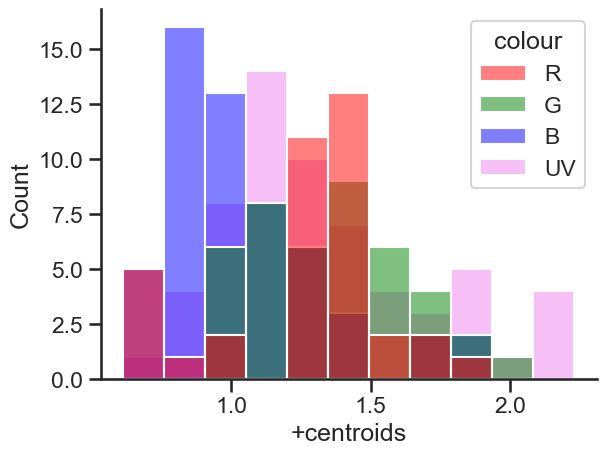

In [ ]:
#fig, ax = plt.subplots(1, 2, figsize = (10, 4))
sns.histplot(data = chroma_rois.query("contour_area_total > 0 & polarities == 1"), x = "+centroids", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues)


In [ ]:
chroma_rois.query("contour_area_total > 0")

,ipl_depths,strf_keys,multicolour,roi,date,path,filename,colour,simultaneous,combo,...,+peaktime,-contour_count,+contour_count,total_contour_count,-contour_areas,+contour_areas,-contour_area_total,+contour_area_total,contour_area_total,contour_complexity
0,74.0,STRF0_0_0,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,0,1,0,1,[565.6255160074506],[0.0],565.625516,0.000000,565.625516,0.002745
1,74.0,STRF0_0_1,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,G,n,NaN,...,0,1,0,1,[598.4346293480013],[0.0],598.434629,0.000000,598.434629,0.055559
10,48.0,STRF0_2_2,True,2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,B,n,NaN,...,13,0,1,1,[0.0],[657.9812586322907],0.000000,657.981259,657.981259,0.153254
11,48.0,STRF0_2_3,True,2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,UV,n,NaN,...,15,0,1,1,[0.0],[564.2987595392585],0.000000,564.298760,564.298760,0.004516
16,90.0,STRF0_4_0,True,4,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,0,1,0,1,[444.80072781089234],[0.0],444.800728,0.000000,444.800728,0.000880
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1005,92.0,STRF0_17_1,True,17,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,G,n,NaN,...,0,1,0,1,[538.4832269039246],[0.0],538.483227,0.000000,538.483227,0.019493
1006,92.0,STRF0_17_2,True,17,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,B,n,NaN,...,0,1,0,1,[488.87602743219406],[0.0],488.876027,0.000000,488.876027,0.017796
1013,30.0,STRF0_19_1,True,19,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,G,n,NaN,...,16,0,1,1,[0.0],[436.5928276263131],0.000000,436.592828,436.592828,0.004553
1017,83.0,STRF0_20_1,True,20,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,G,n,NaN,...,0,1,0,1,[404.54828580980546],[0.0],404.548286,0.000000,404.548286,0.008768


C:\Users\SimenLab\AppData\Local\Temp\ipykernel_24376\644499398.py:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "ipl_depths", x = "neg_centroids", ax = ax[0], palette = "Greys_r", alpha = .25)
C:\Users\SimenLab\AppData\Local\Temp\ipykernel_24376\644499398.py:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "ipl_depths", x = "pos_centroids", ax = ax[1], palette = "Greys_r", alpha = .25)


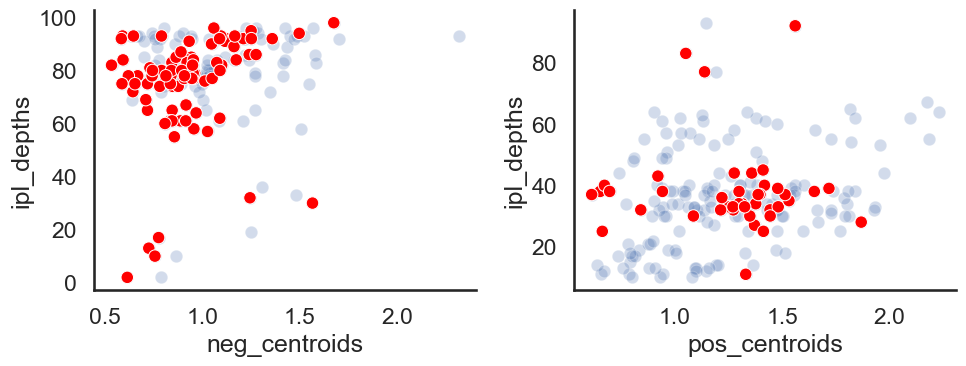

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (10, 4))
# reference
sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "ipl_depths", x = "neg_centroids", ax = ax[0], palette = "Greys_r", alpha = .25)
sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "ipl_depths", x = "pos_centroids", ax = ax[1], palette = "Greys_r", alpha = .25)


sns.scatterplot(data = r_strfs.query("contour_area_total > 0"), y = "ipl_depths", x = "neg_centroids", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[0])
sns.scatterplot(data = r_strfs.query("contour_area_total > 0"), y = "ipl_depths", x = "pos_centroids", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[1])

for ax in ax:
    ax.legend([], [], frameon=False)
    # ax.set_ylim(200, 1000)
    # ax.set_xlim(0, 2)
fig.tight_layout()

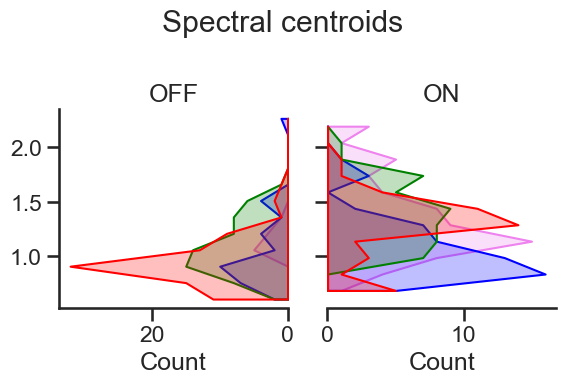

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (6, 4), sharey = True)

sns.histplot(data = chroma_rois.query("total_contour_count > 0"), y ="-centroids", hue = "colour", element = "poly",
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[0], binwidth = .15, multiple = "layer")
sns.histplot(data = chroma_rois.query("total_contour_count > 0"), y ="+centroids", hue = "colour", element = "poly",
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[1], binwidth = .15, multiple = "layer") #“layer”, “dodge”, “stack”, “fill”
titles = ["OFF", "ON"]
for n, i in enumerate(ax):
    i.legend([], frameon = False)
    i.set_title(titles[n])
ax[0].invert_xaxis()
ax[0].set_ylabel("")
#ax[1].yaxis.set_label_position("right")
ax[1].spines[['left']].set_visible(False)
plt.suptitle("Spectral centroids")
fig.tight_layout()
"""Seperate out into the different colour"""

In [ ]:
chroma_rois.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'polarities', '-centroids', '+centroids',
       '-extrema', '+extrema', '-biphasic_index', '+biphasic_index',
       'pols_corr', '-auc', '+auc', '-peaktime', '+peaktime', '-contour_count',
       '+contour_count', 'total_contour_count', '-contour_areas',
       '+contour_areas', '-contour_area_total', '+contour_area_total',
       'contour_area_total', 'contour_complexity'],
      dtype='object')

In [ ]:
chroma_rois.query("contour_area_total > 10 ")

,ipl_depths,strf_keys,multicolour,roi,date,path,filename,colour,simultaneous,combo,...,+peaktime,-contour_count,+contour_count,total_contour_count,-contour_areas,+contour_areas,-contour_area_total,+contour_area_total,contour_area_total,contour_complexity
0,74.0,STRF0_0_0,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,0,1,0,1,[565.6255160074506],[0.0],565.625516,0.000000,565.625516,0.002745
1,74.0,STRF0_0_1,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,G,n,NaN,...,0,1,0,1,[598.4346293480013],[0.0],598.434629,0.000000,598.434629,0.055559
10,48.0,STRF0_2_2,True,2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,B,n,NaN,...,13,0,1,1,[0.0],[657.9812586322907],0.000000,657.981259,657.981259,0.153254
11,48.0,STRF0_2_3,True,2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,UV,n,NaN,...,15,0,1,1,[0.0],[564.2987595392585],0.000000,564.298760,564.298760,0.004516
16,90.0,STRF0_4_0,True,4,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,0,1,0,1,[444.80072781089234],[0.0],444.800728,0.000000,444.800728,0.000880
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1005,92.0,STRF0_17_1,True,17,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,G,n,NaN,...,0,1,0,1,[538.4832269039246],[0.0],538.483227,0.000000,538.483227,0.019493
1006,92.0,STRF0_17_2,True,17,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,B,n,NaN,...,0,1,0,1,[488.87602743219406],[0.0],488.876027,0.000000,488.876027,0.017796
1013,30.0,STRF0_19_1,True,19,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,G,n,NaN,...,16,0,1,1,[0.0],[436.5928276263131],0.000000,436.592828,436.592828,0.004553
1017,83.0,STRF0_20_1,True,20,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,G,n,NaN,...,0,1,0,1,[404.54828580980546],[0.0],404.548286,0.000000,404.548286,0.008768


In [ ]:
temp = filehandling.load_strf_by_df_index(chroma_rois, 0)

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:944: UserWarning: Rotation detected and corrected for D:\Igor analyses\230613\0_0_ColorSWN_200_0\2023-6-13_0_0_ColourSWN_200_0.h5
  loaded_data = load_strf_data(path)


<Axes: xlabel='Count', ylabel='neg_contour_area_total'>

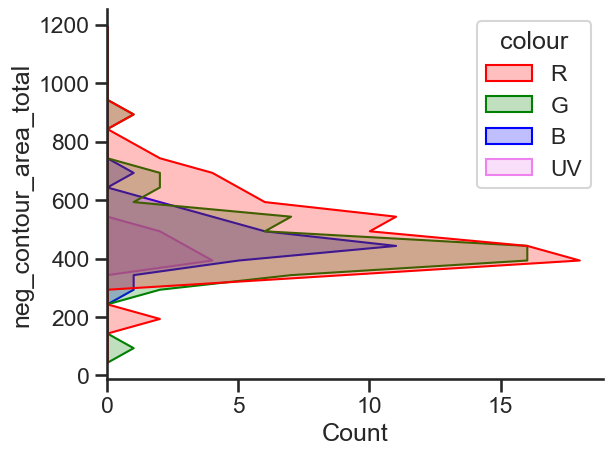

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (6, 12), sharey = True)

sns.histplot(data = chroma_rois.query("total_contour_count > 0"), y ="-contour_area_total", hue = "colour", element = "poly",
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[0], multiple = "layer", binrange = (20, 1200), binwidth = 25)
sns.histplot(data = chroma_rois.query("total_contour_count > 0"), y ="+contour_area_total", hue = "colour", element = "poly",
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[1], multiple = "layer", binrange = (20, 1200), binwidth = 25) #“layer”, “dodge”, “stack”, “fill”
titles = ["OFF", "ON"]
for n, i in enumerate(ax):
    i.legend([], frameon = False)
    i.set_title(titles[n])
ax[0].invert_xaxis()
ax[0].set_ylabel("")
#ax[1].yaxis.set_label_position("right")
ax[1].spines[['left']].set_visible(False)
plt.suptitle("Contour areas")
fig.tight_layout()


In [ ]:
chroma_rois.query("-contour_area_total > 0")["contour_area_total"].sort_values(ascending = False)

Series([], Name: contour_area_total, dtype: float64)

In [ ]:
test.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'polarities', '-centroids', '+centroids',
       '-extrema', '+extrema', '-biphasic_index', '+biphasic_index',
       'pols_corr', '-auc', '+auc', '-peaktime', '+peaktime', '-contour_count',
       '+contour_count', 'total_contour_count', '-contour_areas',
       '+contour_areas', '-contour_area_total', '+contour_area_total',
       'contour_area_total', 'contour_complexity'],
      dtype='object')

In [ ]:
test = chroma_rois.query("contour_area_total > 0")
chroma_rois.query("+contour_count' > 0")

UndefinedVariableError: name 'contour_count' is not defined

C:\Users\SimenLab\AppData\Local\Temp\ipykernel_20212\3056340204.py:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data = chroma_rois.query("-total_contour_count > 0"), y ="-biphasic_index", hue = "colour",


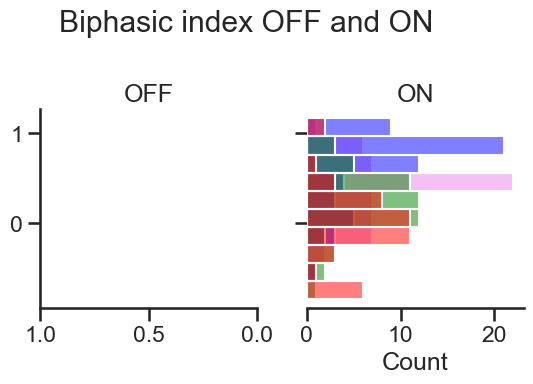

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (6, 4), sharey = True)
indeces = ["-biphasic_index","+biphasic_index", "polarities"]

sns.histplot(data = chroma_rois.query("-total_contour_count > 0"), y ="-biphasic_index", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[0], binwidth = .2, multiple = "layer")
sns.histplot(data = chroma_rois.query("+total_contour_count > 0"), y =indeces[1], hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[1], binwidth = .2, multiple = "layer")
titles = ["OFF", "ON"]
for n, i in enumerate(ax):
    i.legend([], frameon = False)
    i.set_title(titles[n])
ax[0].invert_xaxis()
ax[0].set_ylabel("")
#ax[1].yaxis.set_label_position("right")
ax[1].spines[['left']].set_visible(False)
plt.suptitle("Biphasic index OFF and ON ")
fig.tight_layout()


<Axes: xlabel='+centroids', ylabel='+biphasic_index'>

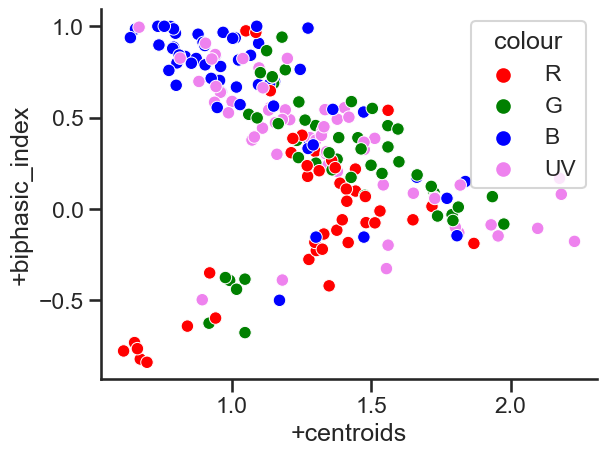

In [ ]:
sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "+biphasic_index", x = "+centroids", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues)

<Axes: xlabel='contour_area_total', ylabel='total_contour_count'>

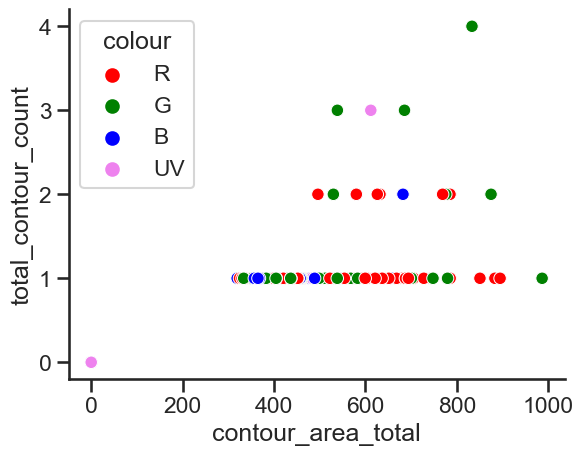

In [ ]:
sns.scatterplot(data = chroma_rois, y = "total_contour_count", x = "contour_area_total", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues)

In [ ]:
tempfile = filehandling.load_strf_data(r"D:\Igor analyses\230613\0_0_ColorSWN_200_0\2023-6-13_0_0_ColourSWN_200_0.h5")
tempdict = filehandling.build_results_dict(tempfile)

C:\Users\SimenLab\AppData\Local\Temp\ipykernel_15984\2770077536.py:1: UserWarning: Rotation detected and corrected for D:\Igor analyses\230613\0_0_ColorSWN_200_0\2023-6-13_0_0_ColourSWN_200_0.h5
  tempfile = filehandling.load_strf_data(r"D:\Igor analyses\230613\0_0_ColorSWN_200_0\2023-6-13_0_0_ColourSWN_200_0.h5")
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 5.560822148308134)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 3.6106830612499285)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold 

In [ ]:
# sizes_org = pd.unique(roi_df["size"].dropna())
# size_labels = np.round([au_to_visang(800), au_to_visang(400), au_to_visang(200), au_to_visang(100)], 2)
# size_labels = [np.round(unit_conversion.au_to_visang(x), 2) for x in sizes_org]
# size_order = [25, 50, 75, 100, 200, 400, 800]

In [ ]:
plotting.contouring

In [ ]:
roi_df.keys()

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'polarities', '-centroids', '+centroids', '-extrema', '+extrema',
       '-biphasic_index', '+biphasic_index', 'pols_corr', '-auc', '+auc',
       '-peaktime', '+peaktime', '-contour_count', '+contour_count',
       'total_contour_count', '-contour_areas', '+contour_areas',
       '-contour_area_total', '+contour_area_total', 'contour_area_total',
       '-areas_corrected', '+areas_corrected', '-areas_corrected_total',
       '+areas_corrected_total', 'area_total_corrected', 'notes'],
      dtype='object')

In [ ]:
rec_df

,multicolour,path,filename,colour,paired,combo,size,frequency,noise,rois_num,date,time,strfs_shape,ObjXYZ
0,True,D:\Igor analyses\230613\0_1_ColorSWN_200_0\202...,2023-6-13_Testimport_200.h5,RGBUV,NaN,NaN,200,NaN,NaN,76,2023-06-13,18:37:20,"(76, 20, 24, 40)","(-63692.0, -24556.0, -48354.0)"


In [ ]:
filehandling.load_strf_by_df_index(roi_df, 0).strfs[80]

IndexError: index 80 is out of bounds for axis 0 with size 76

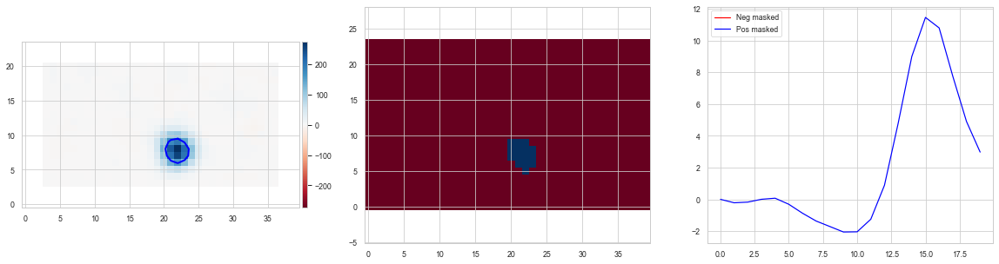

In [ ]:
plotting.contouring(filehandling.load_strf_by_df_index(roi_df, 0).strfs[17])

In [ ]:
# Querying 
# roi_df.query(f"polarities == -1")
# roi_df.query(f"`-peaktime` > 10").sort_values("-centroids")

#Sorting
roi_df.sort_values("total_contour_count")

# Filtering
# roi_df.filter(like='-', axis = 1)

# Complex
# roi_df.query("`-extrema` < -2 or `+extrema` > 2").sort_values("total_contour_count")
roi_df_noempties = roi_df.query("polarities.isnull() == False")
roi_chromatic = roi_df_noempties.query("colour == ['R', 'G', 'B', 'UV']")
roi_achromatic = roi_df_noempties.query("colour == ['BW', 'BWnoUV', 'BWB']") #BWB is a bug
# Account for BWB for now 
roi_achromatic = roi_achromatic.replace('BWB', 'BW')
roi_all_cleaned = roi_df_noempties.replace('BWB', 'BW')
#Soritng 
roi_chromatic.sort_values("contour_area_total");
# Other filters 
roi_chromatic_bignoise = roi_chromatic.query("size != (25, 50, 75)")

c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\pandas\core\missing.py:95: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  new_mask = arr == x


In [ ]:
roi_chromatic.query("time_pval < 0.05 & size == 200")

,ipl_depths,strf_keys,multicolour,roi,date,path,filename,colour,simultaneous,combo,...,+contour_areas_raw,-contour_area_total_raw,+contour_area_total_raw,contour_area_total_raw,-contour_areas,+contour_areas,-contour_area_total,+contour_area_total,contour_area_total,notes
81,NaN,STRF0_1,False,1,2022-08-24,D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_...,SMP_0_4_SWN_UV200_25p_0.h5,UV,n,NaN,...,"[6.97, 6.82, 7.09, 8.18, 4.94]",78.11,34.00,112.11,"[235.66792858736864, 324.718023740611, 398.251...","[156.73716242881292, 153.36405276391739, 159.4...",1756.490639,764.571524,2521.062164,
85,NaN,STRF0_5,False,5,2022-08-24,D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_...,SMP_0_4_SWN_UV200_25p_0.h5,UV,n,NaN,...,"[12.5, 5.87, 10.71, 7.83, 7.27]",95.04,44.18,139.22,"[88.15059924260353, 125.70455351177391, 1673.0...","[281.09247207462863, 132.0010248862456, 240.84...",2137.202284,993.493233,3130.695517,
86,NaN,STRF0_6,False,6,2022-08-24,D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_...,SMP_0_4_SWN_UV200_25p_0.h5,UV,n,NaN,...,"[11.34, 6.18, 8.62, 4.25, 6.69]",90.70,37.08,127.78,"[587.8205776024633, 241.7395259841806, 493.373...","[255.00709066610307, 138.9721181936964, 193.84...",2039.606977,833.832709,2873.439687,
88,NaN,STRF0_8,False,8,2022-08-24,D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_...,SMP_0_4_SWN_UV200_25p_0.h5,UV,n,NaN,...,"[9.48, 16.31, 5.81, 6.97, 5.19]",152.95,43.76,196.71,"[162.13413789264578, 118.73346020432314, 95.12...","[213.18053082139835, 366.7694575629754, 130.65...",3439.447488,984.048526,4423.496015,
89,NaN,STRF0_9,False,9,2022-08-24,D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_...,SMP_0_4_SWN_UV200_25p_0.h5,UV,n,NaN,...,"[10.09, 10.65, 82.9, 6.25, 6.6]",29.54,116.49,146.03,"[140.9959839926337, 116.25984645006639, 84.552...","[226.8978434586402, 239.4907862075836, 1864.20...",664.277730,2619.556966,3283.834696,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1437,92.0,STRF0_17,False,17,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_6_SWN200_25p...,SMP_0_6_SWN200_25p_UV_0.h5,UV,n,NaN,...,"[8.31, 11.2, 3.57, 8.54, 9.27]",95.93,40.89,136.82,"[262.42793192887325, 277.9442363873928, 1177.4...","[186.87027543521313, 251.8588549788672, 80.280...",2157.216068,919.509695,3076.725762,
1443,83.0,STRF0_4,False,4,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_R_0.h5,R,n,NaN,...,"[7.62, 4.22, 13.72, 11.48, 4.39]",111.38,41.43,152.81,"[80.50488400217364, 77.5815222925975, 443.4514...","[171.3539709766936, 94.89681857239462, 308.527...",2504.646363,931.652889,3436.299253,
1445,95.0,STRF0_6,False,6,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_R_0.h5,R,n,NaN,...,"[5.93, 4.31, 6.58, 2.72]",122.74,19.54,142.28,"[77.1317743372781, 93.9973226617558, 81.629253...","[133.35026875220382, 96.92068437133194, 147.96...",2760.103202,439.403752,3199.506954,
1448,84.0,STRF0_9,False,9,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_R_0.h5,R,n,NaN,...,[0],117.81,0.00,117.81,"[64.31395761067502, 513.8370389524212, 1707.69...",[0.0],2649.240331,0.000000,2649.240331,


<Axes: xlabel='area_total_corrected', ylabel='Count'>

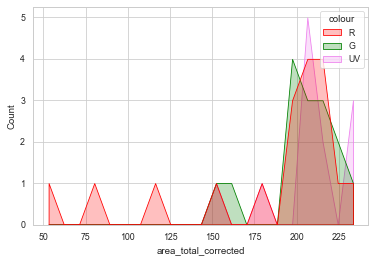

In [ ]:
sns.histplot(data = roi_df_noempties.query("size == 200"), x = "area_total_corrected", hue = 'colour', element = "poly", 
    multiple = "layer", palette=rgbuv_palette,  hue_order=["R", "G", "UV"])
# plt.legend(title='size', loc='upper right')
# plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\Life Sciences PhD Careers Symposium 2023\size_comparison_200.svg")

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:815: UserWarning: Rotation detected and corrected for D:\Igor analyses\230613\0_1_ColorSWN_200_0\2023-6-13_Testimport_200.h5
  return loaded_data
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:815: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\230613\0_1_ColorSWN_200_0\2023-6-13_Testimport_200.h5
  return loaded_data
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:439: UserWarning: Upper contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:439: UserWarning: Lower contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)


200 152.68943083093828


Text(0.5, 0.98, 'Example "W" kernel')

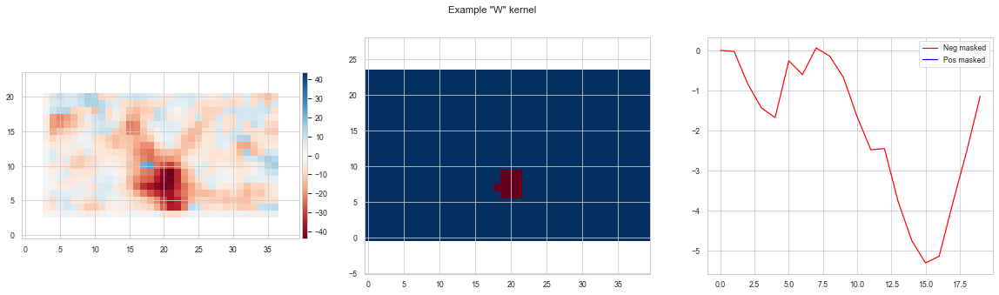

In [ ]:
df_search = roi_df_noempties.query("total_contour_count == 1 & size == 200").sort_values("area_total_corrected", ascending = True).reset_index()
index = 2
load = filehandling.load_strf_by_df_index(df_search, index)
roi = df_search["roi"][index]
plotting.contouring(load.strfs[roi])
print(df_search["size"][index], df_search["area_total_corrected"][index])
# plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\Life Sciences PhD Careers Symposium 2023\Smallest_RF.svg")
plt.suptitle('Example "W" kernel')

In [ ]:
df_search = roi_df_noempties.query("total_contour_count == 1 & size == 100").sort_values("-extrema", ascending = False).reset_index()
print(len(df_search))
# index = 4 # 4 # 9 # 11 # 18 for 200
index = 20
load = filehandling.load_strf_by_df_index(df_search, index)
print(load.strfs.shape)
plotting.play_movie(load.collapse_times())


102
(43, 20, 48, 76)


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:769: UserWarning: Rotation detected and corrected for D:\Igor analyses\230502\2023-5-2_SMP_0_0_SWN_UV_100_0.h5
  loaded_data = load_strf_data(path)


(62, 24, 40)
62


Text(0.5, 0.98, 'Min and max projection of RF rec with offsets (colour not controlled for)')

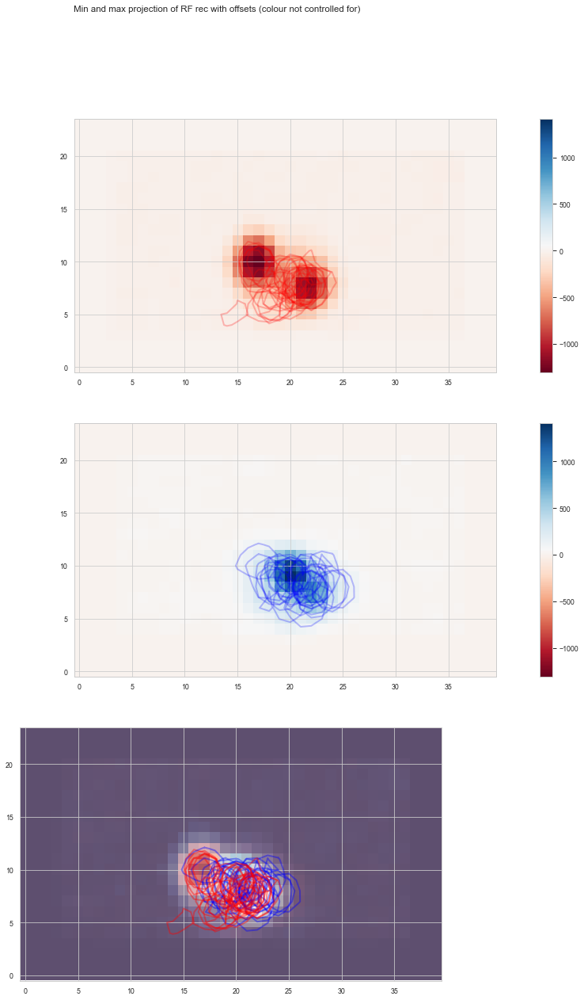

In [ ]:
# Kick out empty ish frames 
absolute_version = np.abs(load.collapse_times())
indeces_to_delete = np.unique(np.where(np.max(absolute_version, axis = (1,2)) < 45)[0]) # filtering criteria based on amplitudes
cleaned_version = np.delete(load.collapse_times(), indeces_to_delete, axis = 0)
print(cleaned_version.shape)
# Kick out contours accordingly 
contours = load.contours
cleaned_contours = list(np.delete(np.array(load.contours, dtype = "object"), indeces_to_delete, axis = 0))
print(len(cleaned_contours))

# Make projectsion 
min_projection = np.min(cleaned_version, axis = 0) 
max_projection = np.max(cleaned_version, axis = 0)
min_val = np.min(min_projection + 75)
max_val = np.max(max_projection - 75)

# create plot 
fig, ax = plt.subplots(3, 1, figsize = (20, 20))
cmap_modifier = 200
# Plot projections
minproj = ax[0].imshow(min_projection, cmap = 'RdBu', origin = "lower")
minproj.set_clim(min_val, max_val)
plt.colorbar(minproj, ax = ax[0])
# Plot the other projection
maxproj = ax[1].imshow(max_projection, cmap = 'RdBu', origin = "lower")
maxproj.set_clim(min_val, max_val)
plt.colorbar(maxproj, ax = ax[1])
# Plot their combination
combined2 = ax[2].imshow(min_projection, cmap = 'RdBu', alpha = 0.66, origin = "lower")
combined = ax[2].imshow(max_projection, cmap = 'RdBu', alpha = 0.33, origin = "lower")
# combined.set_clim(val_tup)
# combined2.set_clim(val_tup)

# Finally plot contours accordingly
for i in cleaned_contours:
    upper, lower = i
    if len(upper) != 0:
        for contour_up in upper:
            ax[0].plot(contour_up[:, 1], contour_up[:, 0], lw = 2, c = 'red', alpha = .25)# contour
            ax[2].plot(contour_up[:, 1], contour_up[:, 0], lw = 2, c = 'red', alpha = .4)# contour
    if len(lower) != 0:
        for contour_low in lower:
            ax[1].plot(contour_low[:, 1], contour_low[:, 0], lw = 2, c = 'blue', alpha = .25)# contour
            ax[2].plot(contour_low[:, 1], contour_low[:, 0], lw = 2, c = 'blue', alpha = .4)# contour
# ax[3].imshow(np.average(load.images, axis = 0), cmap = 'Greys_r', origin = "lower")
# plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\Life Sciences PhD Careers Symposium 2023\RF_tiling.svg")
plt.suptitle("Min and max projection of RF rec with offsets (colour not controlled for)")

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:769: UserWarning: Rotation detected and corrected for D:\Igor analyses\230201\2023-2-1_SMP_0_2_BWnoUV_100_5Hz_0.h5
  loaded_data = load_strf_data(path)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:438: UserWarning: Upper contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:438: UserWarning: Lower contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)


100 168.54304625594733


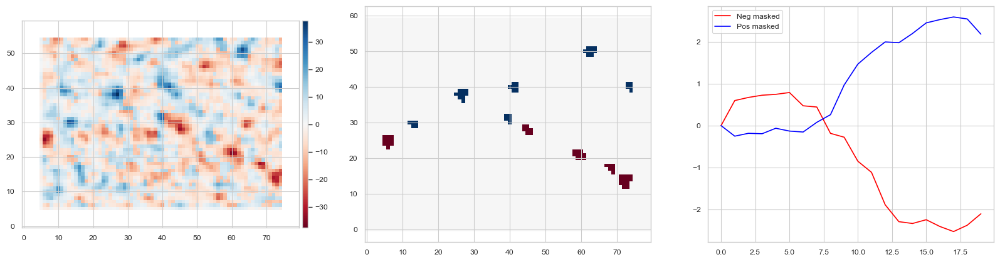

In [ ]:
df_search = roi_df_noempties.query("size == 100").sort_values("total_contour_count", ascending = False).reset_index()
index = 0
load = filehandling.load_strf_by_df_index(df_search, index)
roi = df_search["roi"][index]
plotting.contouring(load.strfs[roi])
print(df_search["size"][index], df_search["area_total_corrected"][index])
plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\Life Sciences PhD Careers Symposium 2023\Smallest_RF_100_variant.svg")

In [ ]:
plotting.play_movie(load.strfs[roi])

<Axes: xlabel='area_total_corrected', ylabel='Count'>

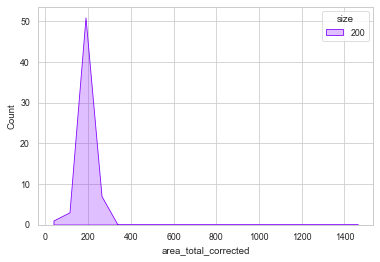

In [ ]:
sns.histplot(data = roi_df_noempties, x = "area_total_corrected", hue = 'size', element = "poly", 
    multiple = "layer", palette='rainbow',
    bins = 20,  binrange = (0, 1500))

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:769: UserWarning: Rotation detected and corrected for D:\Igor analyses\230201\2023-2-1_SMP_0_2_R_100_5Hz_0.h5
  loaded_data = load_strf_data(path)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:438: UserWarning: Lower contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)


100 nan 1.7370508101090316


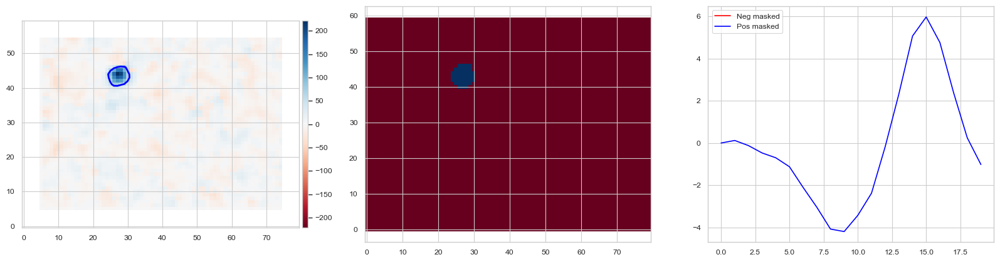

In [ ]:
# load =filehandling.load_strf_by_df_index(roi_df_noempties.query("total_contour_count > 0 & colour == 'UV'"), 88)
df_search = roi_df_noempties.query("total_contour_count == 1").sort_values("+centroids", ascending = False).reset_index()
index = 12
load = filehandling.load_strf_by_df_index(df_search, index)
roi = df_search["roi"][index]
plotting.contouring(load.strfs[roi])
print(df_search["size"][index], df_search["-centroids"][index], df_search["+centroids"][index])
plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\Life Sciences PhD Careers Symposium 2023\ON_timecourse_new.svg")

In [ ]:
plotting.play_movie(load.strfs[roi])

In [ ]:
plotting.play_movie(load.strfs[roi])

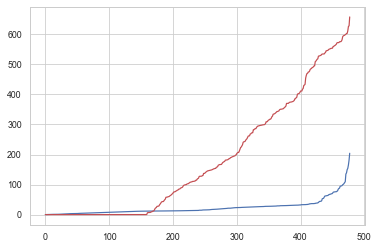

In [ ]:
one_sort = roi_df_noempties.sort_values("contour_area_total", ascending = True).reset_index(drop=True)
other_sort = roi_df_noempties.sort_values("area_total_corrected", ascending = True).reset_index(drop=True)
plt.plot(one_sort["contour_area_total"])
plt.plot(other_sort["area_total_corrected"], c = 'r')

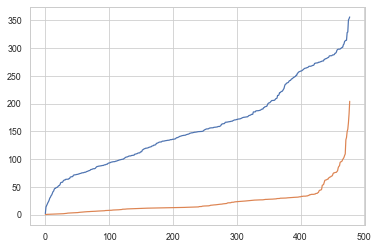

In [ ]:
new_sort = roi_df_noempties.sort_values("contour_area_total", ascending = True).reset_index(drop=True)

raw_areas = np.array(new_sort["contour_area_total"])
sizes = np.array(new_sort["size"])
new_areas = []
for area, size in zip(raw_areas, sizes):
    new_area = (unit_conversion.au_to_visang(size)**2 * area) / 4
    new_area = unit_conversion.area_conversion(area, size, 4)
    new_areas.append(new_area)
new_areas = np.array(new_areas)
plt.plot(np.sort(new_areas))
plt.plot(raw_areas)



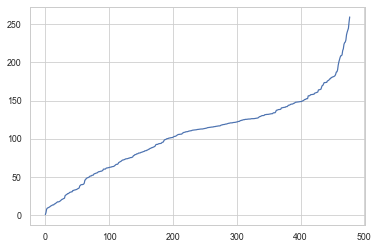

In [ ]:
plt.plot(new_sort["contour_area_total"])

In [ ]:
def numpy_fillna(data):
    if isinstance(data, np.ndarray) is False:
        data = np.array(data, dtype = object)
    # Get lengths of each row of data
    lens = np.array([len(i) for i in data])
    # Mask of valid places in each row
    mask = np.arange(lens.max()) < lens[:,None]
    # Setup output array and put elements from data into masked positions
    out = np.zeros(mask.shape, dtype=data.dtype)
    out[mask] = np.concatenate(data)
    return out

<Axes: xlabel='+centroids', ylabel='ipl_depths'>

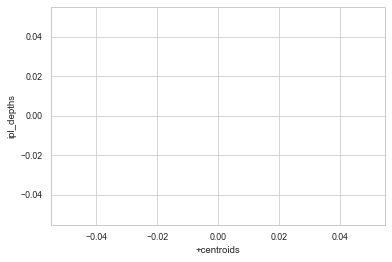

In [ ]:
sns.regplot(data = roi_chromatic.query("colour == 'R'"), x = "+centroids", y = "ipl_depths", color = 'r')
sns.regplot(data = roi_chromatic.query("colour == 'G'"), x = "+centroids", y = "ipl_depths", color = 'g')
sns.regplot(data = roi_chromatic.query("colour == 'UV'"), x = "+centroids", y = "ipl_depths", color = 'violet')

Text(0.5, 1.0, 'Centroids, ON responses')

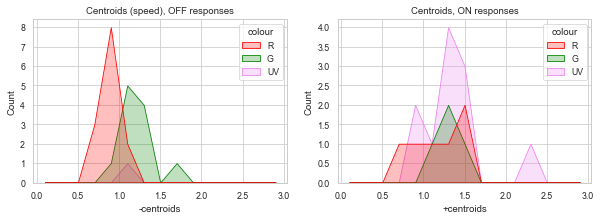

In [ ]:
df = roi_chromatic.query("total_contour_count  <= 2")
bins = 15
fig, ax = plt.subplots(1, 2, figsize = (10, 3))
sns.histplot(data = df, x = "-centroids", hue = 'colour', hue_order=["R", "G", "UV"],
    element="poly",  palette=rgbuv_palette, bins = bins, binrange=(0, 3), ax = ax[0])
ax[0].set_title("Centroids (speed), OFF responses")

sns.histplot(data = df, x = "+centroids", hue = 'colour', hue_order=["R", "G", "UV"],
    element = "poly",  palette=rgbuv_palette, bins = bins, binrange=(0, 3), ax = ax[1])
ax[1].set_title("Centroids, ON responses")

c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\seaborn\algorithms.py:98: RuntimeWarning: Mean of empty slice
  boot_dist.append(f(*sample, **func_kwargs))
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\numpy\lib\nanfunctions.py:1556: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,


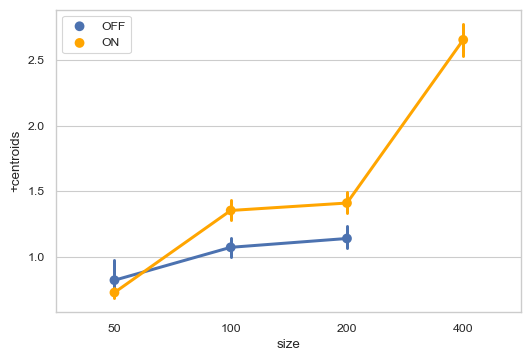

In [ ]:
query_df = df.query("total_contour_count < 10")
sns.pointplot(data = query_df, x ="size", y ="-centroids", label ="OFF")
sns.pointplot(data = query_df, x ="size", y ="+centroids", label ="ON", color = "orange")
plt.legend()

Text(0.5, 0, 'Polarity')

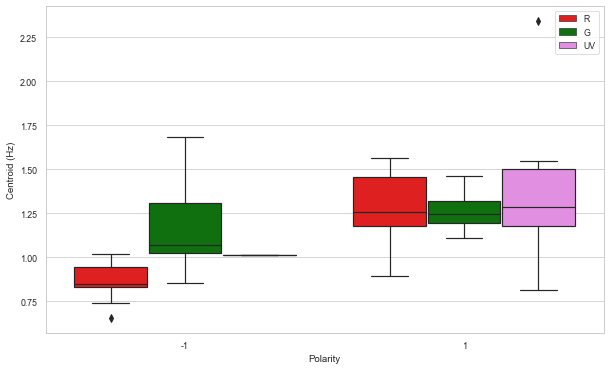

In [ ]:
fig, ax = plt.subplots(figsize = (10, 6))
query = roi_df
sns.boxplot(data = query, y = "-centroids", x = "polarities", hue = "colour", 
    order = [-1, 1], hue_order=("R", "G", "UV"), palette= rgbuv_palette, ax = ax)
handles, labels = ax.get_legend_handles_labels()
sns.boxplot(data = query, y = "+centroids", x = "polarities", hue = "colour", 
    order = [-1, 1], hue_order=("R", "G", "UV"), palette= rgbuv_palette, ax = ax)
plt.legend(handles, labels)
plt.ylabel("Centroid (Hz)")
plt.xlabel("Polarity")


Text(0.5, 0, 'Polarity')

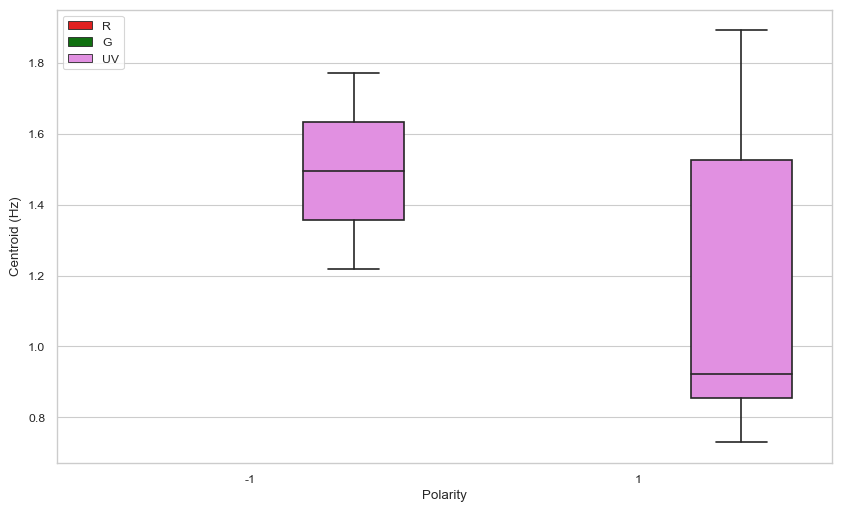

In [ ]:
fig, ax = plt.subplots(figsize = (10, 6))
query = roi_df.query("colour == 'UV' & size == 200")
sns.boxplot(data = query, y = "-centroids", x = "polarities", hue = "colour", 
    order = [-1, 1], hue_order=("R", "G", "UV"), palette= rgbuv_palette, ax = ax)
handles, labels = ax.get_legend_handles_labels()
sns.boxplot(data = query, y = "+centroids", x = "polarities", hue = "colour", 
    order = [-1, 1], hue_order=("R", "G", "UV"), palette= rgbuv_palette, ax = ax)
plt.legend(handles, labels)
plt.ylabel("Centroid (Hz)")
plt.xlabel("Polarity")

Text(0.5, 0, 'Polarity')

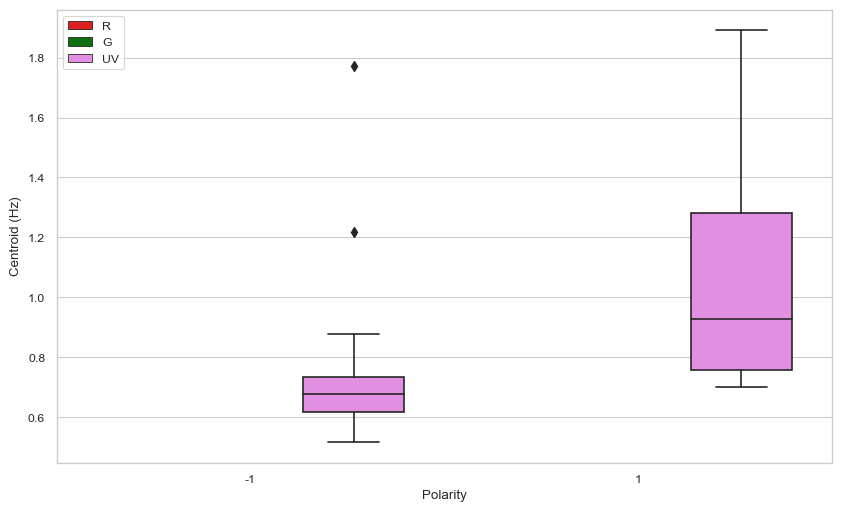

In [ ]:
fig, ax = plt.subplots(figsize = (10, 6))
query = roi_df.query("colour == 'UV' & size == [100, 200]")
sns.boxplot(data = query, y = "-centroids", x = "polarities", hue = "colour", 
    order = [-1, 1], hue_order=("R", "G", "UV"), palette= rgbuv_palette, ax = ax)
handles, labels = ax.get_legend_handles_labels()
sns.boxplot(data = query, y = "+centroids", x = "polarities", hue = "colour", 
    order = [-1, 1], hue_order=("R", "G", "UV"), palette= rgbuv_palette, ax = ax)
plt.legend(handles, labels)
plt.ylabel("Centroid (Hz)")
plt.xlabel("Polarity")

<Axes: xlabel='polarities', ylabel='+centroids'>

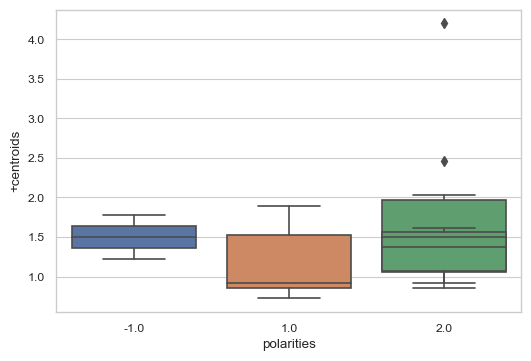

In [ ]:
sns.boxplot(query.query("size == 200 & contour_area_total > 0"), y = "-centroids", x = "polarities")
sns.boxplot(query.query("size == 200 & contour_area_total > 0"), y = "+centroids", x = "polarities")

<Axes: xlabel='polarities', ylabel='+centroids'>

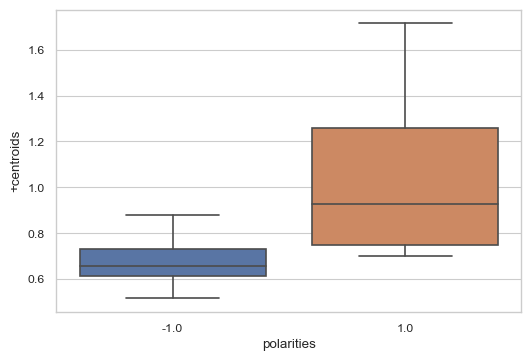

In [ ]:
sns.boxplot(query.query("size == 100 & contour_area_total > 0"), y = "-centroids", x = "polarities")
sns.boxplot(query.query("size == 100 & contour_area_total > 0"), y = "+centroids", x = "polarities")

<Axes: xlabel='polarities', ylabel='+centroids'>

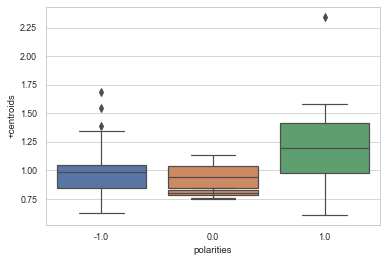

In [ ]:
sns.boxplot(query.query("contour_area_total > 0"), y = "-centroids", x = "polarities")
sns.boxplot(query.query("contour_area_total > 0"), y = "+centroids", x = "polarities")

<Axes: xlabel='-centroids', ylabel='Count'>

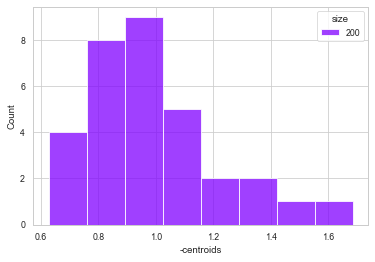

In [ ]:
sns.histplot(data = roi_df, x = "-centroids", hue = "size", palette="rainbow", multiple = "stack")

<Axes: xlabel='+centroids', ylabel='Count'>

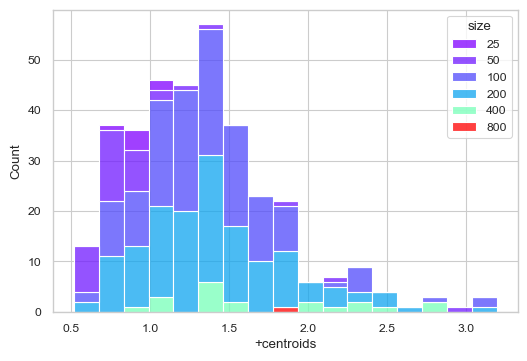

In [ ]:
sns.histplot(data = roi_df, x = "+centroids", hue = "size", palette="rainbow", multiple = "stack")

In [ ]:
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\Life Sciences PhD Careers Symposium 2023\centroids.svg")

In [ ]:
1 - (1/1.33)

0.24812030075187974

In [ ]:
df.query("colour == 'UV'")[["-centroids", "+centroids"]].describe()

,-centroids,+centroids
count,18.000000,40.000000
mean,0.675542,1.165983
std,0.095425,0.473668
min,0.517121,0.699791
25%,0.614541,0.812437
50%,0.662850,1.060814
75%,0.729738,1.417680
max,0.890719,2.768247


In [ ]:
df.query("colour == 'UV'")[["-centroids", "+centroids"]].describe()

,-centroids,+centroids
count,18.000000,40.000000
mean,0.675542,1.165983
std,0.095425,0.473668
min,0.517121,0.699791
25%,0.614541,0.812437
50%,0.662850,1.060814
75%,0.729738,1.417680
max,0.890719,2.768247


In [ ]:
name_it = "Centroids by colour and polarity"
fig.savefig(rf"C:\Users\SimenLab\OneDrive\Universitet\PhD\Thesis committee\Report 2\{name_it}.svg")

In [ ]:
roi_df["-contour_areas"]

0                      [0.0]
1       [20.865186813186813]
2                      [0.0]
3       [17.450883516483515]
4       [16.692149450549447]
                ...         
1391                   [0.0]
1392                   [0.0]
1393                   [0.0]
1394                   [0.0]
1395                   [0.0]
Name: -contour_areas, Length: 1396, dtype: object

Text(0.5, 1.0, 'Size-dependency')

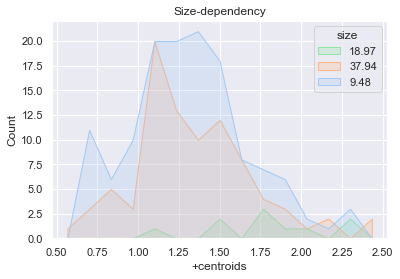

In [ ]:
sns.histplot(data = roi_all_cleaned, x = "+centroids", hue = 'size', element = "poly", 
    multiple = "layer", palette='pastel', hue_order=size_order,
    bins = 15, binrange=(0.5, 2.5))
plt.legend(title='size', loc='upper right', labels = size_labels)
plt.title("Size-dependency")

Text(0.5, 1.0, 'Centroids, negative timecourses')

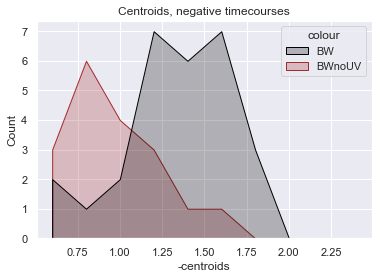

In [ ]:
sns.histplot(data = roi_achromatic, x = "-centroids", hue = 'colour', hue_order=["BW", "BWnoUV"],
    element = "poly",  palette=achromatic_palette, bins = 10, binrange=(0.5, 2.5))
plt.title("Centroids, negative timecourses")

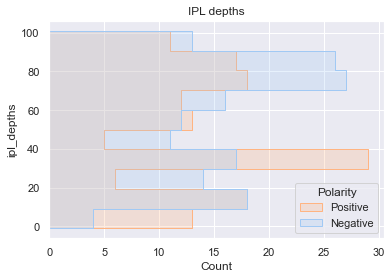

In [ ]:
sns.histplot(data = roi_df.query("polarities == [-1, 1]"), y = "ipl_depths", hue = "polarities",
    element = "step", multiple = "layer", palette='pastel')
plt.title("IPL depths")
plt.legend(loc = 'lower right', labels = ["Positive", "Negative"], title = "Polarity")

Text(0.5, 1.0, 'IPL depths OFF responses')

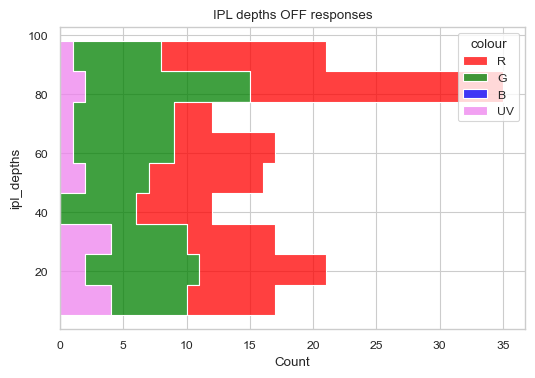

In [ ]:
sns.histplot(data = roi_chromatic.query("polarities == -1"), y = "ipl_depths", hue = "colour", hue_order = ["R", "G", "B", "UV"],
    element = "step", multiple = "stack", palette=chromatic_palette)
plt.title("IPL depths OFF responses")


Text(0.5, 1.0, 'IPL depths ON responses')

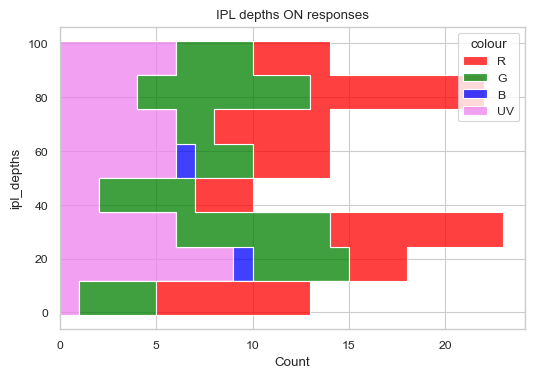

In [ ]:
sns.histplot(data = roi_chromatic.query("polarities == 1"), y = "ipl_depths", hue = "colour", hue_order = ["R", "G", "B", "UV"],
    element = "step", multiple = "stack", palette=chromatic_palette)
plt.title("IPL depths ON responses")

In [ ]:
roi_chromatic.keys()

Index(['ipl_depths', 'roi', 'filename', 'colour', 'paired', 'combo', 'size',
       'frequency', 'noise', 'polarities', '-centroids', '+centroids',
       '-extrema', '+extrema', '-biphasic_index', '+biphasic_index',
       'pols_corr', '-auc', '+auc', '-peaktime', '+peaktime', '-contour_count',
       '+contour_count', 'total_contour_count', '-contour_areas',
       '+contour_areas', '-contour_area_total', '+contour_area_total',
       'contour_area_total', 'notes'],
      dtype='object')

Text(0.5, 1.0, 'Contour counts $(> 0)$')

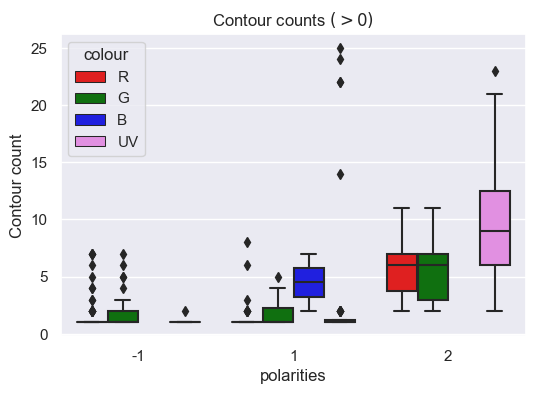

In [ ]:
sns.boxplot(data = roi_chromatic.query("total_contour_count.notna() and total_contour_count > 0"), y = "total_contour_count", x = "polarities", hue = "colour", 
    order = [-1, 1, 2], hue_order=chromatic_hues, palette= chromatic_palette)
plt.ylabel("Contour count")
plt.title("Contour counts $(> 0)$")

Text(0.5, 1.0, 'Contour counts $(> 0)$')

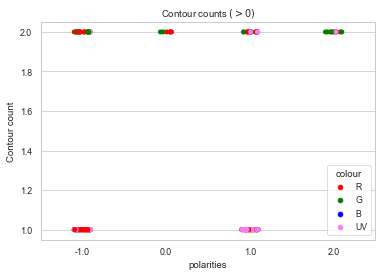

In [ ]:
#roi_chromatic.query("total_contour_count.notna() and total_contour_count > 0")
sns.stripplot(data = df, y = "total_contour_count", x = "polarities", hue = "colour", 
    hue_order=chromatic_hues, palette= chromatic_palette)
plt.ylabel("Contour count")
plt.title("Contour counts $(> 0)$")

Text(0.5, 1.0, 'IPL depths MIXED responses')

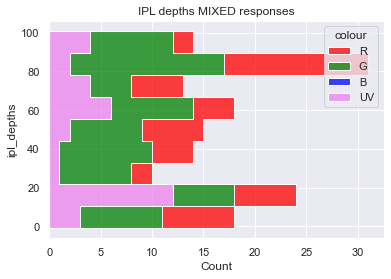

In [ ]:
sns.histplot(data = roi_chromatic.query("polarities == 2"), y = "ipl_depths", hue = "colour", hue_order = ["R", "G", "B", "UV"],
    element = "step", multiple = "stack", palette=chromatic_palette)
plt.title("IPL depths MIXED responses")

In [ ]:
roi_df.keys()

Index(['ipl_depths', 'roi', 'filename', 'colour', 'paired', 'combo', 'size',
       'frequency', 'noise', 'polarities', '-centroids', '+centroids',
       '-extrema', '+extrema', '-biphasic_index', '+biphasic_index',
       'pols_corr', '-auc', '+auc', '-peaktime', '+peaktime', '-contour_count',
       '+contour_count', 'total_contour_count', '-contour_areas',
       '+contour_areas', '-contour_area_total', '+contour_area_total',
       'contour_area_total', 'notes'],
      dtype='object')

In [ ]:
roi_all_cleaned["contour_area_total"].describe()

count      479.000000
mean      2831.679278
std       3042.358143
min         41.619244
25%        647.628797
50%       1081.775193
75%       5387.090893
max      21142.575945
Name: contour_area_total, dtype: float64

Text(0.5, 0, 'vis.ang.$\\degree^2$')

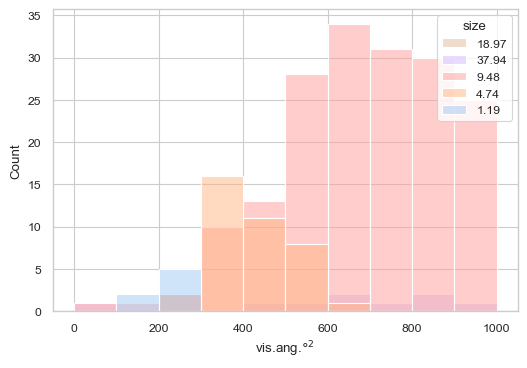

In [ ]:
sns.histplot(data = roi_all_cleaned, x = "contour_area_total", 
    hue = "size", palette="pastel", hue_order=size_order, multiple="layer", binrange = (0, 1000))
plt.legend(title='size', loc='upper right', labels = size_labels)
# plt.title("RF area in vis.ang.$\degree^2$");
plt.xlabel("vis.ang.$\degree^2$")

Text(0.5, 0, 'vis.ang.$\\degree^2$')

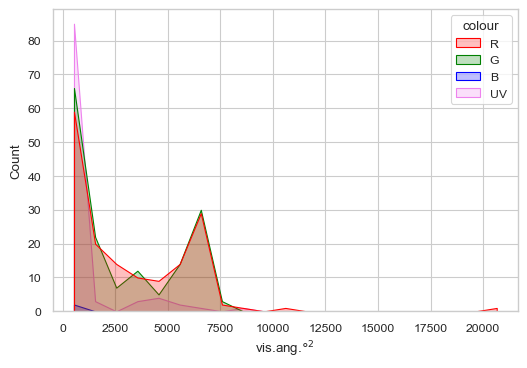

In [ ]:
sns.histplot(data = roi_chromatic, x = "contour_area_total", hue = "colour", hue_order = ["R", "G", "B", "UV"],
    element = "poly", multiple = "layer", palette=chromatic_palette)#, binrange = (0, 3000))
plt.xlabel("vis.ang.$\degree^2$")

### Make beutiful RF plot with contour 

## Per file analysis

Grab specific file if need be 

In [ ]:
# Specify file
file_path =r"D:\Igor analyses\230505\2023-5-5_MP_0_1_SWN_R_25_.h5"
# Get the data
Data = filehandling.load_strf_data(file_path)

C:\Users\SimenLab\AppData\Local\Temp\ipykernel_23776\456684172.py:7: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\230505\2023-5-5_MP_0_1_SWN_R_25_.h5
  Data = filehandling.load_strf_data(file_path)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 7.0558716639776495)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)


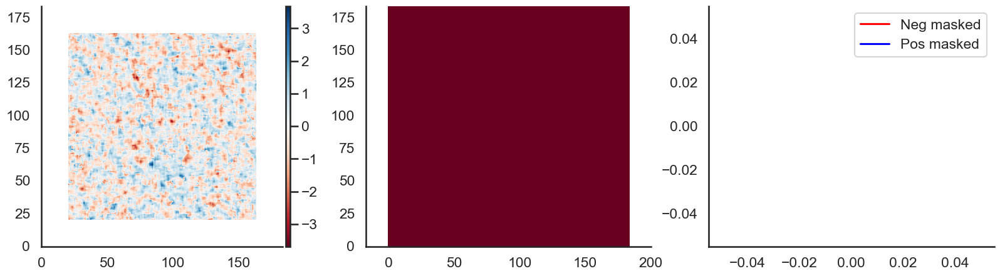

In [ ]:
# # Get contours
roi = 12
neg_contour, pos_contours = Data.contours[roi]
plotting.contouring_demo(Data.strfs[roi])

In [ ]:
plotting.play_movie(Data.strfs[roi])

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:438: UserWarning: Lower contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:438: UserWarning: Upper contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\utilities.py:116: UserWarning: Destructive method. You lose data, with no way of recovering original shape!
  warnings.warn("Destructive method. You lose data, with no way of recovering original shape!")


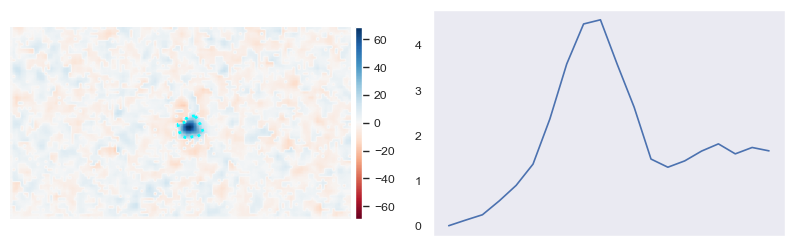

In [ ]:
sns.set_theme('paper')
# Load up the data 
lower_contour, upper_contour = load_file.contours[roi]
# Create the image 
fig, ax = plt.subplots(1, 2, figsize = (10, 3))
# Kil the mask, fill it with 0s, and remove those 0s 
original = load_file.collapse_times()[roi].filled(0)
picutre = utilities.auto_remove_border(original)
# Work out how much border was killed 
centre_coordinate = (round(original.shape[0] / 2), round(original.shape[1] / 2))
lower_border_wdith = np.count_nonzero(original[centre_coordinate[0]:, centre_coordinate[1]:centre_coordinate[1]+1] == 0) 
left_border_width  = np.count_nonzero(original[centre_coordinate[0]:centre_coordinate[0]+1, centre_coordinate[1]:] == 0) 
# Plot image and contours 
im = ax[0].imshow(picutre, origin = "lower", cmap = 'RdBu')
for j in lower_contour:
    ax[0].plot(j[:, 1]-left_border_width, j[:, 0]-lower_border_wdith, lw = 2, ls = 'dotted', c = 'red')# contour
for j in upper_contour: # corrected by killed information
    ax[0].plot(j[:, 1]-left_border_width, j[:, 0]-lower_border_wdith, lw = 2, ls = 'dotted', c = 'cyan')# contour 
# Correct colourmap and such, add 
max_Val = np.max(np.abs(load_file.collapse_times()[roi]))
im.set_clim(-max_Val, max_Val)
ax[0].axis('off')
divider1 = make_axes_locatable(ax[0])
cax1 = divider1.append_axes('right', size='2%', pad=0.05) #autoscaling "pretend" axis to append colorbar to
fig.colorbar(im, cax = cax1)
# Plot the timecourse
ax[1].plot(load_file.timecourses[roi][0], c = 'r')
ax[1].plot(load_file.timecourses[roi][1], c = 'b')
ax[1].set_xticks([])
ax[1].grid(False)


### If happy, save it

In [ ]:
fig.savefig(rf"C:\Users\SimenLab\OneDrive\Universitet\PhD\Thesis committee\Report 2\{file_loc.name}_roi_{roi}.svg")

# Tangential analysis stuff

9.1 boxes across 85.306 degrees. That means each box is very nearly 9.5 degree vis ang (more like 9.387 smth)
Each box is 200pix * 9.1 boxes = 1820 pix across screen, which agrees with QDSpy.ini (and 200*5.7 = 1140 in height)
The STA is 20 boxes wide and 15 boxes tall, * 4 = 80, 60

The bigger the box size on display, the more the values should be scaled UP because the input STA is the same size. So, responses to for example 6 x 2 boxes (in extreme cases like 800um), will lead to just a small amount of pixels in the 15 x 20 condition. Thus, the size is UNDER-exaggurated. If the displayed boxes are smaller (100, 12x18), it will be more comparable to the 15x20 array and the scaling should be far closer to 0. If the box size is so small that the displayed checkerboard is smaller than the screen size, then we should get a value scale by lower than 1. 

In [ ]:
# Initialise phyisical parameters
fish_screen_dist_mm = 160 # measured from fish to center
screen_width_mm = 300 # total width 
screen_half_width_mm = screen_width_mm/2 # right-angle
# According to pythagorean theorem 
hypoth_mm = np.sqrt(fish_screen_dist_mm**2 + screen_half_width_mm**2)
# Compute angle between fish and one side of screen (such that we get a right angel) 
sin = screen_half_width_mm / hypoth_mm # oppose/hypth
cos = fish_screen_dist_mm / hypoth_mm # adjecent/hypth
tan =  screen_half_width_mm /fish_screen_dist_mm # opposite/adjecent 
# Sanity check 
arcsin = np.round(np.arcsin(sin), 8)
arccos = np.round(np.arccos(cos), 8)
arctan = np.round(np.arctan(tan), 8)
assert np.isclose(arcsin, arccos, arctan)
# Get screen width in degrees vis ang 
half_screen_vis_ang = np.rad2deg(arcsin)
screen_vis_ang = half_screen_vis_ang * 2 # because two right angle triangles added, e.g. 2x the angle 
print("Screen is", np.round(screen_vis_ang, 3), "degrees wide")

Screen is 86.305 degrees wide


In [ ]:
1140/1820 * 86.305

54.05917582417583

In [ ]:
# Initilaise software parameters
screen_width_pix_au = 1820 # QDSpy display area in QDSpy units (confusingly named 'um' but is arbitrary unit (so 'au'))
screen_height_pix_au = 1140
block_size_au = 25 # squared
# Calculte the visang per pix 
single_pix_visang = screen_vis_ang / screen_width_pix_au
# Calculate block vis ang 
block_visang = single_pix_visang * block_size_au
# Work out how many blocks fit on on screen 
blocks_on_screen_horz = screen_width_pix_au/block_size_au
blocks_on_screen_vert = screen_height_pix_au/block_size_au

print("Screen is", (blocks_on_screen_vert, blocks_on_screen_horz), "pix")
print("Pix size vis ang", block_visang)

Screen is (45.6, 72.8) pix
Pix size vis ang 1.1855052109581246


In [ ]:
54.059 / 9.5

5.690421052631579

# Work in progres stuff 

### Stuff that needs to be implemented

- I have planned to add more metrics such as:
    - [x] Amplitudes for timecourses
    - Onset timing (spectral centroid kinda does this indirectly)
    - [x] Time-to-extrema
    - [x] Polarity-index which is relative weighting of positive and negative comopnents (AUC)
 - ... + morphology
    - Centroids on grid (positioning, coverage, etc)
    - [x] Number of contours
    - Size
    - Complexiy of contour (https://iapg.jade-hs.de/files/iapg/mitglieder/brinkhoff/paper/GIS95.pdf)
    - Eccentricity

## Need to 
- Get combiend area of all contours --> See notes
    - For contours need to do this: https://stackoverflow.com/questions/50102650/how-to-get-contour-area-in-skimage
    - For mask just take number of pixels masked 
    - Just do both and comapre how different they are, might be useful to know anyways 
- Correlation coefficinet (Pearson's should do) for negative and positive components (call it 'negposcorrcoef' for maximum confusion and typos)

In [ ]:
# Specify file and ROI
filename = "2022-10-20_SMP_0_3_SWN_200_R_0.h5"
roi = 6
# Get the content 
path = rec_df.query(f'filename == "{filename}"').iloc[0]["path"]
print(path)
# Get the data
Data = filehandling.load_strf_data(path)
# # Get contours
neg_contour, pos_contours = Data.contours[roi]

C:\Users\Simen\Downloads\All H5s\2022-10-20_SMP_0_3_SWN_200_R_0.h5


c:\Users\Simen\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:410: UserWarning: Upper contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\Simen\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:410: UserWarning: Lower contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)


In [ ]:
# print(len([i for i in Data.contours_area]))
# print(len(Data.strfs))
neg_contour_areas, pos_contour_areas = [i[0] for i in Data.contours_area], [i[1] for i in Data.contours_area]
tot_neg_contour_areas, tot_pos_contour_areas = [np.sum(i) for i in neg_contour_areas], [np.sum(i) for i in pos_contour_areas]
np.sum((tot_neg_contour_areas, tot_pos_contour_areas), axis = 0)

array([ 0.  ,  0.  , 83.31,  0.  ,  0.  ,  0.  , 87.32, 50.62,  0.  ,
        0.  , 38.95,  0.  , 65.64,  0.  , 59.04, 64.96, 77.33, 69.49,
        0.  , 82.52,  0.  ])

In [ ]:
# Data.contours_area

21

### Area 

Areas as sum of masked pixels
78 51


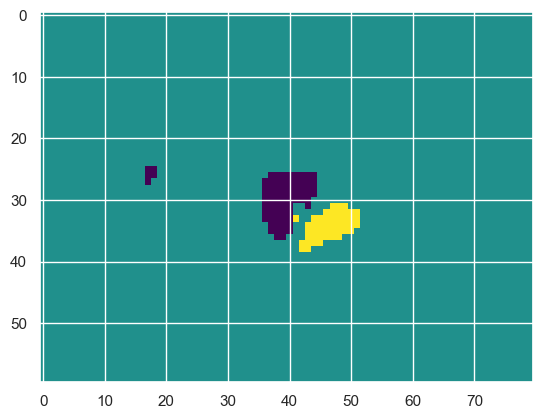

In [ ]:
# (np.unique(Data.rf_masks_combined()[5].flatten(), return_counts=True))
print("Areas as sum of masked pixels")
neg_areas = np.sum(np.invert(Data.rf_masks())[0], axis = (1, 2))[roi]
pos_areas = np.sum(np.invert(Data.rf_masks())[1], axis = (1, 2))[roi]
neg_areas, pos_areas
plt.imshow(Data.rf_masks_combined()[roi], cmap = 'viridis')
print(neg_areas, pos_areas)

In [ ]:
Data.contours_area()[6]
plotting.contouring(Data.strfs[4])

TypeError: 'list' object is not callable

In [ ]:
np.sum(Data.contours_area[6], axis = 1)

# for i in Data.contours_area():
#     print(",", np.sum(i[0]), np.sum(i[1]))

[(np.sum(i[0])) for i in Data.contours_area]

[0.0,
 0.0,
 36.92,
 0.0,
 0.0,
 0.0,
 53.37,
 50.62,
 0.0,
 0.0,
 0.0,
 0.0,
 65.64,
 0.0,
 59.04,
 16.62,
 74.80000000000001,
 9.709999999999999,
 0.0,
 53.63,
 0.0]

In [ ]:
1.3/20

0.065

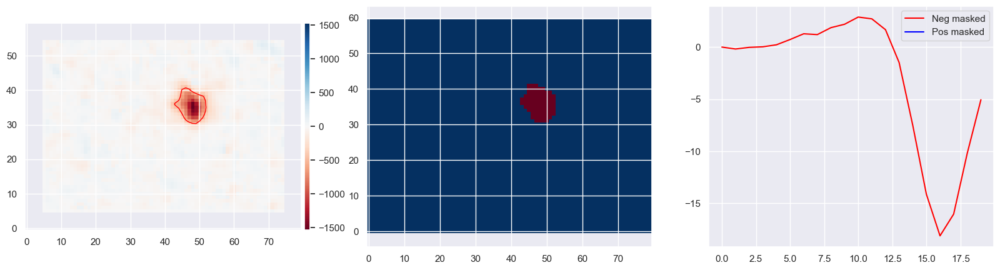

In [ ]:
fig, ax, im = plotting.contouring(Data.strfs[4], returns = True)

In [ ]:
3**2

9

In [ ]:
# Working on a df implementation of this
space.contour_centroid(Data.contours[roi][0])

array([[25.56156014, 17.0436908 ],
       [29.97874641, 39.36513216]])

In [ ]:
# DONT DELETE;THIS IS RECIPE
# VVV This should just work within the class

neg_contours, pos_contours = Data.contours[roi]
neg_centroids = space.contour_centroid(neg_contours)
neg_centroid_avg = np.average(neg_centroids, axis = 0, weights=Data.contours_area[roi][0]) # These might have to be weighted by relative contribution (so... area)
pos_centroids = space.contour_centroid(pos_contours)
pos_centroid_avg = np.average(pos_centroids, axis = 0, weights=Data.contours_area[roi][1])

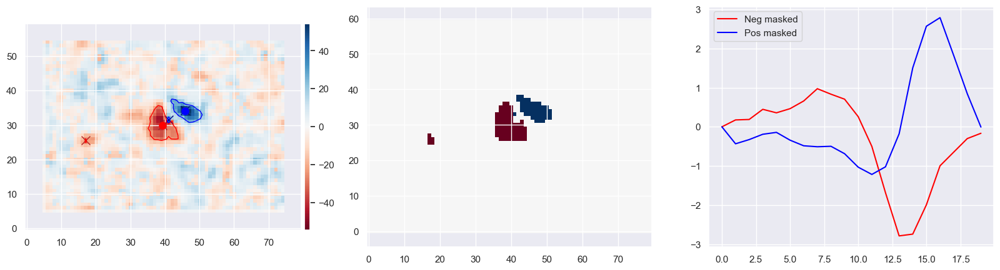

In [ ]:
fig, ax, im = plotting.contouring(Data.strfs[roi], returns = True)
ax[0].scatter(pos_centroids[:, 1], pos_centroids[:, 0], c = 'navy', marker = 'x', lw=1, s = 100)
ax[0].scatter(pos_centroid_avg[1], pos_centroid_avg[0], c = 'blue', marker = 'o', lw=2, s = 50)
ax[0].scatter(neg_centroids[:, 1], neg_centroids[:, 0], c = 'firebrick', marker = 'x', lw=1, s = 100)
ax[0].scatter(neg_centroid_avg[1], neg_centroid_avg[0], c = 'red', marker = 'o', lw=2, s = 50)

Text(0.5, 1.0, 'Clustering on PCA')

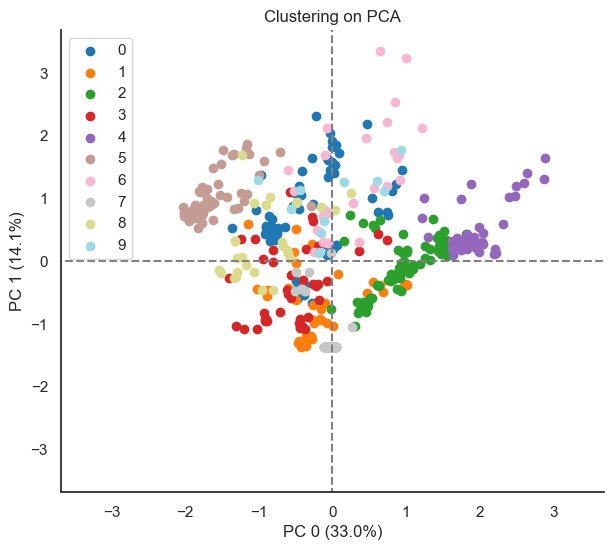

In [ ]:
from sklearn.cluster import AgglomerativeClustering
n_comps = 24
n_clusteres = 10
pca = PCA(n_components=n_comps, whiten = True)
temp = df_clust_scaled#.iloc[:, : 9]
pca.fit(temp)
curr_clust = pca.transform(temp)
curr_clust_df = pd.DataFrame(curr_clust, index = temp.index, columns = [f"PC{i}" for i in range(n_comps)])
curr_hierarchy = AgglomerativeClustering(n_clusters=n_clusteres)
curr_hierarchy.fit(df_clust_scaled)
#pca_clusters = pca_kmeans.predict(pca_clust_df)
display_factorial_planes(curr_clust, pca, [(0,1)], category_lables = curr_hierarchy.labels_, alpha = 1)
plt.title("Clustering on PCA")

In [ ]:
import sklearn

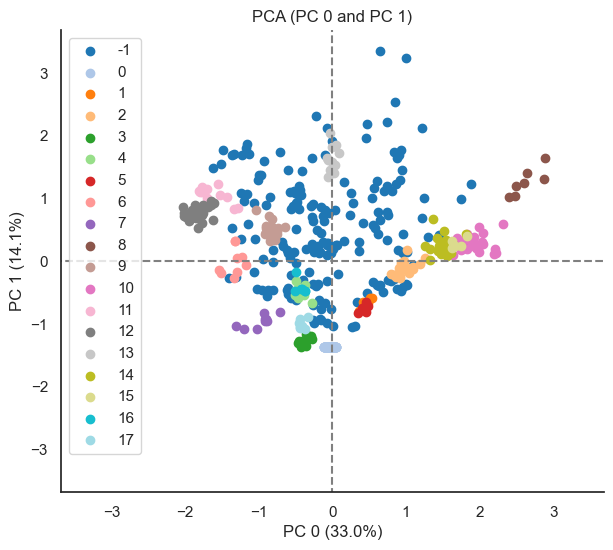

In [ ]:
from sklearn.cluster import DBSCAN
temp = df_clust_scaled#.iloc[:, : 9]
n_comps = 25
n_clusteres = 10
pca = PCA(n_components=n_comps, whiten = True)
pca.fit(temp)
curr_clust = pca.transform(temp)
#curr_clust_df = pd.DataFrame(df_clust_scaled, index = temp.index, columns = [f"PC{i}" for i in range(n_comps)])
curr_hierarchy = DBSCAN(eps = 2, n_jobs=-1)
curr_hierarchy.fit(df_clust_scaled)
#pca_clusters = pca_kmeans.predict(pca_clust_df)
display_factorial_planes(curr_clust, pca, [(0,1)], category_lables = curr_hierarchy.labels_, alpha = 1)


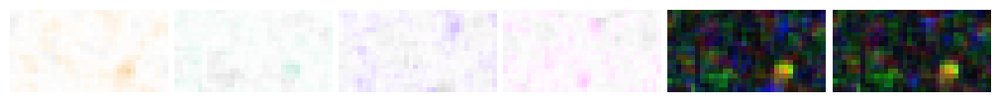

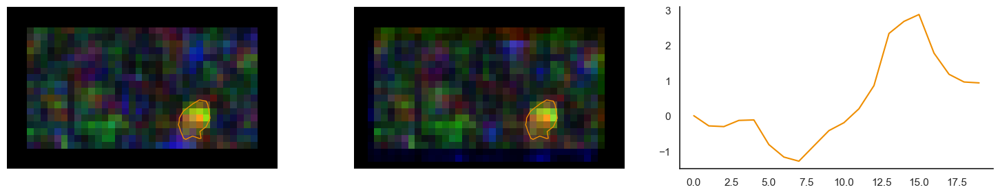

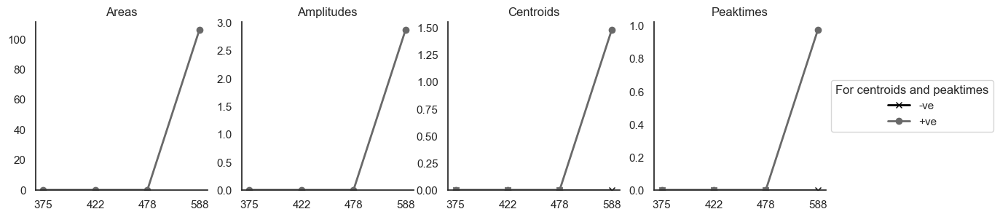

In [ ]:
# Doing this, it seems like the clustering has definitively picked up a pattern 
index = 255
name_load = pathlib.Path(chroma_df.iloc[index]["filename"]).stem
roi = int(chroma_df.iloc[index]["strf_keys"].split('_')[1])
temp_load = filehandling.load(rf"C:\Users\Simen\OneDrive\Universitet\PhD\Pickles\{name_load}.pkl")
plotting.chroma_overview(temp_load, roi)
plotting.visualise_summary(temp_load, roi)
tuning_summary(temp_load, roi)


In [ ]:
temp_load.calc_LED_offset()

array([ 0.26682562, -2.53047491])

### Save anaylsis files as pickle files 

In [ ]:
roi_df.to_pickle(r"D:\DataFrames\roi_df_bootstrapped.pkl")
rec_df.to_pickle(r"D:\DataFrames\rec_df_bootstrapped.pkl")
chroma_df.to_pickle(r"D:\DataFrames\chroma_df_bootstrapped.pkl")

### Load analysis from pickle files 

In [ ]:
roi_df = pd.read_pickle(r"D:\DataFrames\roi_df.pkl")
rec_df = pd.read_pickle(r"D:\DataFrames\rec_df.pkl")
chroma_df = pd.read_pickle(r"D:\DataFrames\chroma_df.pkl")

In [ ]:
chroma_df

,date,path,filename,strf_keys,cell_id,size,ipl_depths,area_r,area_g,area_b,...,pos_cent_b,pos_cent_uv,neg_peak_r,neg_peak_g,neg_peak_b,neg_peak_uv,pos_peak_r,pos_peak_g,pos_peak_b,pos_peak_uv
0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_0,06-13-2023_STRF0_0,200,74.0,141.409,149.610,0.000,...,NaN,NaN,0.975,0.975,0.00,0.0,0.000,0.00,0.000,0.000
1,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_1,06-13-2023_STRF0_1,200,10.0,0.000,0.000,169.899,...,0.842077,0.900334,0.000,0.000,0.00,0.0,0.000,0.00,0.910,0.845
2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_2,06-13-2023_STRF0_2,200,48.0,0.000,0.000,164.498,...,0.804231,1.404772,0.000,0.000,0.00,0.0,0.000,0.00,0.845,0.975
3,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_3,06-13-2023_STRF0_3,200,67.0,194.347,175.206,0.000,...,NaN,NaN,0.975,0.975,0.00,0.0,0.000,0.00,0.000,0.000
4,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_4,06-13-2023_STRF0_4,200,90.0,111.198,122.016,122.506,...,NaN,NaN,1.040,1.105,1.04,0.0,0.000,0.00,0.000,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
476,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_26,11-08-2023_STRF0_26,200,79.0,139.361,187.257,97.607,...,0.929331,NaN,0.000,1.105,1.17,0.0,0.975,0.00,0.845,0.000
477,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_27,11-08-2023_STRF0_27,200,91.0,81.190,96.110,119.895,...,0.984105,NaN,1.040,1.040,0.00,0.0,0.000,0.00,0.910,0.000
478,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_28,11-08-2023_STRF0_28,200,92.0,88.190,93.136,111.828,...,0.882257,NaN,0.975,0.975,0.00,0.0,0.000,0.00,0.910,0.000
479,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_29,11-08-2023_STRF0_29,200,94.0,137.403,0.000,0.000,...,NaN,NaN,0.000,0.000,0.00,0.0,1.040,0.00,0.000,0.000


In [ ]:
r_strfs = chroma_rois.query("colour == 'R' & total_contour_count > 0")
g_strfs = chroma_rois.query("colour == 'G' & total_contour_count > 0")
b_strfs = chroma_rois.query("colour == 'B' & total_contour_count > 0")
uv_strfs = chroma_rois.query("colour == 'UV' & total_contour_count > 0")
all_strfs = chroma_rois
l = len(chroma_df["cell_id"])
print(f"BC n = {l} in current dataset")
# Was 144, 236

BC n = 481 in current dataset


In [ ]:
roi_df.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'do_bootstrap',
       'time_sig_thresh', 'space_sig_thresh', 'time_bs_n', 'space_bs_n', 'roi',
       'date', 'path', 'filename', 'colour', 'simultaneous', 'combo', 'size',
       'shapeZ', 'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency',
       'noise', 'time_pval', 'space_pval', 'neg_contour_bool',
       'pos_contour_bool', 'neg_contour_count', 'pos_contour_count',
       'total_contour_count', 'neg_contour_areas', 'pos_contour_areas',
       'neg_contour_area_total', 'pos_contour_area_total',
       'contour_area_total', 'contour_complexity', 'neg_extrema',
       'pos_extrema', 'polarities', 'neg_biphasic_index', 'pos_biphasic_index',
       'dom_biphasic_index', 'pols_corr', 'neg_auc', 'pos_auc', 'neg_peaktime',
       'pos_peaktime', 'dom_peaktime', 'neg_centroids', 'pos_centroids',
       'dom_centroids', 'cell_id'],
      dtype='object')

In [ ]:
df = roi_df.sort_values("total_contour_count").query("total_contour_count < 3")
df[["total_contour_count", "contour_complexity", "filename", "roi", "pols_corr", "size"]]

,total_contour_count,contour_complexity,filename,roi,pols_corr,size
1923,0,NaN,2023-11-8_MP_0_0_ColourSWN_200_.h5,30,NaN,200
782,0,NaN,2023-8-1_'0_0_ColourSWN_200_0'.h5,0,NaN,200
783,0,NaN,2023-8-1_'0_0_ColourSWN_200_0'.h5,0,NaN,200
784,0,NaN,2023-8-1_'0_0_ColourSWN_200_0'.h5,1,NaN,200
785,0,NaN,2023-8-1_'0_0_ColourSWN_200_0'.h5,1,NaN,200
...,...,...,...,...,...,...
1544,2,0.009913,2023-11-7_0_4_ColourSWN_200.h5,27,NaN,200
1459,2,0.064305,2023-11-7_0_4_ColourSWN_200.h5,5,NaN,200
597,2,0.120269,2023-7-18_'0_1_ColourSWN_200_0'.h5,9,-0.139850,200
580,2,0.059077,2023-7-18_'0_1_ColourSWN_200_0'.h5,5,NaN,200


In [ ]:
temp_load = filehandling.load_strf_by_df_index(df, 397, do_bootstrap = False)

TypeError: load_strf_by_df_index() missing 1 required positional argument: 'index'

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\utilities.py:133: UserWarning: Destructive method. You lose data, with no way of recovering original shape!
  warnings.warn("Destructive method. You lose data, with no way of recovering original shape!")
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:198: RuntimeWarning: Mean of empty slice
  return np.nanmean(self.contours_centres_by_pol, axis = 0)


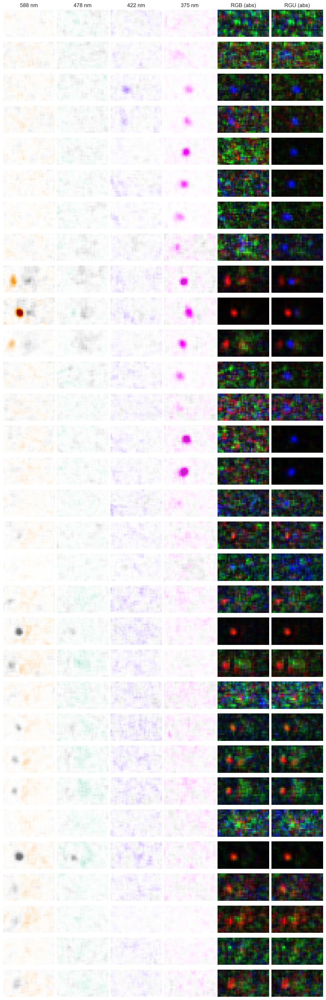

In [ ]:
plotting.chroma_overview(temp_load)

In [ ]:
"""
The way cell_id works is suboptimal, because cells from the same experiment date will get the same cell_id until you run out of roi numbers, 
only then will they no longer overlap.
"""

In [ ]:
chroma_df["cell_id"]

0       06-13-2023_STRF0_0
1       06-13-2023_STRF0_1
2       06-13-2023_STRF0_2
3       06-13-2023_STRF0_3
4       06-13-2023_STRF0_4
              ...         
476    11-08-2023_STRF0_26
477    11-08-2023_STRF0_27
478    11-08-2023_STRF0_28
479    11-08-2023_STRF0_29
480    11-08-2023_STRF0_30
Name: cell_id, Length: 481, dtype: object

In [ ]:
chroma_df

,date,path,filename,strf_keys,cell_id,size,ipl_depths,area_r,area_g,area_b,...,pos_cent_b,pos_cent_uv,neg_peak_r,neg_peak_g,neg_peak_b,neg_peak_uv,pos_peak_r,pos_peak_g,pos_peak_b,pos_peak_uv
0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_0,06-13-2023_STRF0_0,200,74.0,141.409,149.610,0.000,...,NaN,NaN,0.975,0.975,0.00,0.0,0.000,0.00,0.000,0.000
1,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_1,06-13-2023_STRF0_1,200,10.0,0.000,0.000,169.899,...,0.842077,0.900334,0.000,0.000,0.00,0.0,0.000,0.00,0.910,0.845
2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_2,06-13-2023_STRF0_2,200,48.0,0.000,0.000,164.498,...,0.804231,1.404772,0.000,0.000,0.00,0.0,0.000,0.00,0.845,0.975
3,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_3,06-13-2023_STRF0_3,200,67.0,194.347,175.206,0.000,...,NaN,NaN,0.975,0.975,0.00,0.0,0.000,0.00,0.000,0.000
4,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_4,06-13-2023_STRF0_4,200,90.0,111.198,122.016,122.506,...,NaN,NaN,1.040,1.105,1.04,0.0,0.000,0.00,0.000,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
476,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_26,11-08-2023_STRF0_26,200,79.0,139.361,187.257,97.607,...,0.929331,NaN,0.000,1.105,1.17,0.0,0.975,0.00,0.845,0.000
477,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_27,11-08-2023_STRF0_27,200,91.0,81.190,96.110,119.895,...,0.984105,NaN,1.040,1.040,0.00,0.0,0.000,0.00,0.910,0.000
478,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_28,11-08-2023_STRF0_28,200,92.0,88.190,93.136,111.828,...,0.882257,NaN,0.975,0.975,0.00,0.0,0.000,0.00,0.910,0.000
479,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_29,11-08-2023_STRF0_29,200,94.0,137.403,0.000,0.000,...,NaN,NaN,0.000,0.000,0.00,0.0,1.040,0.00,0.000,0.000


In [ ]:
plotting.ipl_summary_chroma(chroma_df)

NameError: name 'chroma_df' is not defined

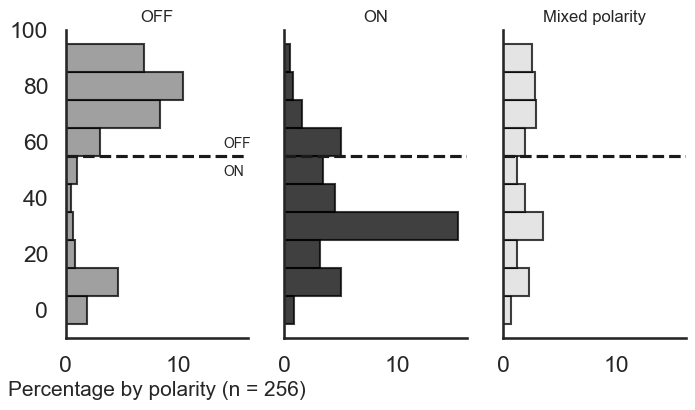

In [ ]:
plotting.ipl_summary_polarity(chroma_rois)

In [ ]:
roi_df.keys()

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'neg_contour_count', 'pos_contour_count',
       'total_contour_count', 'neg_contour_areas', 'pos_contour_areas',
       'neg_contour_area_total', 'pos_contour_area_total',
       'contour_area_total', 'contour_complexity', 'neg_extrema',
       'pos_extrema', 'polarities', 'neg_biphasic_index', 'pos_biphasic_index',
       'dom_biphasic_index', 'pols_corr', 'neg_auc', 'pos_auc', 'neg_peaktime',
       'pos_peaktime', 'dom_peaktime', 'neg_centroids', 'pos_centroids',
       'dom_centroids', 'cell_id'],
      dtype='object')

In [ ]:
chroma_rois

,ipl_depths,strf_keys,multicolour,roi,date,path,filename,colour,simultaneous,combo,...,pols_corr,neg_auc,pos_auc,neg_peaktime,pos_peaktime,dom_peaktime,neg_centroids,pos_centroids,dom_centroids,cell_id
0,74.0,STRF0_0_0,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,NaN,-36.363955,NaN,15,0,15,0.848789,NaN,0.848789,06-13-2023_STRF0_0
1,74.0,STRF0_0_1,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,G,n,NaN,...,NaN,-23.473498,NaN,15,0,15,0.803238,NaN,0.803238,06-13-2023_STRF0_0
6,10.0,STRF0_1_2,True,1,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,B,n,NaN,...,NaN,NaN,23.379190,0,14,14,NaN,0.842077,0.842077,06-13-2023_STRF0_1
10,48.0,STRF0_2_2,True,2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,B,n,NaN,...,NaN,NaN,20.253181,0,13,13,NaN,0.804231,0.804231,06-13-2023_STRF0_2
11,48.0,STRF0_2_3,True,2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,UV,n,NaN,...,NaN,NaN,16.107790,0,15,15,NaN,1.404772,1.404772,06-13-2023_STRF0_2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1916,94.0,STRF0_29_0,True,29,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,R,n,NaN,...,NaN,NaN,0.813489,0,16,16,NaN,2.223183,2.223183,11-08-2023_STRF0_29
1918,94.0,STRF0_29_2,True,29,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,B,n,NaN,...,-0.458647,-6.510574,4.535328,8,11,11,1.494549,2.253036,2.253036,11-08-2023_STRF0_29
1920,96.0,STRF0_30_0,True,30,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,R,n,NaN,...,NaN,NaN,10.042688,0,15,15,NaN,1.172736,1.172736,11-08-2023_STRF0_30
1921,96.0,STRF0_30_1,True,30,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,G,n,NaN,...,-0.300752,-22.195035,23.581150,16,16,16,1.209904,1.204083,1.204083,11-08-2023_STRF0_30


In [ ]:
load_file = filehandling.load_strf_by_df_index(chroma_rois, 1922, do_bootstrap=True)

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:523: UserWarning: Rotation detected and corrected for D:\Igor analyses\231108\2023-11-8_MP_0_0_ColourSWN_200_.h5
  loaded_data = load_strf_data(path, bootstrap_bool = do_bootstrap)


In [ ]:
load_file.space_bs_n

250

In [ ]:
"""
A better system would be to specify the metric and then auto-calc, but not sure how feasable
"""

In [ ]:
load_file.__annotations__

{'strfs': numpy.ndarray,
 'ipl_depths': numpy.ndarray,
 'strf_keys': numpy.ndarray,
 'multicolour': bool,
 'do_bootstrap': bool,
 'time_bs_n': int,
 'space_bs_n': int}

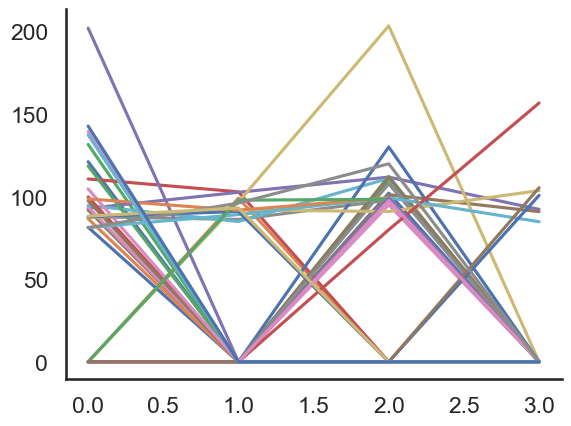

In [ ]:
plt.plot(load_file.area_tuning_functions(200).T)

In [ ]:
chroma_df.columns

Index(['date', 'path', 'filename', 'strf_keys', 'cell_id', 'size',
       'ipl_depths', 'chroma_label', 'chroma_label_simplified',
       'opponent_bool', 'non_opp_pol', 'avg_area', 'avg_centroids'],
      dtype='object')

In [ ]:
roi_df.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'neg_contour_count', 'pos_contour_count',
       'total_contour_count', 'neg_contour_areas', 'pos_contour_areas',
       'neg_contour_area_total', 'pos_contour_area_total',
       'contour_area_total', 'contour_complexity', 'neg_extrema',
       'pos_extrema', 'polarities', 'neg_biphasic_index', 'pos_biphasic_index',
       'dom_biphasic_index', 'pols_corr', 'neg_auc', 'pos_auc', 'neg_peaktime',
       'pos_peaktime', 'dom_peaktime', 'neg_centroids', 'pos_centroids',
       'dom_centroids', 'cell_id'],
      dtype='object')

In [ ]:
chroma_df

,date,path,filename,strf_keys,cell_id,size,ipl_depths,chroma_label,chroma_label_simplified,opponent_bool,non_opp_pol,avg_area,avg_centroids
0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_0,06-13-2023_STRF0_0,200,74.0,long,long,False,-1.0,145.509500,0.826014
1,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_1,06-13-2023_STRF0_1,200,10.0,blue,mid,False,1.0,169.899000,0.842077
2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_2,06-13-2023_STRF0_2,200,48.0,short,short,False,1.0,152.787500,1.104501
3,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_3,06-13-2023_STRF0_3,200,67.0,long,long,True,0.0,184.776500,1.195070
4,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,STRF0_4,06-13-2023_STRF0_4,200,90.0,long,long,False,-1.0,118.573333,1.090463
...,...,...,...,...,...,...,...,...,...,...,...,...,...
476,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_26,11-08-2023_STRF0_26,200,79.0,blue,mid,True,0.0,118.484000,0.992894
477,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_27,11-08-2023_STRF0_27,200,91.0,mid_opp,mid_opp,True,0.0,100.542500,1.026860
478,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_28,11-08-2023_STRF0_28,200,92.0,long,long,False,-1.0,90.663000,0.754413
479,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,STRF0_29,11-08-2023_STRF0_29,200,94.0,long,long,True,0.0,137.403000,2.238109


In [ ]:
roi_df

,ipl_depths,strf_keys,multicolour,roi,date,path,filename,colour,simultaneous,combo,...,pols_corr,neg_auc,pos_auc,neg_peaktime,pos_peaktime,dom_peaktime,neg_centroids,pos_centroids,dom_centroids,cell_id
0,74.0,STRF0_0_0,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,NaN,-36.363955,NaN,15,0,15,0.848789,NaN,0.848789,06-13-2023_STRF0_0
1,74.0,STRF0_0_1,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,G,n,NaN,...,NaN,-23.473498,NaN,15,0,15,0.803238,NaN,0.803238,06-13-2023_STRF0_0
2,74.0,STRF0_0_2,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,B,n,NaN,...,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,06-13-2023_STRF0_0
3,74.0,STRF0_0_3,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,UV,n,NaN,...,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,06-13-2023_STRF0_0
4,10.0,STRF0_1_0,True,1,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,06-13-2023_STRF0_1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1919,94.0,STRF0_29_3,True,29,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,UV,n,NaN,...,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,11-08-2023_STRF0_29
1920,96.0,STRF0_30_0,True,30,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,R,n,NaN,...,NaN,NaN,10.042688,0,15,15,NaN,1.172736,1.172736,11-08-2023_STRF0_30
1921,96.0,STRF0_30_1,True,30,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,G,n,NaN,...,-0.300752,-22.195035,23.581150,16,16,16,1.209904,1.204083,1.204083,11-08-2023_STRF0_30
1922,96.0,STRF0_30_2,True,30,2023-11-08,D:\Igor analyses\231108\2023-11-8_MP_0_0_Colou...,2023-11-8_MP_0_0_ColourSWN_200_.h5,B,n,NaN,...,-0.899248,4.071150,7.690642,15,14,14,1.755942,1.485056,1.485056,11-08-2023_STRF0_30


In [ ]:
d

In [ ]:
utilities.multicolour_reshape(load_file.contours, 4).shape

(4, 31, 2)

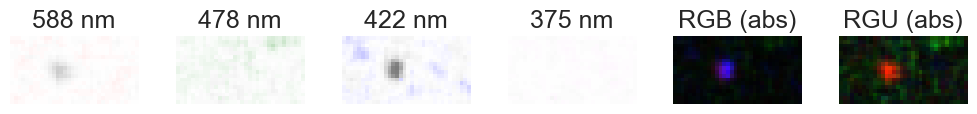

In [ ]:
plotting.chroma_overview(load_file, 0)

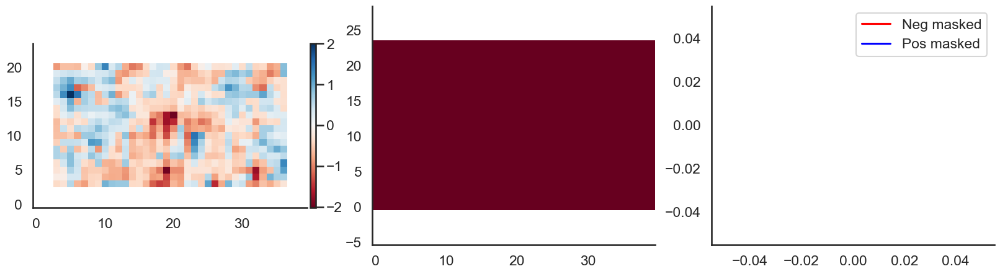

In [ ]:
plotting.contouring_demo(utilities.multicolour_reshape(load_file.strfs, 4)[3, 11])

In [ ]:
load_file.spectral_centroids()[1].data

array([       nan,        nan, 1.45089229, 1.32544884,        nan,
              nan, 0.84207662, 0.90033391,        nan,        nan,
       0.8042306 , 1.40477211,        nan,        nan, 1.57158264,
       1.56861613,        nan,        nan,        nan,        nan,
              nan,        nan,        nan, 1.27569528,        nan,
              nan, 0.87993312, 1.0982425 , 1.44365329, 1.72545847,
       1.47294044, 1.13637967,        nan,        nan, 2.03111487,
       1.4850098 , 1.81190187,        nan, 1.01315287, 2.32523815,
              nan,        nan, 2.06843103, 1.81393365,        nan,
              nan, 1.02710628, 2.25770086, 1.29911733, 1.30087395,
       1.15415398, 1.83773189,        nan,        nan, 1.09623585,
       1.42912377,        nan,        nan,        nan, 1.27427944,
              nan,        nan, 1.27652699, 1.65117036,        nan,
              nan, 3.96837488, 2.2564569 ,        nan,        nan,
       0.83404973, 1.46947603,        nan,        nan, 3.46060

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\utilities.py:133: UserWarning: Destructive method. You lose data, with no way of recovering original shape!
  warnings.warn("Destructive method. You lose data, with no way of recovering original shape!")
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:157: RuntimeWarning: Mean of empty slice
  return np.nanmean(self.contours_centres_by_pol, axis = 0)


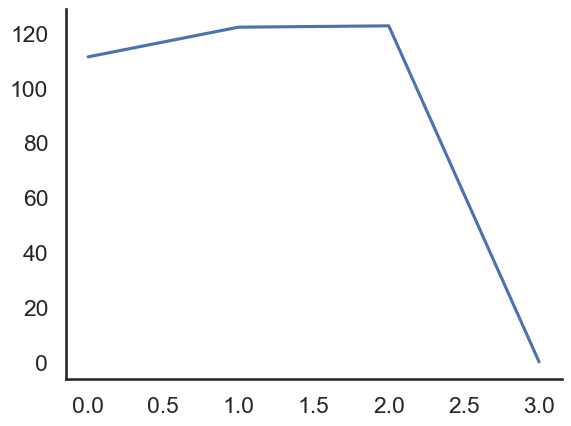

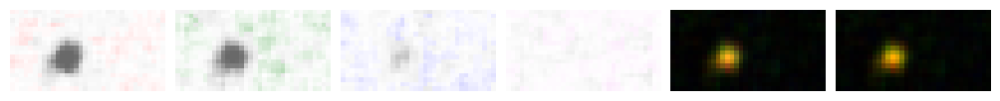

In [ ]:
1
roi = 4
plt.plot(area_by_colour[roi].T)
plotting.chroma_overview(load_file, roi)

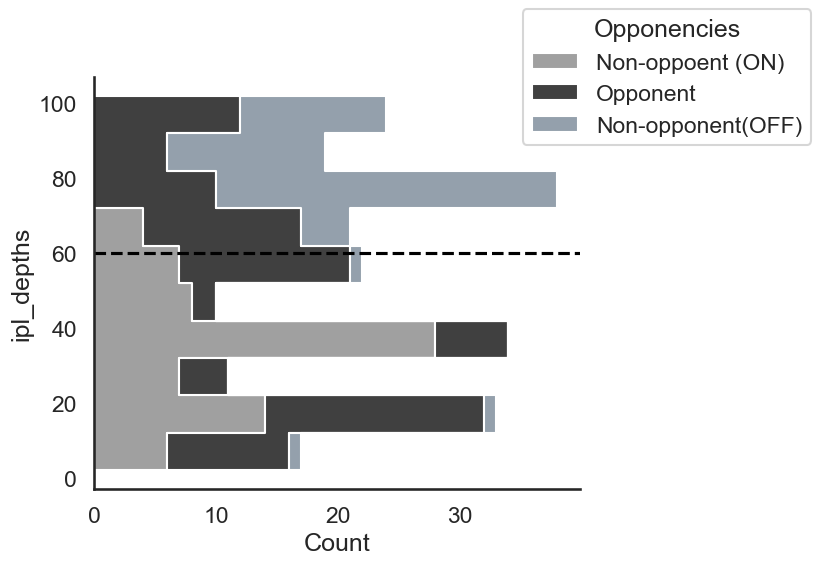

In [ ]:
fig, ax = plt.subplots(1, 1, figsize = (10, 6), sharex=True, sharey=True)
label_list = ["long_opp", "mid_opp", "short_opp"]
sns.histplot(data = chroma_df.query(f"non_opp_pol != 2"), y = "ipl_depths", element = "step", 
multiple = "stack", binwidth = 10, hue = "non_opp_pol", palette=["slategrey", "black", "grey"])
plt.legend(["Non-oppoent (ON)", "Opponent", "Non-opponent(OFF)"], title = "Opponencies")
sns.move_legend(ax, 'center right', bbox_to_anchor=(1.5, 1))
ax.axhline(60, c = "black", ls = "--")
plt.tight_layout()
# plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\chromatic_opponency_by_IPL_dist2.svg")

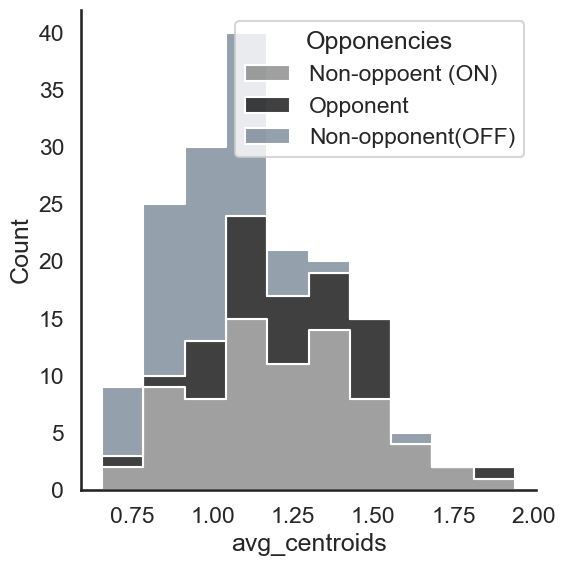

In [ ]:
fig, ax = plt.subplots(1, 1, figsize = (6, 6), sharex=True, sharey=True)
label_list = ["long_opp", "mid_opp", "short_opp"]
sns.histplot(data = chroma_df.query(f"non_opp_pol != 2"), x = "avg_centroids", element = "step", 
multiple = "stack", hue = "non_opp_pol", palette=["slategrey", "black", "grey"])
plt.legend(["Non-oppoent (ON)", "Opponent", "Non-opponent(OFF)"], title = "Opponencies")

plt.tight_layout()
# plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\chromatic_opponency_by_IPL_dist2.svg")

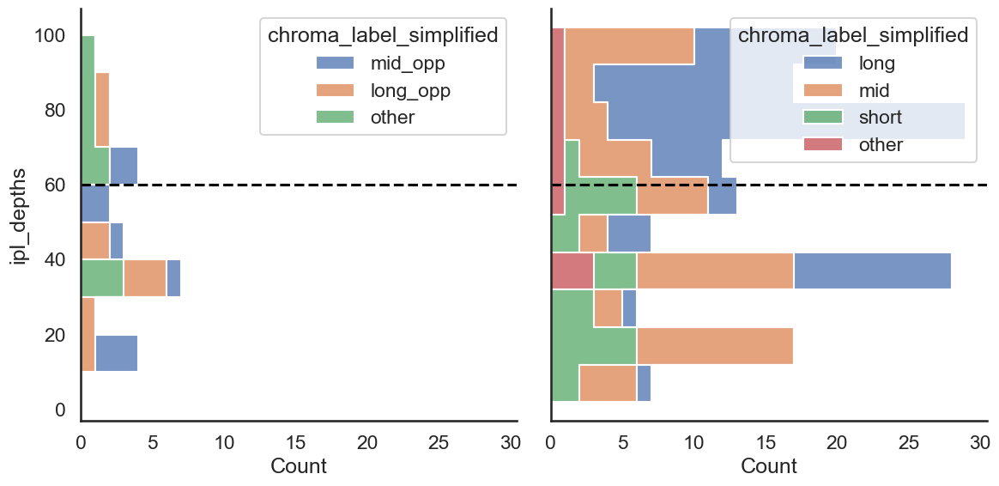

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (12, 6), sharex=True, sharey=True)

sns.histplot(data = chroma_df.query(f"chroma_label_simplified != 'non_resp' and chroma_label_simplified != 'long' and chroma_label_simplified != 'mid' and chroma_label_simplified != 'short'"), y = "ipl_depths", element = "step", 
multiple = "stack", binwidth = 10, hue = "chroma_label_simplified", ax = ax[0])
sns.histplot(data = chroma_df.query(f"chroma_label_simplified != 'non_resp' and chroma_label_simplified != 'long_opp' and chroma_label_simplified != 'mid_opp' and chroma_label_simplified != 'short_opp'"), y = "ipl_depths", element = "step", 
multiple = "stack", binwidth = 10, hue = "chroma_label_simplified", ax = ax[1])
# sns.move_legend(ax[0], 'center right', bbox_to_anchor=(1.5, 1))

for ax in ax:
    ax.axhline(60, c = "black", ls = "--")
plt.tight_layout()
#plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\chromatic_opponency_by_IPL_dist.svg")

In [ ]:
pd.unique(chroma_info["chroma_label"])

array(['long', 'blue', 'short', 'mid', 'mid_opp', 'long_opp', 'other',
       'short_opp', 'green', 'non_resp'], dtype=object)

In [ ]:
signal_analysis.

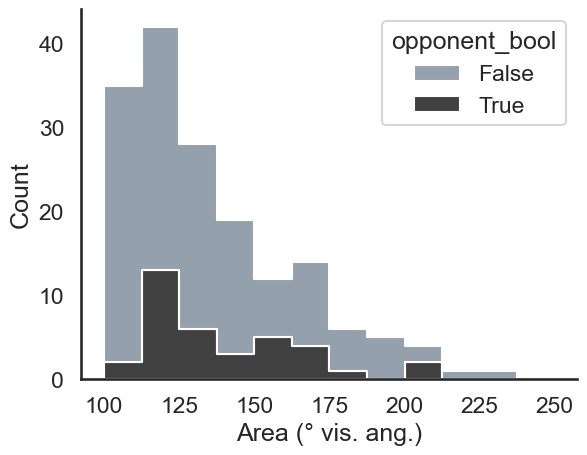

In [ ]:
sns.histplot(chroma_df, x = "avg_area", hue = "opponent_bool", multiple="stack", element = "step", binrange = (100, 250), palette=["slategray", "black"])
plt.xlabel("Area (° vis. ang.)")
plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Opponency plots\area_by_opponencybool.svg")


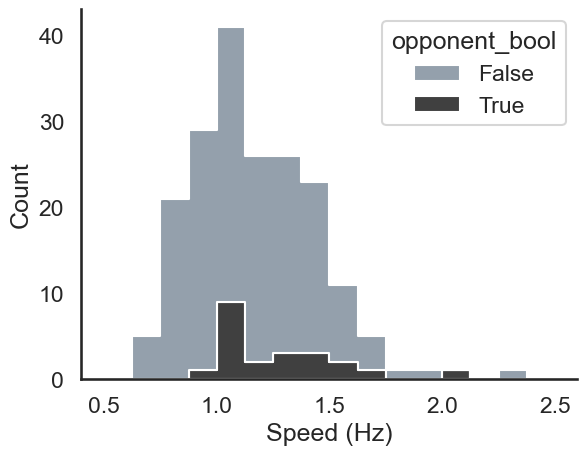

In [ ]:
sns.histplot(chroma_info, x = "avg_centroids", hue = "opponent_bool",  multiple="stack", element = "step", binrange=(.5, 2.5), palette=["slategray", "black"])
plt.xlabel("Speed (Hz)")
plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Opponency plots\speed_by_opponencybool.svg")

<Axes: xlabel='avg_area', ylabel='ipl_depths'>

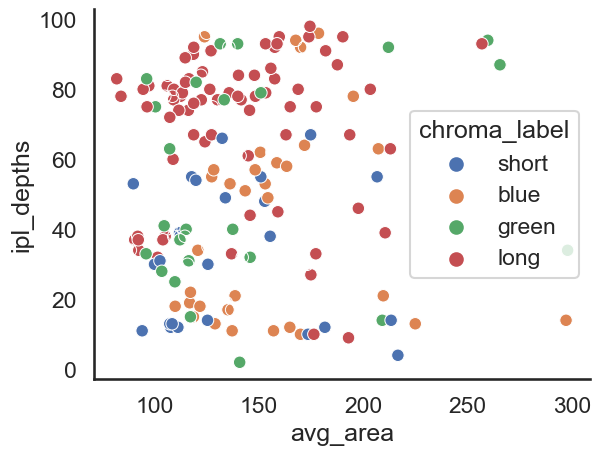

In [ ]:
sns.scatterplot(chroma_info, x = "avg_area", y = "ipl_depths", hue = "chroma_label", hue_order = ["short", "blue", "green", "long"])

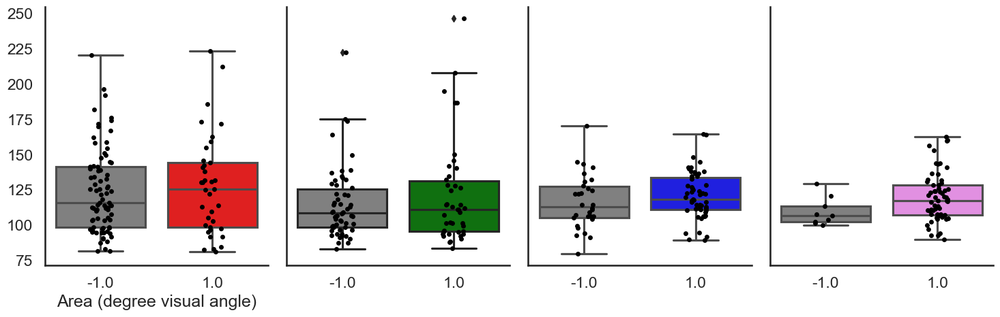

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.boxplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "contour_area_total", x = "polarities", ax = i, palette = ["grey", colours_name[n]], whis = 3)
    sns.stripplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "contour_area_total", x = "polarities", ax = i, color = "black")
    i.legend([], frameon = False)
    i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_xlabel("Area (degree visual angle)")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

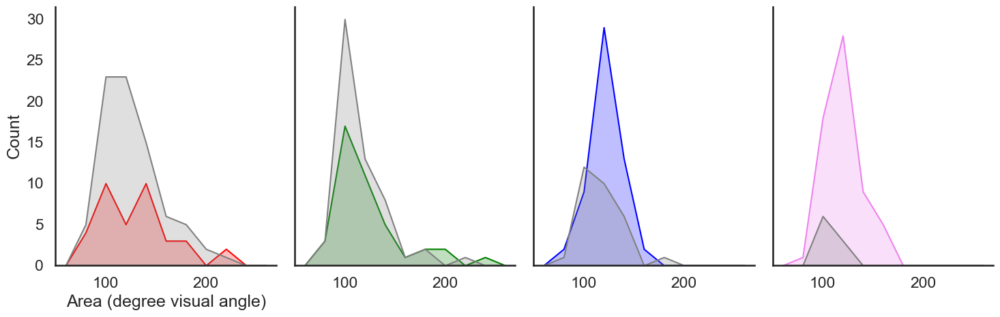

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True, sharex= True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    x = "contour_area_total", hue = "polarities", ax = i, palette = ["grey", colours_name[n]], element = "poly", binrange=(50, 255), binwidth=20)
    i.legend([], frameon = False)
    i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("Count")
ax[0].set_xlabel("Area (degree visual angle)")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

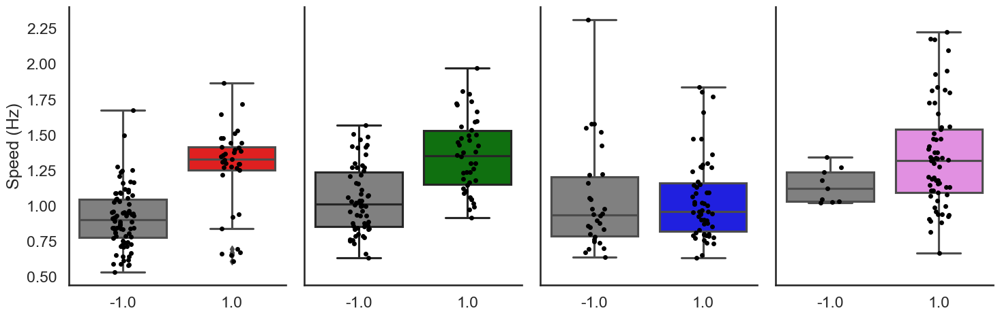

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.boxplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "dom_centroids", x = "polarities", ax = i, palette = ["grey", colours_name[n]], whis = 3)
    sns.stripplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "dom_centroids", x = "polarities", ax = i, color = "black")
    i.legend([], frameon = False)
    i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("Speed (Hz)")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

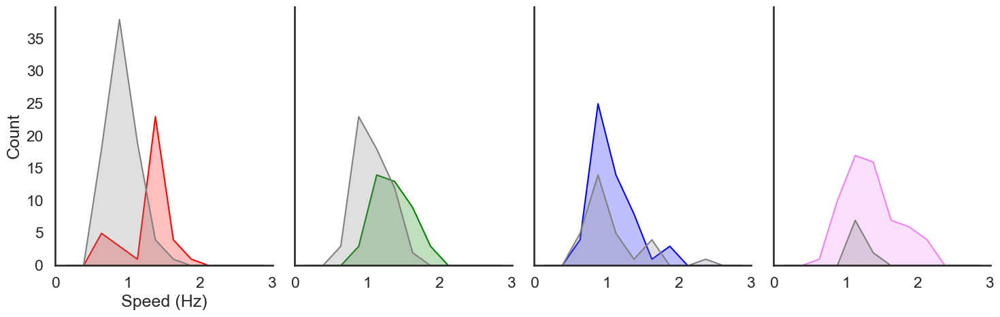

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    x = "dom_centroids", hue = "polarities", ax = i, palette = ["grey", colours_name[n]], element = "poly", binwidth=.25, binrange=(0, 3))
    i.legend([], frameon = False)
    i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("Count")
ax[0].set_xlabel("Speed (Hz)")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

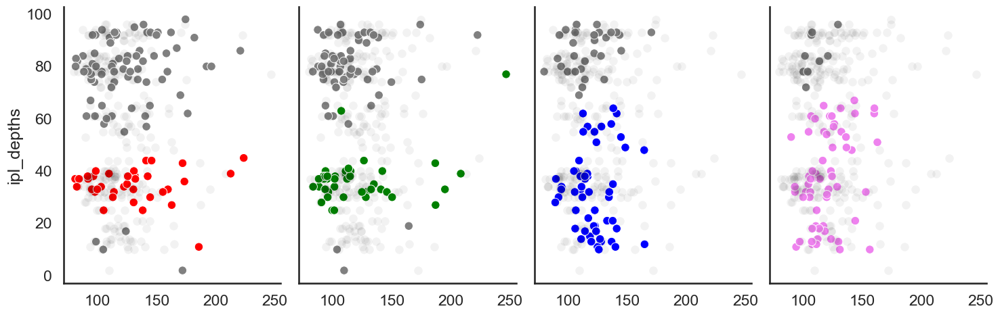

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True, sharex= True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.scatterplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "ipl_depths", x = "contour_area_total", hue = "polarities", ax = i, palette = ["grey", colours_name[n]])
    sns.scatterplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour != '{colours[n]}' & polarities != (2, 0)"),
    y = "ipl_depths", x = "contour_area_total", ax = i, color = "black", alpha = 0.05, linewidth = 0)
    i.legend([], frameon = False)
    # i.set_ylabel("")
    i.set_xlabel("")
# ax[0].set_ylabel("IPL depth")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

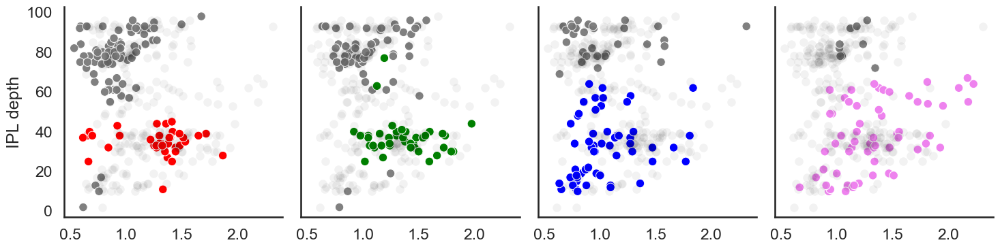

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 4), sharey = True, sharex = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.scatterplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "ipl_depths", x = "dom_centroids", hue = "polarities", ax = i, palette = ["grey", colours_name[n]])
    sns.scatterplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour != '{colours[n]}' & polarities != (2, 0)"),
    y = "ipl_depths", x = "dom_centroids", ax = i, color = "black", alpha = 0.05, linewidth = 0)
    i.legend([], frameon = False)
    # i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("IPL depth")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

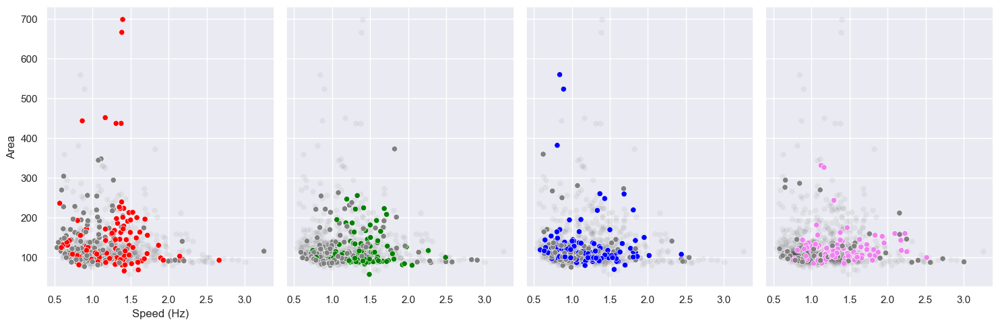

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True, sharex = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.scatterplot(data = chroma_rois_cleaned.query(f"colour != '{colours[n]}' & polarities != (2, 0)"),
    y = "contour_area_total", x = "dom_centroids", ax = i, color = "black", alpha = 0.05, linewidth = 0)
    sns.scatterplot(data = chroma_rois_cleaned.query(f"colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "contour_area_total", x = "dom_centroids", hue = "polarities", ax = i, palette = ["grey", colours_name[n]])
    i.legend([], frameon = False)
    # i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("Area")
ax[0].set_xlabel("Speed (Hz)")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_vs_speed.svg")

Text(0.5, 0, 'Area (° vis. ang.)')

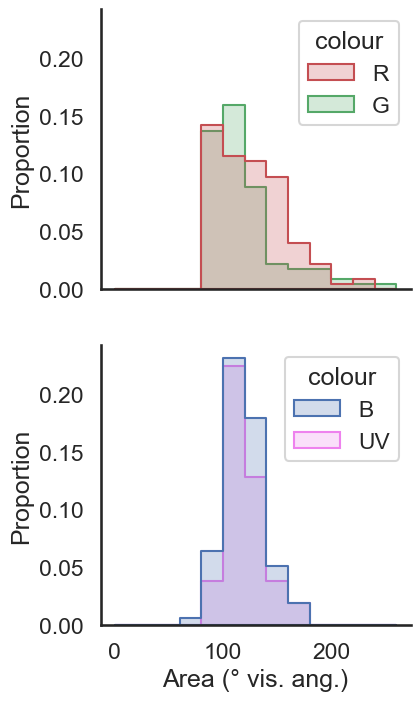

In [ ]:
fig, ax = plt.subplots(2, 1, sharex = True,  sharey = True, figsize = (4, 8))
colour_comp = [('R', 'G'), ('B', 'UV')]
comp_pallette = [["r", "g"], ["b","violet"]]
for n, i in enumerate(ax.flat):
    sns.histplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == {colour_comp[n]}"), ax = i,
    x = "contour_area_total", hue = "colour", palette = comp_pallette[n], element = "step", binrange = (0, 250), binwidth = 20, stat = "proportion")
    i.set_xlabel("")
ax[1].set_xlabel("Area (° vis. ang.)")
# fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\R_G_and_B_UV_area.svg")

Text(0.5, 0, 'Area (° vis. ang.)')

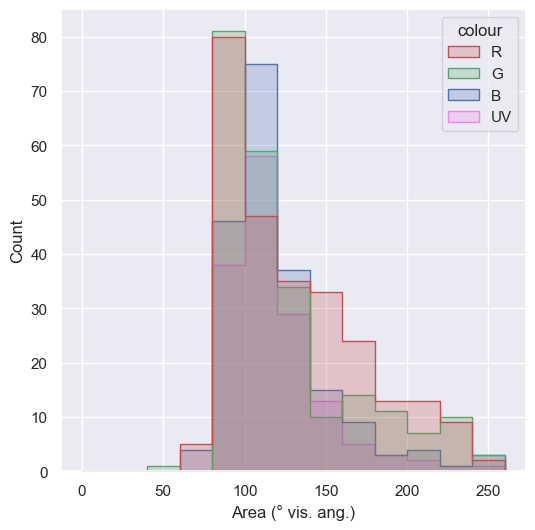

In [ ]:
fig, ax = plt.subplots(1, 1, sharex = True,  sharey = True, figsize = (6, 6))
sns.histplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == ('R', 'G', 'B', 'UV')"), ax = ax,
x = "contour_area_total", hue = "colour", palette = ["r", "g", "b","violet"], element = "step", binrange = (0, 250), binwidth = 20)
ax.set_xlabel("")
ax.set_xlabel("Area (° vis. ang.)")

Text(0.5, 0, 'Speed (Hz)')

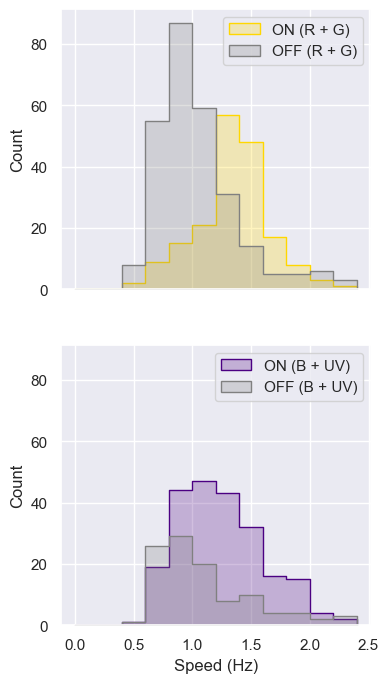

In [ ]:
fig, ax = plt.subplots(2, 1, sharex = True,  sharey = True, figsize = (4, 8))
colour_comp = [('R', 'G'), ('B', 'UV')]
label_list = ["R + G", "B + UV"]
comp_pallette = [["grey", "gold"], ["grey", "indigo"]]
for n, i in enumerate(ax.flat):
    sns.histplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & polarities != (2, 0) & colour == {colour_comp[n]}"), ax = i,
    x = "dom_centroids", hue = "polarities", palette = comp_pallette[n], element = "step", binwidth=.2, binrange=(0, 2.2))
    i.legend([f"ON ({label_list[n]})", f"OFF ({label_list[n]})"])
    i.set_xlabel("")
ax[1].set_xlabel("Speed (Hz)")
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\R+G_and_B+UV_speed.svg")

# Full search 

In [ ]:
files = filehandling.find_files_in(".h5", r"D:\Igor analyses", search_term = "25", recursive=True)
files

[WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5"),
 WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN0_BW_800_25%_v_1'.h5"),
 WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN0_R_400_25%_v_0'.h5"),
 WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN_BW_200_25%_h_0'.h5"),
 WindowsPath('D:/Igor analyses/220824/SMP_0_4_SWN_UV200_25p_0.h5'),
 WindowsPath('D:/Igor analyses/220825/SMP_0_0_SWN200_25p_R_0.h5'),
 WindowsPath('D:/Igor analyses/230502/2023-5-2_SMP_0_0_SWN_UV_25_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP_0_0_SWN200_25p_R_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP_0_0_SWN200_25p_UV_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP_0_10_SWN200_25p_R_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP_0_10_SWN200_25p_UV_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP_0_11_SWN200_25p_R_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP_0_11_SWN200_25p_UV_0.h5'),
 WindowsPath('D:/Igor analyses/H5 exports/SMP

In [ ]:
roi_df, rec_df = filehandling.compile_strf_df(files);
roi_df

Current file: D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:953: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5
  loaded = load_strf_data(i)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 17.664488949361154)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 14.527531515162059)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 8.788536920311916)
  contour_lower, contour_upper = _d

Current file: D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_800_25%_v_1'.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:953: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_800_25%_v_1'.h5
  loaded = load_strf_data(i)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 10.393928159846414)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 9.37322214792567)
  contour_lower, contour_upper = _draw_con

Current file: D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_R_400_25%_v_0'.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:953: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_R_400_25%_v_0'.h5
  loaded = load_strf_data(i)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 5.28830593329616)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)


Current file: D:\Igor analyses\220803\2022-8-3_'SMP_SWN_BW_200_25%_h_0'.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:953: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\220803\2022-8-3_'SMP_SWN_BW_200_25%_h_0'.h5
  loaded = load_strf_data(i)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 12.580901728812403)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 5.803336548273726)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 7.430669233169884)
  contour_lower, contour_upper = _dra

Current file: D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:953: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_0.h5
  loaded = load_strf_data(i)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\220825\SMP_0_0_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:953: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\220825\SMP_0_0_SWN200_25p_R_0.h5
  loaded = load_strf_data(i)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 5.73399255795554)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 2.2643428107048336)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Us

Current file: D:\Igor analyses\230502\2023-5-2_SMP_0_0_SWN_UV_25_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 4.151217116945835)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 4.382014946024355)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data

Current file: D:\Igor analyses\H5 exports\SMP_0_0_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 5.1727265972607555)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 2.6411831804442936)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 4.515769294596242)
  contour_lower, contour_upper =

Current file: D:\Igor analyses\H5 exports\SMP_0_0_SWN200_25p_UV_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\H5 exports\SMP_0_10_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\H5 exports\SMP_0_10_SWN200_25p_UV_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\H5 exports\SMP_0_11_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 2.5040888858287498)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 3.529170985372095)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, dat

Current file: D:\Igor analyses\H5 exports\SMP_0_11_SWN200_25p_UV_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 2.163937416789472)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(w

Current file: D:\Igor analyses\H5 exports\SMP_0_1_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 2.6221253644552136)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 3.692390431440299)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Lower contour did not pass arithmetic threshold criteria (half abs-max = 3.344378582137904)
  contour_lower, contour_upper = 

Current file: D:\Igor analyses\H5 exports\SMP_0_1_SWN200_25p_UV_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\H5 exports\SMP_0_2_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 4.134377003257127)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 2.800086635908962)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data

Current file: D:\Igor analyses\H5 exports\SMP_0_6_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\H5 exports\SMP_0_6_SWN200_25p_UV_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


Current file: D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p_R_0.h5


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 2.570966345919067)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(w

Current file: D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p_UV_0.h5
The following files are missing key 'Positions' resulting in np.nan for 'ipl_depths':
 
 [WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5")
 WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN0_BW_800_25%_v_1'.h5")
 WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN0_R_400_25%_v_0'.h5")
 WindowsPath("D:/Igor analyses/220803/2022-8-3_'SMP_SWN_BW_200_25%_h_0'.h5")
 WindowsPath('D:/Igor analyses/220824/SMP_0_4_SWN_UV200_25p_0.h5')
 WindowsPath('D:/Igor analyses/220825/SMP_0_0_SWN200_25p_R_0.h5')]


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:806: RuntimeWarning: Mean of empty slice
  dict["contour_complexity"] = np.nanmean(contouring.complexity_weighted(data_strf_obj.contours, data_strf_obj.contours_area()), axis = 1)
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\scipy\stats\_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


,ipl_depths,strf_keys,multicolour,roi,date,path,filename,colour,simultaneous,combo,...,dom_biphasic_index,pols_corr,neg_auc,pos_auc,neg_peaktime,pos_peaktime,dom_peaktime,neg_centroids,pos_centroids,dom_centroids
0,NaN,STRF0_0,False,0,2022-08-03,D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_...,2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5,BW,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
1,NaN,STRF0_1,False,1,2022-08-03,D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_...,2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5,BW,n,NaN,...,-0.805035,NaN,-17.718057,NaN,7,0,7,1.659654,NaN,1.659654
2,NaN,STRF0_2,False,2,2022-08-03,D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_...,2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5,BW,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
3,NaN,STRF0_3,False,3,2022-08-03,D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_...,2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5,BW,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
4,NaN,STRF0_4,False,4,2022-08-03,D:\Igor analyses\220803\2022-8-3_'SMP_SWN0_BW_...,2022-8-3_'SMP_SWN0_BW_400_25%_v_0'.h5,BW,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
309,58.0,STRF0_17,False,17,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_UV_0.h5,UV,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
310,74.0,STRF0_18,False,18,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_UV_0.h5,UV,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
311,34.0,STRF0_19,False,19,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_UV_0.h5,UV,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN
312,63.0,STRF0_20,False,20,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_UV_0.h5,UV,n,NaN,...,0.000000,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN


In [ ]:
index = 311
test_load = filehandling.load_strf_by_df_index(roi_df, index)
roi = roi_df["roi"][index]
plotting.play_movie(test_load.strfs[roi])

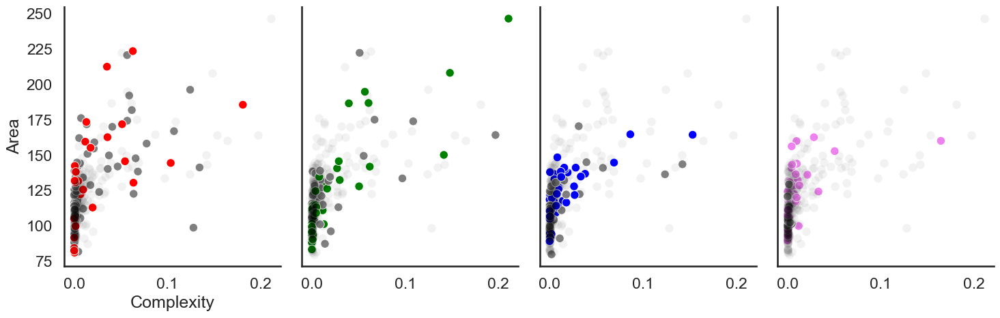

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True, sharex = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.scatterplot(data = chroma_rois_cleaned.query(f"colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "contour_area_total", x = "contour_complexity", hue = "polarities", ax = i, palette = ["grey", colours_name[n]])
    sns.scatterplot(data = chroma_rois_cleaned.query(f"colour != '{colours[n]}' & polarities != (2, 0)"),
    y = "contour_area_total", x = "contour_complexity", ax = i, color = "black", alpha = 0.05, linewidth = 0)
    i.legend([], frameon = False)
    # i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("Area")
ax[0].set_xlabel("Complexity")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

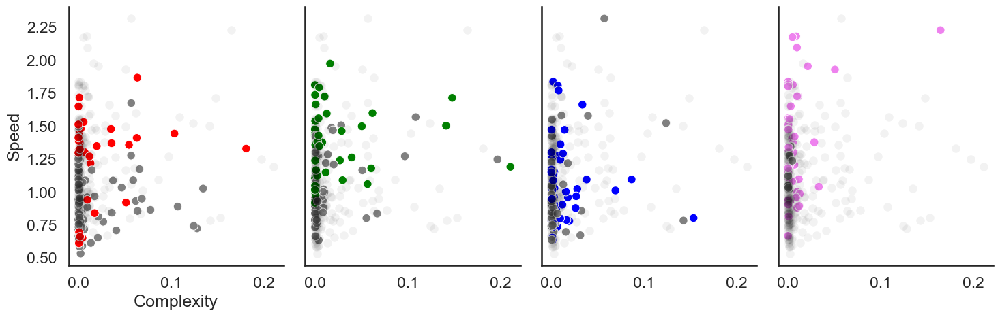

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 5), sharey = True, sharex = True)

 #“layer”, “dodge”, “stack”, “fill”

colours = ["R", "G", "B", "UV"]
colours_name = ["red", "green", "blue", "violet"]
for n, i in enumerate(ax):
    sns.scatterplot(data = chroma_rois_cleaned.query(f"colour == '{colours[n]}' & polarities != (2, 0)"),
    y = "dom_centroids", x = "contour_complexity", hue = "polarities", ax = i, palette = ["grey", colours_name[n]])
    sns.scatterplot(data = chroma_rois_cleaned.query(f"colour != '{colours[n]}' & polarities != (2, 0)"),
    y = "dom_centroids", x = "contour_complexity", ax = i, color = "black", alpha = 0.05, linewidth = 0)
    i.legend([], frameon = False)
    # i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_ylabel("Speed")
ax[0].set_xlabel("Complexity")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

In [ ]:
chroma_rois_cleaned.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'neg_extrema', 'pos_extrema',
       'neg_biphasic_index', 'pos_biphasic_index', 'pols_corr', 'neg_auc',
       'pos_auc', 'neg_peaktime', 'pos_peaktime', 'neg_contour_count',
       'pos_contour_count', 'total_contour_count', 'neg_contour_areas',
       'pos_contour_areas', 'neg_contour_area_total', 'pos_contour_area_total',
       'contour_area_total', 'contour_complexity', 'polarities',
       'neg_centroids', 'pos_centroids', 'dom_centroids', 'cell_id'],
      dtype='object')

In [ ]:

test_path = r"D:\Igor analyses\230613\0_1_ColorSWN_200_0\2023-6-13_0_1_ColourSWN_200_0.h5"
loadfile = filehandling.load_strf_data(test_path)

C:\Users\SimenLab\AppData\Local\Temp\ipykernel_24376\531283413.py:2: UserWarning: Rotation detected and corrected for D:\Igor analyses\230613\0_1_ColorSWN_200_0\2023-6-13_0_1_ColourSWN_200_0.h5
  loadfile = filehandling.load_strf_data(test_path)


In [ ]:
np.where(chroma_rois["neg_contour_area_total"] > chroma_rois["pos_contour_area_total"], chroma_rois["neg_centroids"],  chroma_rois["pos_centroids"])

array([0.84878931, 0.80323811,        nan, ...,        nan,        nan,
              nan])

In [ ]:
fig, ax = plt.subplots(1, 8, figsize = (15, 5), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.tile(["OFF", "ON"], 4)
colours = np.repeat(["R", "G", "B", "UV"], 2)
colours_name = ["grey", "red", "grey", "green", "grey", "blue", "grey", "violet"]

for n, i in enumerate(ax):
    sns.boxplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}'"),
    y = "contour_area_total", ax = i, color = colours_name[n], whis = 3, fliersize=0)
    sns.stripplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}'"),
    y = "contour_area_total", ax = i, color = "black", alpha = 0.5)
    i.legend([], frameon = False)
    i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_xlabel("Area (° vis. ang.)")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

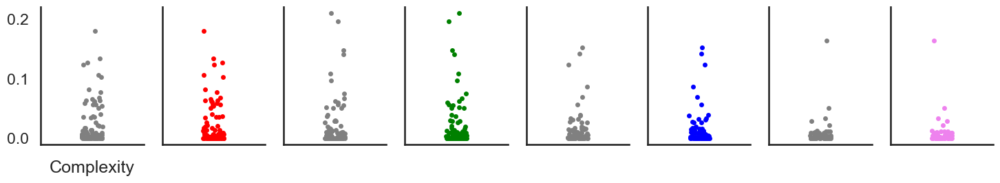

In [ ]:
fig, ax = plt.subplots(1, 8, figsize = (15, 3), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.tile(["OFF", "ON"], 4)
colours = np.repeat(["R", "G", "B", "UV"], 2)
colours_name = ["grey", "red", "grey", "green", "grey", "blue", "grey", "violet"]
for n, i in enumerate(ax):
    sns.stripplot(data = chroma_rois_cleaned.query(f"contour_area_total > 0 & colour == '{colours[n]}'"),
    y = "contour_complexity", ax = i, color = colours_name[n])
    i.legend([], frameon = False)
    # i.set_title(colours[n] + " " +titles[n])
    i.set_ylabel("")
    i.set_xlabel("")
ax[0].set_xlabel("Complexity")
fig.tight_layout()
#fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

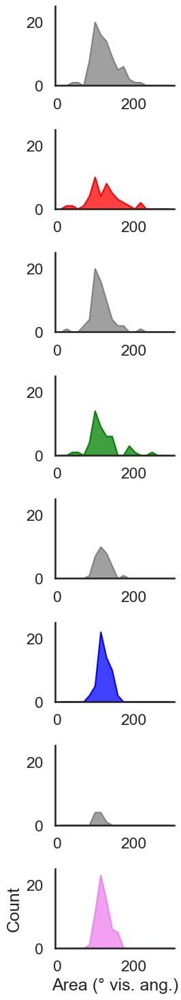

In [ ]:
fig, ax = plt.subplots(8, 1, figsize = (3, 15), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.tile(["OFF", "ON"], 4)
colours = np.repeat(["R", "G", "B", "UV"], 2)
colours_name = ["grey", "red", "grey", "green", "grey", "blue", "grey", "violet"]
y_axis = np.tile(["neg_contour_area_total", "pos_contour_area_total"], 4)
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois.query(f"total_contour_count > 0 & colour == '{colours[n]}'"), x = y_axis[n], element = "poly",
    ax = i, color = colours_name[n], multiple = "layer", binrange = (1, 300), binwidth = 15)
    i.legend([], frameon = False)
    # i.set_title(colours[n] + " " +titles[n])
    i.set_ylim(0, 25)
    if n != len(ax)-1:
        i.set_ylabel("")
        i.set_xlabel("")
ax[-1].set_xlabel("Area (° vis. ang.)")
fig.tight_layout()
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\area_distributions.svg")

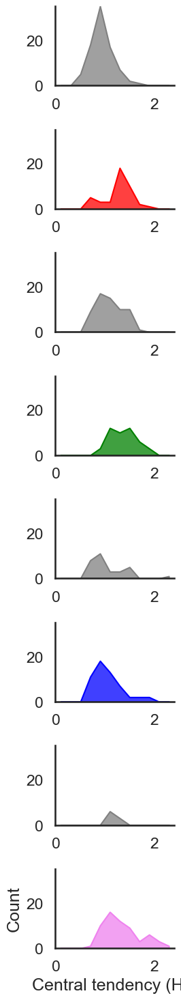

In [ ]:
fig, ax = plt.subplots(8, 1, figsize = (3, 15), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.tile(["OFF", "ON"], 4)
colours = np.repeat(["R", "G", "B", "UV"], 2)
colours_name = ["grey", "red", "grey", "green", "grey", "blue", "grey", "violet"]
y_axis = np.tile(["neg_centroids", "pos_centroids"], 4)
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois.query(f"total_contour_count > 0 & colour == '{colours[n]}'"), x = y_axis[n], element = "poly",
    ax = i, color = colours_name[n], multiple = "layer",  binrange = (0, 2.3), binwidth = .2)
    i.legend([], frameon = False)
    # i.set_title(colours[n] + " " +titles[n])
    i.set_ylim(0, 35)
    if n != len(ax)-1:
        i.set_ylabel("")
        i.set_xlabel("")
fig.tight_layout()
ax[-1].set_xlabel("Central tendency (Hz)")
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\centroids_distributions.svg")

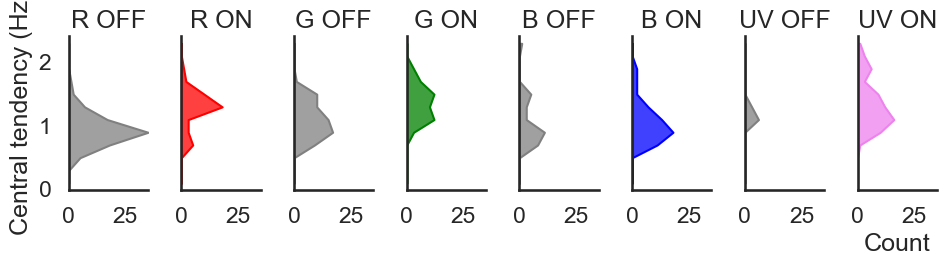

In [ ]:
fig, ax = plt.subplots(1, 8, figsize = (10, 3), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.tile(["OFF", "ON"], 4)
colours = np.repeat(["R", "G", "B", "UV"], 2)
# colours_name = ["darkred", "darkgreen", "darkblue", "darkviolet", "r", "g", "b", "violet"]
colours_name = ["grey", "red", "grey", "green", "grey", "blue", "grey", "violet"]
y_axis = np.tile(["neg_centroids", "pos_centroids"], 4)
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois.query(f"total_contour_count > 0 & colour == '{colours[n]}'"), y = y_axis[n], element = "poly",
    ax = i, color = colours_name[n], multiple = "layer", binrange = (0, 2.2), binwidth = .2)
    i.legend([], frameon = False)
    i.set_title(colours[n] + " " +titles[n])
    i.set_xlim(0, 35)
    if n != len(ax)-1:
        i.set_ylabel("")
        i.set_xlabel("")
ax[0].set_ylabel("Central tendency (Hz)")
fig.tight_layout()
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\centroids_distributions_alternative.svg")

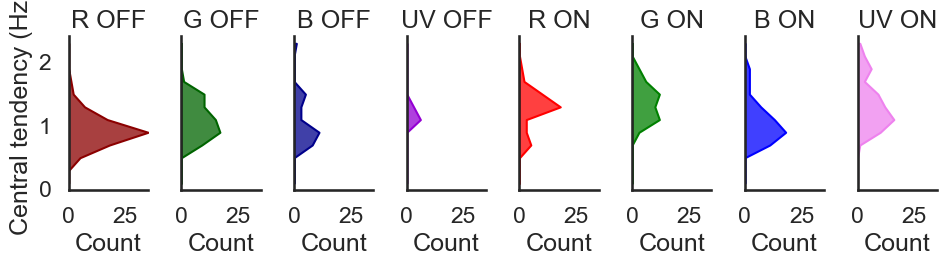

In [ ]:
fig, ax = plt.subplots(1, 8, figsize = (10, 3), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.repeat(["OFF", "ON"], 4)
colours = np.tile(["R", "G", "B", "UV"], 2)
colours_name = ["darkred", "darkgreen", "darkblue", "darkviolet", "red", "green", "blue", "violet"]
y_axis = np.repeat(["neg_centroids", "pos_centroids"], 4)
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois.query(f"total_contour_count > 0 & colour == '{colours[n]}'"), y = y_axis[n], element = "poly",
    ax = i, color = colours_name[n], multiple = "layer", binrange = (0, 2.2), binwidth = .2)
    i.legend([], frameon = False)
    i.set_title(colours[n] + " " +titles[n])
    i.set_xlim(0, 35)
ax[0].set_ylabel("Central tendency (Hz)")
fig.tight_layout()


In [ ]:
fig, ax = plt.subplots(1, 8, figsize = (10, 3), sharey = True)

 #“layer”, “dodge”, “stack”, “fill”
titles = np.tile(["OFF", "ON"], 4)
colours = np.repeat(["R", "G", "B", "UV"], 2)
# colours_name = ["darkred", "darkgreen", "darkblue", "darkviolet", "r", "g", "b", "violet"]
colours_name = ["grey", "red", "grey", "green", "grey", "blue", "grey", "violet"]
y_axis = np.tile(["neg_centroids", "pos_centroids"], 4)
for n, i in enumerate(ax):
    sns.histplot(data = chroma_rois.query(f"total_contour_count > 0 & colour == '{colours[n]}'"), y = y_axis[n], element = "poly",
    ax = i, color = colours_name[n], multiple = "layer", binrange = (0, 2.2), binwidth = .2)
    i.legend([], frameon = False)
    i.set_title(colours[n] + " " +titles[n])
    i.set_xlim(0, 35)
ax[0].set_ylabel("Central tendency (Hz)")
fig.tight_layout()


In [ ]:
chroma_rois.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'polarities', 'neg_centroids',
       'pos_centroids', 'neg_extrema', 'pos_extrema', 'neg_biphasic_index',
       'pos_biphasic_index', 'pols_corr', 'neg_auc', 'pos_auc', 'neg_peaktime',
       'pos_peaktime', 'neg_contour_count', 'pos_contour_count',
       'total_contour_count', 'neg_contour_areas', 'pos_contour_areas',
       'neg_contour_area_total', 'pos_contour_area_total',
       'contour_area_total', 'contour_complexity'],
      dtype='object')

In [ ]:
pd.unique(chroma_rois["size"])

array([200], dtype=int64)

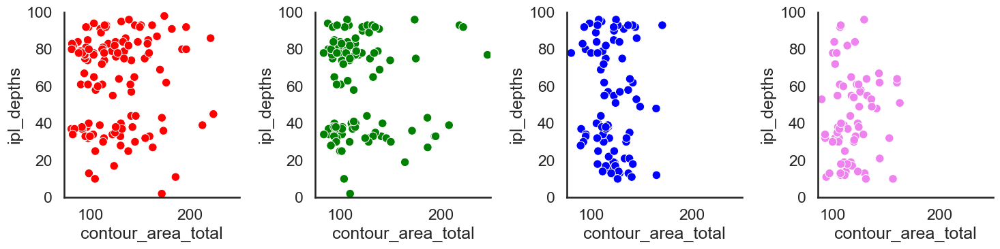

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 4))
colours = np.tile(["R", "G", "B", "UV"], 2)
x_axis = np.repeat(["contour_area_total"], 4)
for n, curr_ax in enumerate(ax.flat):
    sns.scatterplot(data = chroma_rois.query(f"contour_area_total > 0 & colour == '{colours[n]}'"), x = "contour_area_total", y = "ipl_depths", hue = "colour", 
    palette = chromatic_palette, hue_order=chromatic_hues, ax = curr_ax)
    curr_ax.set_xlim(right = 250)
    curr_ax.set_ylim(0, 100)
for ax in ax.flat:
    ax.legend([], [], frameon=False)
fig.tight_layout()

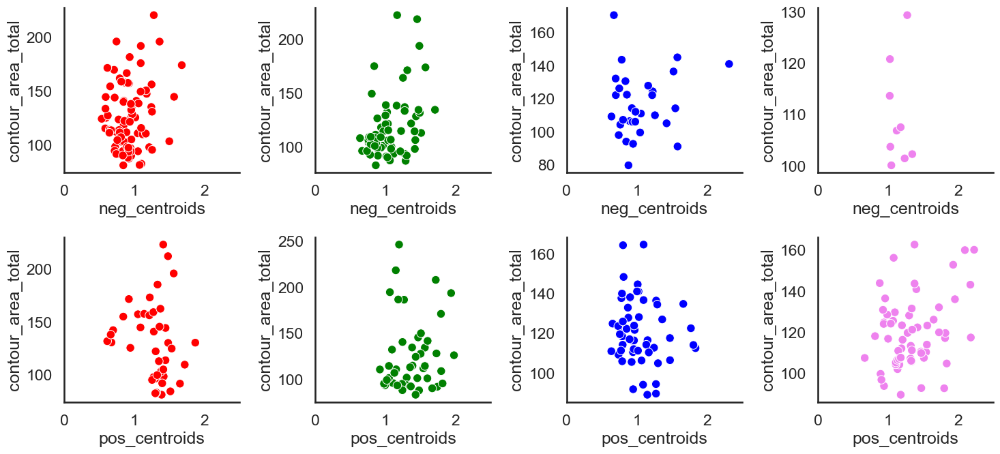

In [ ]:
fig, ax = plt.subplots(2, 4, figsize = (15, 7))
colours = np.tile(["R", "G", "B", "UV"], 2)
x_axis = np.repeat(["neg_centroids", "pos_centroids"], 4)
y_axis = np.repeat(["contour_area_total", "contour_area_total"], 4)
for n, curr_ax in enumerate(ax.flat):
    sns.scatterplot(data = chroma_rois.query(f"contour_area_total > 0 & colour == '{colours[n]}'"), y = y_axis[n], x = x_axis[n], hue = "colour", 
    palette = chromatic_palette, hue_order=chromatic_hues, ax = curr_ax)
    curr_ax.set_xlim(0, 2.5)
for ax in ax.flat:
    ax.legend([], [], frameon=False)
fig.tight_layout()

In [ ]:
chroma_rois.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'polarities', 'neg_centroids',
       'pos_centroids', 'neg_extrema', 'pos_extrema', 'neg_biphasic_index',
       'pos_biphasic_index', 'pols_corr', 'neg_auc', 'pos_auc', 'neg_peaktime',
       'pos_peaktime', 'neg_contour_count', 'pos_contour_count',
       'total_contour_count', 'neg_contour_areas', 'pos_contour_areas',
       'neg_contour_area_total', 'pos_contour_area_total',
       'contour_area_total', 'contour_complexity'],
      dtype='object')

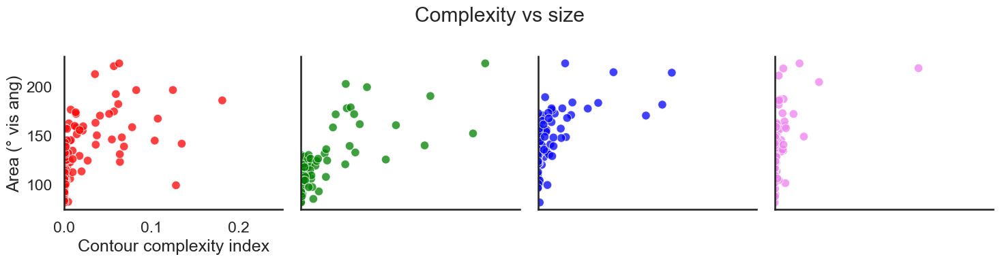

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 4))
colours = np.tile(["R", "G", "B", "UV"], 2)

for n, curr_ax in enumerate(ax.flat):
    # Reference datat from pop
    # sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "contour_area_total", x = "neg_centroids", ax = curr_ax, color = ["gainsboro"], alpha = .33, linewidth = 0)
    # sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "contour_area_total", x = "pos_centroids", ax = curr_ax, color = ["gainsboro"], alpha = .33, linewidth = 0)
    # Per colour and polarity
    sns.scatterplot(data = chroma_rois.query(f"contour_area_total > 0 & colour == '{colours[n]}'"), y = "contour_area_total", x = "contour_complexity", hue = "colour", 
    palette = chromatic_palette, hue_order=chromatic_hues, ax = curr_ax, alpha = 0.75)
    # sns.scatterplot(data = uv_strfs.query("contour_area_total > 0"), y = "contour_area_total", x = "pos_centroids", hue = "colour", 
    # palette = chromatic_palette, hue_order=chromatic_hues, ax = curr_ax.flat[0])
    curr_ax.set_xlim(0, 0.25)
    if n != 0:
        curr_ax.set_ylabel("")
        curr_ax.set_xlabel("")
        curr_ax.set_xticks([])
        curr_ax.set_yticks([])
for cax in ax.flat:
    cax.legend([], [], frameon=False)
fig.suptitle("Complexity vs size")
ax[0].set_xlabel("Contour complexity index")
ax[0].set_ylabel("Area (° vis ang)")
fig.tight_layout()
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\complexity_vs_size.svg")

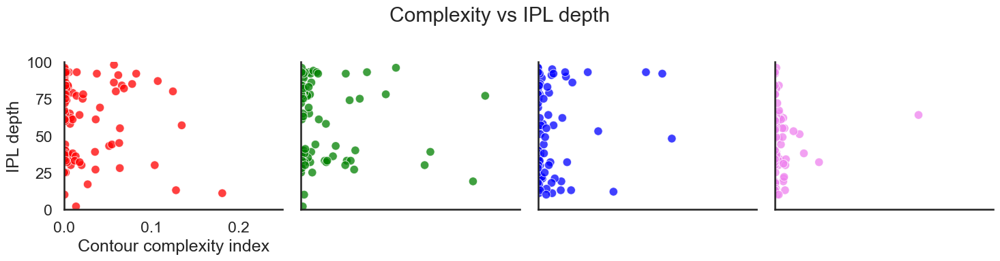

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15, 4))
colours = np.tile(["R", "G", "B", "UV"], 2)

for n, curr_ax in enumerate(ax.flat):
    # Reference datat from pop
    # sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "contour_area_total", x = "neg_centroids", ax = curr_ax, color = ["gainsboro"], alpha = .33, linewidth = 0)
    # sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "contour_area_total", x = "pos_centroids", ax = curr_ax, color = ["gainsboro"], alpha = .33, linewidth = 0)
    # Per colour and polarity
    sns.scatterplot(data = chroma_rois.query(f"contour_area_total > 0 & colour == '{colours[n]}'"), y = "ipl_depths", x = "contour_complexity", hue = "colour", 
    palette = chromatic_palette, hue_order=chromatic_hues, ax = curr_ax, alpha = 0.75)
    # sns.scatterplot(data = uv_strfs.query("contour_area_total > 0"), y = "contour_area_total", x = "pos_centroids", hue = "colour", 
    # palette = chromatic_palette, hue_order=chromatic_hues, ax = curr_ax.flat[0])
    curr_ax.set_ylim(bottom=0,top = 100)
    curr_ax.set_xlim(0, 0.25)
    if n != 0:
        curr_ax.set_ylabel("")
        curr_ax.set_xlabel("")
        curr_ax.set_xticks([])
        curr_ax.set_yticks([])
for cax in ax.flat:
    cax.legend([], [], frameon=False)
ax[0].set_xlabel("Contour complexity index")
ax[0].set_ylabel("IPL depth")
fig.suptitle("Complexity vs IPL depth")
fig.tight_layout()
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\IPL_vs_complexity.svg")


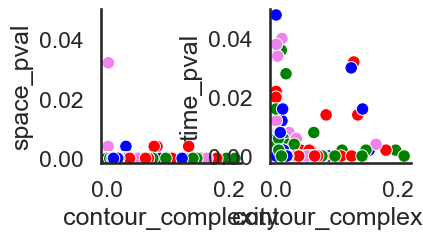

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (4, 2))
sns.scatterplot(data = chroma_rois.query(f"contour_area_total > 0"), y = "space_pval", x = "contour_complexity", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[0])
sns.scatterplot(data = chroma_rois.query(f"contour_area_total > 0"), y = "time_pval", x = "contour_complexity", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[1])
for n, i in enumerate(ax):
    i.legend([], [], frameon = False)
    i.set_ylim(top = 0.05)
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\ERM 2023\Chromaticity graphs\complexity_vs_contour_complexity.svg")


In [ ]:
chroma_rois.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'polarities', '-centroids', '+centroids',
       '-extrema', '+extrema', '-biphasic_index', '+biphasic_index',
       'pols_corr', '-auc', '+auc', '-peaktime', '+peaktime', '-contour_count',
       '+contour_count', 'total_contour_count', '-contour_areas',
       '+contour_areas', '-contour_area_total', '+contour_area_total',
       'contour_area_total', 'contour_complexity'],
      dtype='object')

<Axes: xlabel='+centroids', ylabel='Count'>

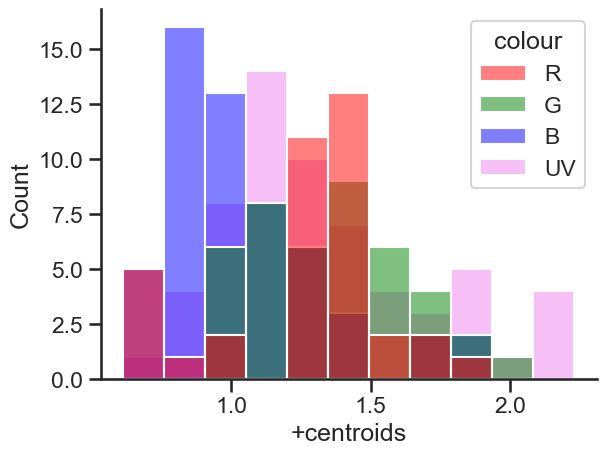

In [ ]:
#fig, ax = plt.subplots(1, 2, figsize = (10, 4))
sns.histplot(data = chroma_rois.query("contour_area_total > 0 & polarities == 1"), x = "+centroids", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues)


In [ ]:
chroma_rois.query("contour_area_total > 0")

,ipl_depths,strf_keys,multicolour,roi,date,path,filename,colour,simultaneous,combo,...,+peaktime,-contour_count,+contour_count,total_contour_count,-contour_areas,+contour_areas,-contour_area_total,+contour_area_total,contour_area_total,contour_complexity
0,74.0,STRF0_0_0,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,0,1,0,1,[565.6255160074506],[0.0],565.625516,0.000000,565.625516,0.002745
1,74.0,STRF0_0_1,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,G,n,NaN,...,0,1,0,1,[598.4346293480013],[0.0],598.434629,0.000000,598.434629,0.055559
10,48.0,STRF0_2_2,True,2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,B,n,NaN,...,13,0,1,1,[0.0],[657.9812586322907],0.000000,657.981259,657.981259,0.153254
11,48.0,STRF0_2_3,True,2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,UV,n,NaN,...,15,0,1,1,[0.0],[564.2987595392585],0.000000,564.298760,564.298760,0.004516
16,90.0,STRF0_4_0,True,4,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,0,1,0,1,[444.80072781089234],[0.0],444.800728,0.000000,444.800728,0.000880
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1005,92.0,STRF0_17_1,True,17,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,G,n,NaN,...,0,1,0,1,[538.4832269039246],[0.0],538.483227,0.000000,538.483227,0.019493
1006,92.0,STRF0_17_2,True,17,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,B,n,NaN,...,0,1,0,1,[488.87602743219406],[0.0],488.876027,0.000000,488.876027,0.017796
1013,30.0,STRF0_19_1,True,19,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,G,n,NaN,...,16,0,1,1,[0.0],[436.5928276263131],0.000000,436.592828,436.592828,0.004553
1017,83.0,STRF0_20_1,True,20,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,G,n,NaN,...,0,1,0,1,[404.54828580980546],[0.0],404.548286,0.000000,404.548286,0.008768


C:\Users\SimenLab\AppData\Local\Temp\ipykernel_24376\644499398.py:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "ipl_depths", x = "neg_centroids", ax = ax[0], palette = "Greys_r", alpha = .25)
C:\Users\SimenLab\AppData\Local\Temp\ipykernel_24376\644499398.py:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "ipl_depths", x = "pos_centroids", ax = ax[1], palette = "Greys_r", alpha = .25)


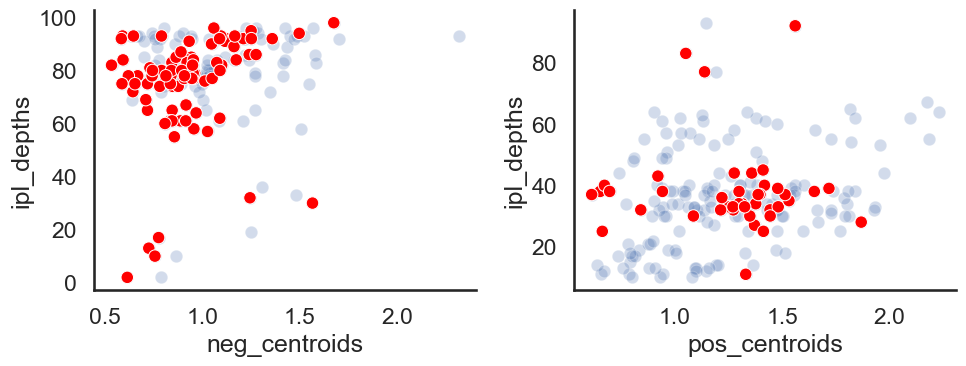

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (10, 4))
# reference
sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "ipl_depths", x = "neg_centroids", ax = ax[0], palette = "Greys_r", alpha = .25)
sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "ipl_depths", x = "pos_centroids", ax = ax[1], palette = "Greys_r", alpha = .25)


sns.scatterplot(data = r_strfs.query("contour_area_total > 0"), y = "ipl_depths", x = "neg_centroids", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[0])
sns.scatterplot(data = r_strfs.query("contour_area_total > 0"), y = "ipl_depths", x = "pos_centroids", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[1])

for ax in ax:
    ax.legend([], [], frameon=False)
    # ax.set_ylim(200, 1000)
    # ax.set_xlim(0, 2)
fig.tight_layout()

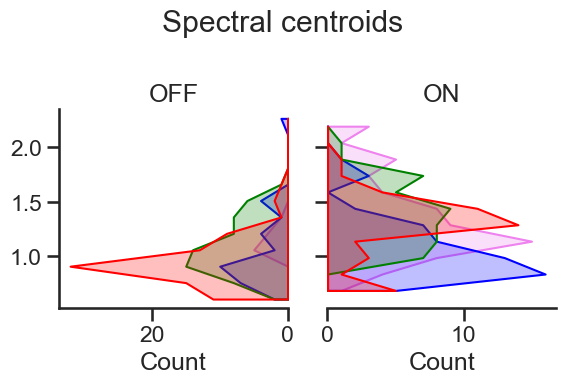

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (6, 4), sharey = True)

sns.histplot(data = chroma_rois.query("total_contour_count > 0"), y ="-centroids", hue = "colour", element = "poly",
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[0], binwidth = .15, multiple = "layer")
sns.histplot(data = chroma_rois.query("total_contour_count > 0"), y ="+centroids", hue = "colour", element = "poly",
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[1], binwidth = .15, multiple = "layer") #“layer”, “dodge”, “stack”, “fill”
titles = ["OFF", "ON"]
for n, i in enumerate(ax):
    i.legend([], frameon = False)
    i.set_title(titles[n])
ax[0].invert_xaxis()
ax[0].set_ylabel("")
#ax[1].yaxis.set_label_position("right")
ax[1].spines[['left']].set_visible(False)
plt.suptitle("Spectral centroids")
fig.tight_layout()
"""Seperate out into the different colour"""

In [ ]:
chroma_rois.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'polarities', '-centroids', '+centroids',
       '-extrema', '+extrema', '-biphasic_index', '+biphasic_index',
       'pols_corr', '-auc', '+auc', '-peaktime', '+peaktime', '-contour_count',
       '+contour_count', 'total_contour_count', '-contour_areas',
       '+contour_areas', '-contour_area_total', '+contour_area_total',
       'contour_area_total', 'contour_complexity'],
      dtype='object')

In [ ]:
chroma_rois.query("contour_area_total > 10 ")

,ipl_depths,strf_keys,multicolour,roi,date,path,filename,colour,simultaneous,combo,...,+peaktime,-contour_count,+contour_count,total_contour_count,-contour_areas,+contour_areas,-contour_area_total,+contour_area_total,contour_area_total,contour_complexity
0,74.0,STRF0_0_0,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,0,1,0,1,[565.6255160074506],[0.0],565.625516,0.000000,565.625516,0.002745
1,74.0,STRF0_0_1,True,0,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,G,n,NaN,...,0,1,0,1,[598.4346293480013],[0.0],598.434629,0.000000,598.434629,0.055559
10,48.0,STRF0_2_2,True,2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,B,n,NaN,...,13,0,1,1,[0.0],[657.9812586322907],0.000000,657.981259,657.981259,0.153254
11,48.0,STRF0_2_3,True,2,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,UV,n,NaN,...,15,0,1,1,[0.0],[564.2987595392585],0.000000,564.298760,564.298760,0.004516
16,90.0,STRF0_4_0,True,4,2023-06-13,D:\Igor analyses\230613\0_0_ColorSWN_200_0\202...,2023-6-13_0_0_ColourSWN_200_0.h5,R,n,NaN,...,0,1,0,1,[444.80072781089234],[0.0],444.800728,0.000000,444.800728,0.000880
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1005,92.0,STRF0_17_1,True,17,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,G,n,NaN,...,0,1,0,1,[538.4832269039246],[0.0],538.483227,0.000000,538.483227,0.019493
1006,92.0,STRF0_17_2,True,17,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,B,n,NaN,...,0,1,0,1,[488.87602743219406],[0.0],488.876027,0.000000,488.876027,0.017796
1013,30.0,STRF0_19_1,True,19,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,G,n,NaN,...,16,0,1,1,[0.0],[436.5928276263131],0.000000,436.592828,436.592828,0.004553
1017,83.0,STRF0_20_1,True,20,2023-08-02,D:\Igor analyses\230802\0_1_ColourSWN_1H\2023-...,2023-8-2_'0_1_ColourSWN_200_1H'.h5,G,n,NaN,...,0,1,0,1,[404.54828580980546],[0.0],404.548286,0.000000,404.548286,0.008768


In [ ]:
temp = filehandling.load_strf_by_df_index(chroma_rois, 0)

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:944: UserWarning: Rotation detected and corrected for D:\Igor analyses\230613\0_0_ColorSWN_200_0\2023-6-13_0_0_ColourSWN_200_0.h5
  loaded_data = load_strf_data(path)


<Axes: xlabel='Count', ylabel='neg_contour_area_total'>

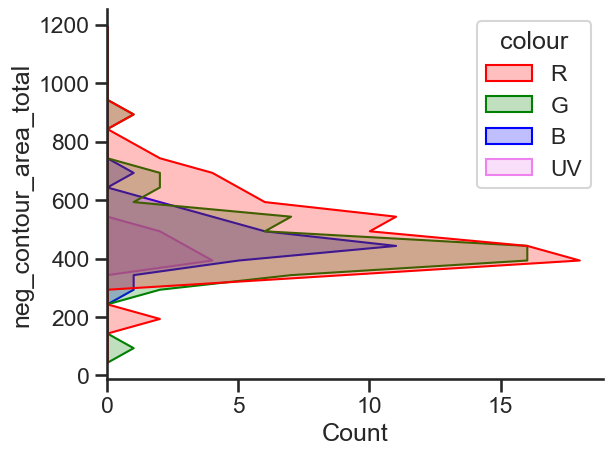

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (6, 12), sharey = True)

sns.histplot(data = chroma_rois.query("total_contour_count > 0"), y ="-contour_area_total", hue = "colour", element = "poly",
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[0], multiple = "layer", binrange = (20, 1200), binwidth = 25)
sns.histplot(data = chroma_rois.query("total_contour_count > 0"), y ="+contour_area_total", hue = "colour", element = "poly",
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[1], multiple = "layer", binrange = (20, 1200), binwidth = 25) #“layer”, “dodge”, “stack”, “fill”
titles = ["OFF", "ON"]
for n, i in enumerate(ax):
    i.legend([], frameon = False)
    i.set_title(titles[n])
ax[0].invert_xaxis()
ax[0].set_ylabel("")
#ax[1].yaxis.set_label_position("right")
ax[1].spines[['left']].set_visible(False)
plt.suptitle("Contour areas")
fig.tight_layout()


In [ ]:
chroma_rois.query("-contour_area_total > 0")["contour_area_total"].sort_values(ascending = False)

Series([], Name: contour_area_total, dtype: float64)

In [ ]:
test.columns

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'time_pval', 'space_pval', 'polarities', '-centroids', '+centroids',
       '-extrema', '+extrema', '-biphasic_index', '+biphasic_index',
       'pols_corr', '-auc', '+auc', '-peaktime', '+peaktime', '-contour_count',
       '+contour_count', 'total_contour_count', '-contour_areas',
       '+contour_areas', '-contour_area_total', '+contour_area_total',
       'contour_area_total', 'contour_complexity'],
      dtype='object')

In [ ]:
test = chroma_rois.query("contour_area_total > 0")
chroma_rois.query("+contour_count' > 0")

UndefinedVariableError: name 'contour_count' is not defined

C:\Users\SimenLab\AppData\Local\Temp\ipykernel_20212\3056340204.py:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data = chroma_rois.query("-total_contour_count > 0"), y ="-biphasic_index", hue = "colour",


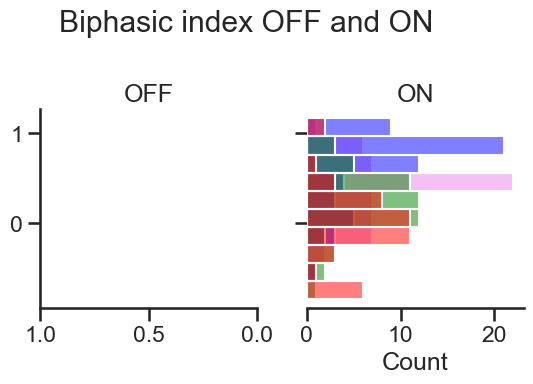

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (6, 4), sharey = True)
indeces = ["-biphasic_index","+biphasic_index", "polarities"]

sns.histplot(data = chroma_rois.query("-total_contour_count > 0"), y ="-biphasic_index", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[0], binwidth = .2, multiple = "layer")
sns.histplot(data = chroma_rois.query("+total_contour_count > 0"), y =indeces[1], hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues, ax = ax[1], binwidth = .2, multiple = "layer")
titles = ["OFF", "ON"]
for n, i in enumerate(ax):
    i.legend([], frameon = False)
    i.set_title(titles[n])
ax[0].invert_xaxis()
ax[0].set_ylabel("")
#ax[1].yaxis.set_label_position("right")
ax[1].spines[['left']].set_visible(False)
plt.suptitle("Biphasic index OFF and ON ")
fig.tight_layout()


<Axes: xlabel='+centroids', ylabel='+biphasic_index'>

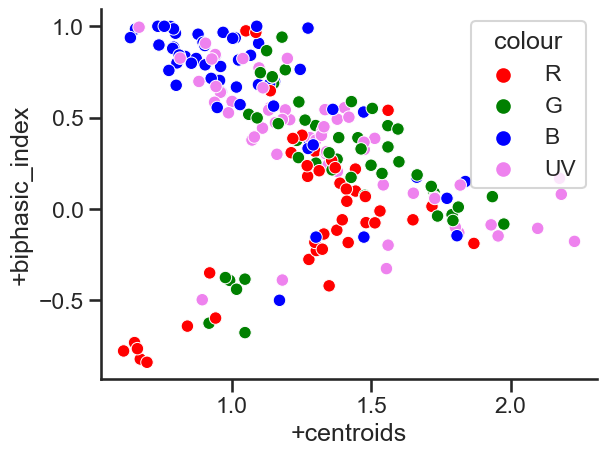

In [ ]:
sns.scatterplot(data = chroma_rois.query("contour_area_total > 0"), y = "+biphasic_index", x = "+centroids", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues)

<Axes: xlabel='contour_area_total', ylabel='total_contour_count'>

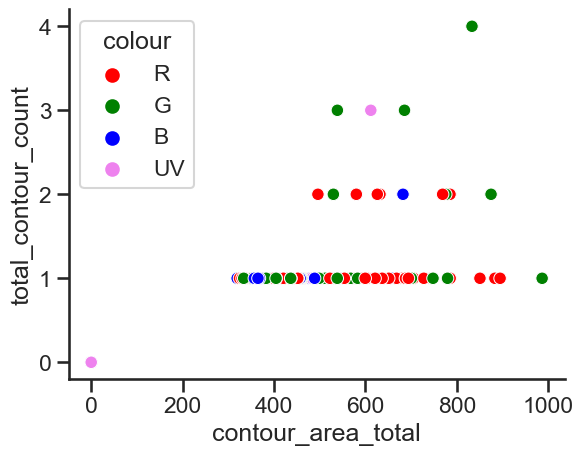

In [ ]:
sns.scatterplot(data = chroma_rois, y = "total_contour_count", x = "contour_area_total", hue = "colour", 
palette = chromatic_palette, hue_order=chromatic_hues)

In [ ]:
tempfile = filehandling.load_strf_data(r"D:\Igor analyses\230613\0_0_ColorSWN_200_0\2023-6-13_0_0_ColourSWN_200_0.h5")
tempdict = filehandling.build_results_dict(tempfile)

C:\Users\SimenLab\AppData\Local\Temp\ipykernel_15984\2770077536.py:1: UserWarning: Rotation detected and corrected for D:\Igor analyses\230613\0_0_ColorSWN_200_0\2023-6-13_0_0_ColourSWN_200_0.h5
  tempfile = filehandling.load_strf_data(r"D:\Igor analyses\230613\0_0_ColorSWN_200_0\2023-6-13_0_0_ColourSWN_200_0.h5")
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 5.560822148308134)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 3.6106830612499285)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold 

In [ ]:
# sizes_org = pd.unique(roi_df["size"].dropna())
# size_labels = np.round([au_to_visang(800), au_to_visang(400), au_to_visang(200), au_to_visang(100)], 2)
# size_labels = [np.round(unit_conversion.au_to_visang(x), 2) for x in sizes_org]
# size_order = [25, 50, 75, 100, 200, 400, 800]

In [ ]:
plotting.contouring

In [ ]:
roi_df.keys()

Index(['ipl_depths', 'strf_keys', 'multicolour', 'roi', 'date', 'path',
       'filename', 'colour', 'simultaneous', 'combo', 'size', 'shapeZ',
       'shapeY', 'shapeX', 'XYratio', 'visang_size', 'frequency', 'noise',
       'polarities', '-centroids', '+centroids', '-extrema', '+extrema',
       '-biphasic_index', '+biphasic_index', 'pols_corr', '-auc', '+auc',
       '-peaktime', '+peaktime', '-contour_count', '+contour_count',
       'total_contour_count', '-contour_areas', '+contour_areas',
       '-contour_area_total', '+contour_area_total', 'contour_area_total',
       '-areas_corrected', '+areas_corrected', '-areas_corrected_total',
       '+areas_corrected_total', 'area_total_corrected', 'notes'],
      dtype='object')

In [ ]:
rec_df

,multicolour,path,filename,colour,paired,combo,size,frequency,noise,rois_num,date,time,strfs_shape,ObjXYZ
0,True,D:\Igor analyses\230613\0_1_ColorSWN_200_0\202...,2023-6-13_Testimport_200.h5,RGBUV,NaN,NaN,200,NaN,NaN,76,2023-06-13,18:37:20,"(76, 20, 24, 40)","(-63692.0, -24556.0, -48354.0)"


In [ ]:
filehandling.load_strf_by_df_index(roi_df, 0).strfs[80]

IndexError: index 80 is out of bounds for axis 0 with size 76

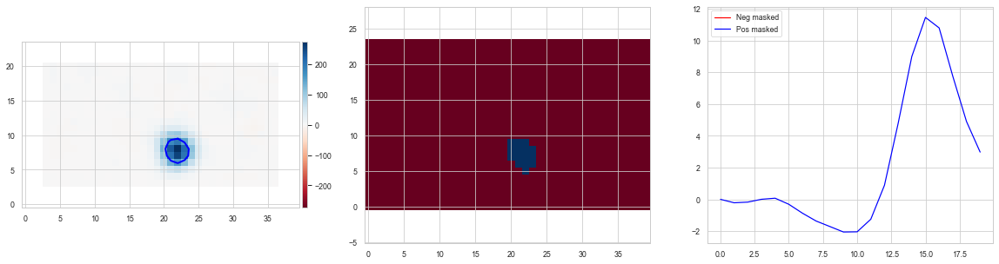

In [ ]:
plotting.contouring(filehandling.load_strf_by_df_index(roi_df, 0).strfs[17])

In [ ]:
# Querying 
# roi_df.query(f"polarities == -1")
# roi_df.query(f"`-peaktime` > 10").sort_values("-centroids")

#Sorting
roi_df.sort_values("total_contour_count")

# Filtering
# roi_df.filter(like='-', axis = 1)

# Complex
# roi_df.query("`-extrema` < -2 or `+extrema` > 2").sort_values("total_contour_count")
roi_df_noempties = roi_df.query("polarities.isnull() == False")
roi_chromatic = roi_df_noempties.query("colour == ['R', 'G', 'B', 'UV']")
roi_achromatic = roi_df_noempties.query("colour == ['BW', 'BWnoUV', 'BWB']") #BWB is a bug
# Account for BWB for now 
roi_achromatic = roi_achromatic.replace('BWB', 'BW')
roi_all_cleaned = roi_df_noempties.replace('BWB', 'BW')
#Soritng 
roi_chromatic.sort_values("contour_area_total");
# Other filters 
roi_chromatic_bignoise = roi_chromatic.query("size != (25, 50, 75)")

c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\pandas\core\missing.py:95: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  new_mask = arr == x


In [ ]:
roi_chromatic.query("time_pval < 0.05 & size == 200")

,ipl_depths,strf_keys,multicolour,roi,date,path,filename,colour,simultaneous,combo,...,+contour_areas_raw,-contour_area_total_raw,+contour_area_total_raw,contour_area_total_raw,-contour_areas,+contour_areas,-contour_area_total,+contour_area_total,contour_area_total,notes
81,NaN,STRF0_1,False,1,2022-08-24,D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_...,SMP_0_4_SWN_UV200_25p_0.h5,UV,n,NaN,...,"[6.97, 6.82, 7.09, 8.18, 4.94]",78.11,34.00,112.11,"[235.66792858736864, 324.718023740611, 398.251...","[156.73716242881292, 153.36405276391739, 159.4...",1756.490639,764.571524,2521.062164,
85,NaN,STRF0_5,False,5,2022-08-24,D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_...,SMP_0_4_SWN_UV200_25p_0.h5,UV,n,NaN,...,"[12.5, 5.87, 10.71, 7.83, 7.27]",95.04,44.18,139.22,"[88.15059924260353, 125.70455351177391, 1673.0...","[281.09247207462863, 132.0010248862456, 240.84...",2137.202284,993.493233,3130.695517,
86,NaN,STRF0_6,False,6,2022-08-24,D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_...,SMP_0_4_SWN_UV200_25p_0.h5,UV,n,NaN,...,"[11.34, 6.18, 8.62, 4.25, 6.69]",90.70,37.08,127.78,"[587.8205776024633, 241.7395259841806, 493.373...","[255.00709066610307, 138.9721181936964, 193.84...",2039.606977,833.832709,2873.439687,
88,NaN,STRF0_8,False,8,2022-08-24,D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_...,SMP_0_4_SWN_UV200_25p_0.h5,UV,n,NaN,...,"[9.48, 16.31, 5.81, 6.97, 5.19]",152.95,43.76,196.71,"[162.13413789264578, 118.73346020432314, 95.12...","[213.18053082139835, 366.7694575629754, 130.65...",3439.447488,984.048526,4423.496015,
89,NaN,STRF0_9,False,9,2022-08-24,D:\Igor analyses\220824\SMP_0_4_SWN_UV200_25p_...,SMP_0_4_SWN_UV200_25p_0.h5,UV,n,NaN,...,"[10.09, 10.65, 82.9, 6.25, 6.6]",29.54,116.49,146.03,"[140.9959839926337, 116.25984645006639, 84.552...","[226.8978434586402, 239.4907862075836, 1864.20...",664.277730,2619.556966,3283.834696,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1437,92.0,STRF0_17,False,17,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_6_SWN200_25p...,SMP_0_6_SWN200_25p_UV_0.h5,UV,n,NaN,...,"[8.31, 11.2, 3.57, 8.54, 9.27]",95.93,40.89,136.82,"[262.42793192887325, 277.9442363873928, 1177.4...","[186.87027543521313, 251.8588549788672, 80.280...",2157.216068,919.509695,3076.725762,
1443,83.0,STRF0_4,False,4,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_R_0.h5,R,n,NaN,...,"[7.62, 4.22, 13.72, 11.48, 4.39]",111.38,41.43,152.81,"[80.50488400217364, 77.5815222925975, 443.4514...","[171.3539709766936, 94.89681857239462, 308.527...",2504.646363,931.652889,3436.299253,
1445,95.0,STRF0_6,False,6,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_R_0.h5,R,n,NaN,...,"[5.93, 4.31, 6.58, 2.72]",122.74,19.54,142.28,"[77.1317743372781, 93.9973226617558, 81.629253...","[133.35026875220382, 96.92068437133194, 147.96...",2760.103202,439.403752,3199.506954,
1448,84.0,STRF0_9,False,9,2022-08-25,D:\Igor analyses\H5 exports\SMP_0_9_SWN200_25p...,SMP_0_9_SWN200_25p_R_0.h5,R,n,NaN,...,[0],117.81,0.00,117.81,"[64.31395761067502, 513.8370389524212, 1707.69...",[0.0],2649.240331,0.000000,2649.240331,


<Axes: xlabel='area_total_corrected', ylabel='Count'>

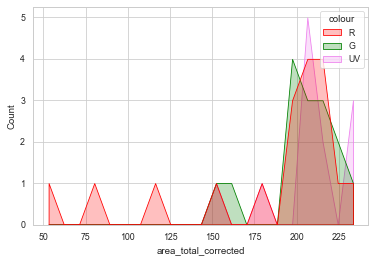

In [ ]:
sns.histplot(data = roi_df_noempties.query("size == 200"), x = "area_total_corrected", hue = 'colour', element = "poly", 
    multiple = "layer", palette=rgbuv_palette,  hue_order=["R", "G", "UV"])
# plt.legend(title='size', loc='upper right')
# plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\Life Sciences PhD Careers Symposium 2023\size_comparison_200.svg")

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:815: UserWarning: Rotation detected and corrected for D:\Igor analyses\230613\0_1_ColorSWN_200_0\2023-6-13_Testimport_200.h5
  return loaded_data
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:815: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\230613\0_1_ColorSWN_200_0\2023-6-13_Testimport_200.h5
  return loaded_data
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:439: UserWarning: Upper contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:439: UserWarning: Lower contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)


200 152.68943083093828


Text(0.5, 0.98, 'Example "W" kernel')

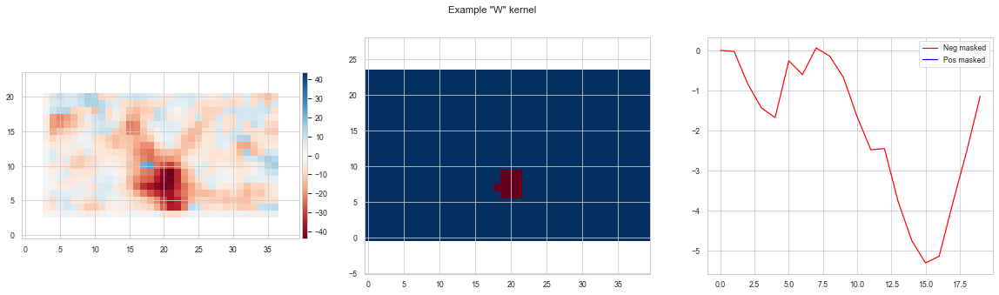

In [ ]:
df_search = roi_df_noempties.query("total_contour_count == 1 & size == 200").sort_values("area_total_corrected", ascending = True).reset_index()
index = 2
load = filehandling.load_strf_by_df_index(df_search, index)
roi = df_search["roi"][index]
plotting.contouring(load.strfs[roi])
print(df_search["size"][index], df_search["area_total_corrected"][index])
# plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\Life Sciences PhD Careers Symposium 2023\Smallest_RF.svg")
plt.suptitle('Example "W" kernel')

In [ ]:
df_search = roi_df_noempties.query("total_contour_count == 1 & size == 100").sort_values("-extrema", ascending = False).reset_index()
print(len(df_search))
# index = 4 # 4 # 9 # 11 # 18 for 200
index = 20
load = filehandling.load_strf_by_df_index(df_search, index)
print(load.strfs.shape)
plotting.play_movie(load.collapse_times())


102
(43, 20, 48, 76)


c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:769: UserWarning: Rotation detected and corrected for D:\Igor analyses\230502\2023-5-2_SMP_0_0_SWN_UV_100_0.h5
  loaded_data = load_strf_data(path)


(62, 24, 40)
62


Text(0.5, 0.98, 'Min and max projection of RF rec with offsets (colour not controlled for)')

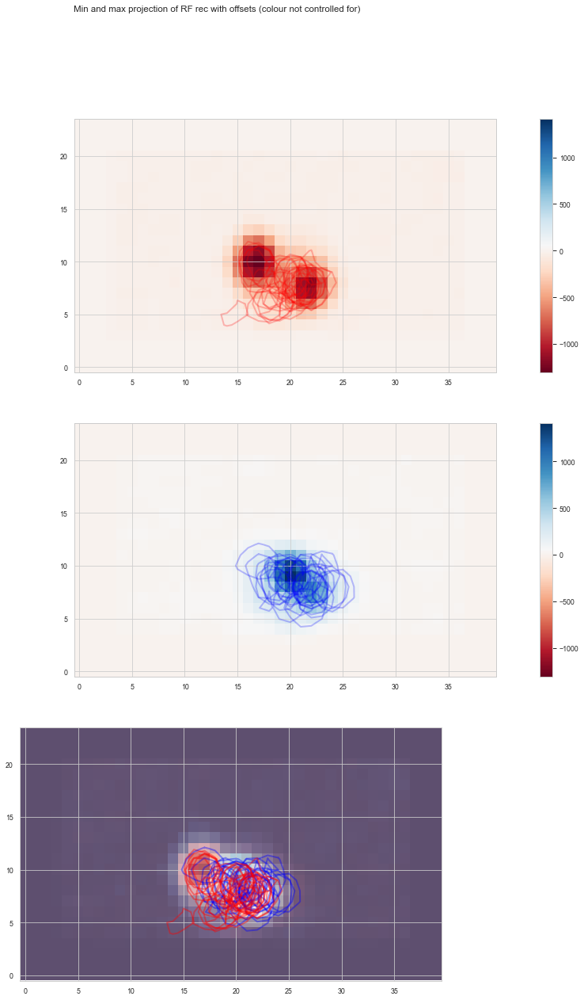

In [ ]:
# Kick out empty ish frames 
absolute_version = np.abs(load.collapse_times())
indeces_to_delete = np.unique(np.where(np.max(absolute_version, axis = (1,2)) < 45)[0]) # filtering criteria based on amplitudes
cleaned_version = np.delete(load.collapse_times(), indeces_to_delete, axis = 0)
print(cleaned_version.shape)
# Kick out contours accordingly 
contours = load.contours
cleaned_contours = list(np.delete(np.array(load.contours, dtype = "object"), indeces_to_delete, axis = 0))
print(len(cleaned_contours))

# Make projectsion 
min_projection = np.min(cleaned_version, axis = 0) 
max_projection = np.max(cleaned_version, axis = 0)
min_val = np.min(min_projection + 75)
max_val = np.max(max_projection - 75)

# create plot 
fig, ax = plt.subplots(3, 1, figsize = (20, 20))
cmap_modifier = 200
# Plot projections
minproj = ax[0].imshow(min_projection, cmap = 'RdBu', origin = "lower")
minproj.set_clim(min_val, max_val)
plt.colorbar(minproj, ax = ax[0])
# Plot the other projection
maxproj = ax[1].imshow(max_projection, cmap = 'RdBu', origin = "lower")
maxproj.set_clim(min_val, max_val)
plt.colorbar(maxproj, ax = ax[1])
# Plot their combination
combined2 = ax[2].imshow(min_projection, cmap = 'RdBu', alpha = 0.66, origin = "lower")
combined = ax[2].imshow(max_projection, cmap = 'RdBu', alpha = 0.33, origin = "lower")
# combined.set_clim(val_tup)
# combined2.set_clim(val_tup)

# Finally plot contours accordingly
for i in cleaned_contours:
    upper, lower = i
    if len(upper) != 0:
        for contour_up in upper:
            ax[0].plot(contour_up[:, 1], contour_up[:, 0], lw = 2, c = 'red', alpha = .25)# contour
            ax[2].plot(contour_up[:, 1], contour_up[:, 0], lw = 2, c = 'red', alpha = .4)# contour
    if len(lower) != 0:
        for contour_low in lower:
            ax[1].plot(contour_low[:, 1], contour_low[:, 0], lw = 2, c = 'blue', alpha = .25)# contour
            ax[2].plot(contour_low[:, 1], contour_low[:, 0], lw = 2, c = 'blue', alpha = .4)# contour
# ax[3].imshow(np.average(load.images, axis = 0), cmap = 'Greys_r', origin = "lower")
# plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\Life Sciences PhD Careers Symposium 2023\RF_tiling.svg")
plt.suptitle("Min and max projection of RF rec with offsets (colour not controlled for)")

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:769: UserWarning: Rotation detected and corrected for D:\Igor analyses\230201\2023-2-1_SMP_0_2_BWnoUV_100_5Hz_0.h5
  loaded_data = load_strf_data(path)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:438: UserWarning: Upper contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:438: UserWarning: Lower contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)


100 168.54304625594733


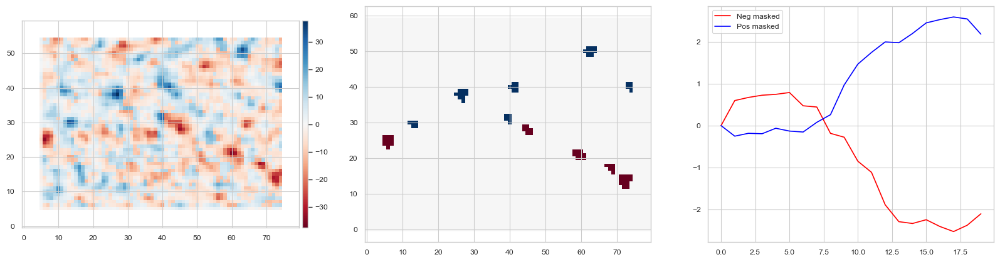

In [ ]:
df_search = roi_df_noempties.query("size == 100").sort_values("total_contour_count", ascending = False).reset_index()
index = 0
load = filehandling.load_strf_by_df_index(df_search, index)
roi = df_search["roi"][index]
plotting.contouring(load.strfs[roi])
print(df_search["size"][index], df_search["area_total_corrected"][index])
plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\Life Sciences PhD Careers Symposium 2023\Smallest_RF_100_variant.svg")

In [ ]:
plotting.play_movie(load.strfs[roi])

<Axes: xlabel='area_total_corrected', ylabel='Count'>

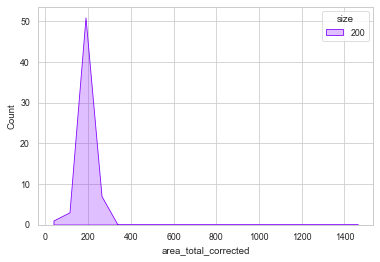

In [ ]:
sns.histplot(data = roi_df_noempties, x = "area_total_corrected", hue = 'size', element = "poly", 
    multiple = "layer", palette='rainbow',
    bins = 20,  binrange = (0, 1500))

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\filehandling.py:769: UserWarning: Rotation detected and corrected for D:\Igor analyses\230201\2023-2-1_SMP_0_2_R_100_5Hz_0.h5
  loaded_data = load_strf_data(path)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:438: UserWarning: Lower contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)


100 nan 1.7370508101090316


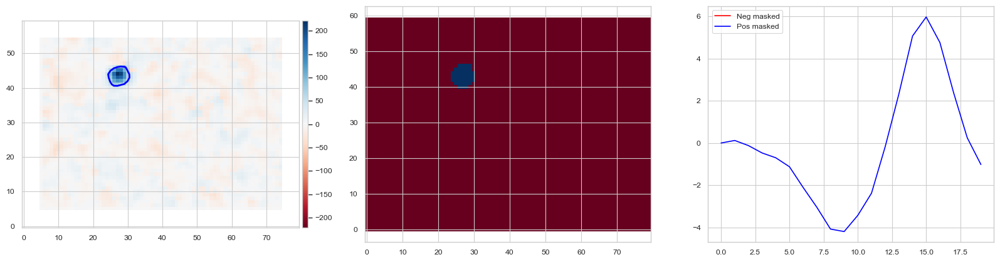

In [ ]:
# load =filehandling.load_strf_by_df_index(roi_df_noempties.query("total_contour_count > 0 & colour == 'UV'"), 88)
df_search = roi_df_noempties.query("total_contour_count == 1").sort_values("+centroids", ascending = False).reset_index()
index = 12
load = filehandling.load_strf_by_df_index(df_search, index)
roi = df_search["roi"][index]
plotting.contouring(load.strfs[roi])
print(df_search["size"][index], df_search["-centroids"][index], df_search["+centroids"][index])
plt.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\Life Sciences PhD Careers Symposium 2023\ON_timecourse_new.svg")

In [ ]:
plotting.play_movie(load.strfs[roi])

In [ ]:
plotting.play_movie(load.strfs[roi])

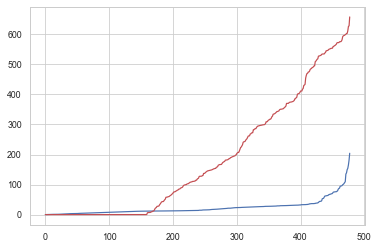

In [ ]:
one_sort = roi_df_noempties.sort_values("contour_area_total", ascending = True).reset_index(drop=True)
other_sort = roi_df_noempties.sort_values("area_total_corrected", ascending = True).reset_index(drop=True)
plt.plot(one_sort["contour_area_total"])
plt.plot(other_sort["area_total_corrected"], c = 'r')

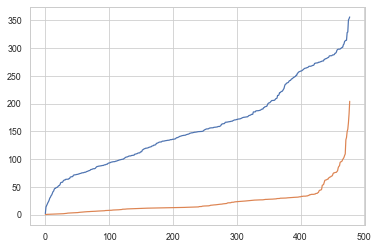

In [ ]:
new_sort = roi_df_noempties.sort_values("contour_area_total", ascending = True).reset_index(drop=True)

raw_areas = np.array(new_sort["contour_area_total"])
sizes = np.array(new_sort["size"])
new_areas = []
for area, size in zip(raw_areas, sizes):
    new_area = (unit_conversion.au_to_visang(size)**2 * area) / 4
    new_area = unit_conversion.area_conversion(area, size, 4)
    new_areas.append(new_area)
new_areas = np.array(new_areas)
plt.plot(np.sort(new_areas))
plt.plot(raw_areas)



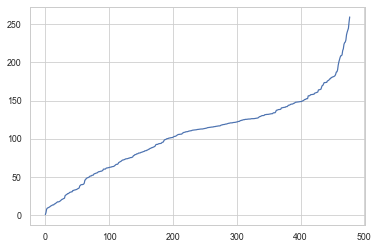

In [ ]:
plt.plot(new_sort["contour_area_total"])

In [ ]:
def numpy_fillna(data):
    if isinstance(data, np.ndarray) is False:
        data = np.array(data, dtype = object)
    # Get lengths of each row of data
    lens = np.array([len(i) for i in data])
    # Mask of valid places in each row
    mask = np.arange(lens.max()) < lens[:,None]
    # Setup output array and put elements from data into masked positions
    out = np.zeros(mask.shape, dtype=data.dtype)
    out[mask] = np.concatenate(data)
    return out

<Axes: xlabel='+centroids', ylabel='ipl_depths'>

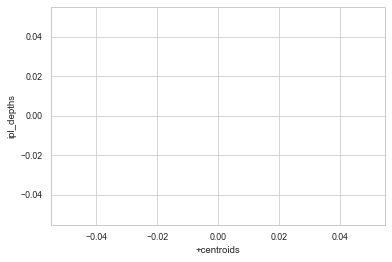

In [ ]:
sns.regplot(data = roi_chromatic.query("colour == 'R'"), x = "+centroids", y = "ipl_depths", color = 'r')
sns.regplot(data = roi_chromatic.query("colour == 'G'"), x = "+centroids", y = "ipl_depths", color = 'g')
sns.regplot(data = roi_chromatic.query("colour == 'UV'"), x = "+centroids", y = "ipl_depths", color = 'violet')

Text(0.5, 1.0, 'Centroids, ON responses')

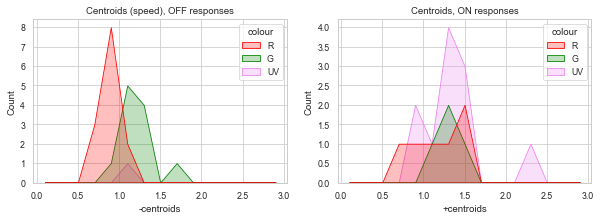

In [ ]:
df = roi_chromatic.query("total_contour_count  <= 2")
bins = 15
fig, ax = plt.subplots(1, 2, figsize = (10, 3))
sns.histplot(data = df, x = "-centroids", hue = 'colour', hue_order=["R", "G", "UV"],
    element="poly",  palette=rgbuv_palette, bins = bins, binrange=(0, 3), ax = ax[0])
ax[0].set_title("Centroids (speed), OFF responses")

sns.histplot(data = df, x = "+centroids", hue = 'colour', hue_order=["R", "G", "UV"],
    element = "poly",  palette=rgbuv_palette, bins = bins, binrange=(0, 3), ax = ax[1])
ax[1].set_title("Centroids, ON responses")

c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\seaborn\algorithms.py:98: RuntimeWarning: Mean of empty slice
  boot_dist.append(f(*sample, **func_kwargs))
c:\Users\SimenLab\miniconda3\envs\strf_beta\lib\site-packages\numpy\lib\nanfunctions.py:1556: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,


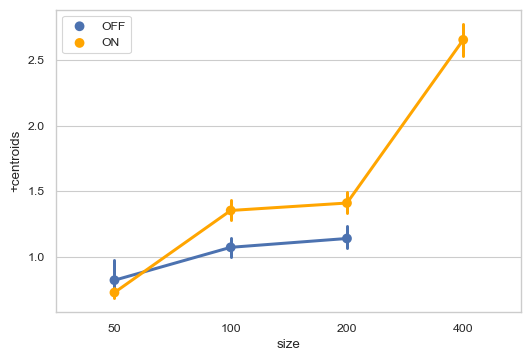

In [ ]:
query_df = df.query("total_contour_count < 10")
sns.pointplot(data = query_df, x ="size", y ="-centroids", label ="OFF")
sns.pointplot(data = query_df, x ="size", y ="+centroids", label ="ON", color = "orange")
plt.legend()

Text(0.5, 0, 'Polarity')

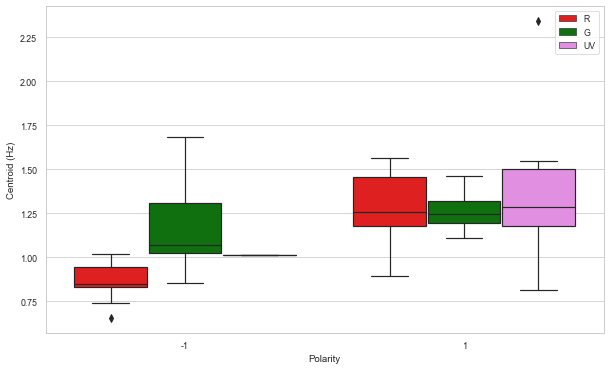

In [ ]:
fig, ax = plt.subplots(figsize = (10, 6))
query = roi_df
sns.boxplot(data = query, y = "-centroids", x = "polarities", hue = "colour", 
    order = [-1, 1], hue_order=("R", "G", "UV"), palette= rgbuv_palette, ax = ax)
handles, labels = ax.get_legend_handles_labels()
sns.boxplot(data = query, y = "+centroids", x = "polarities", hue = "colour", 
    order = [-1, 1], hue_order=("R", "G", "UV"), palette= rgbuv_palette, ax = ax)
plt.legend(handles, labels)
plt.ylabel("Centroid (Hz)")
plt.xlabel("Polarity")


Text(0.5, 0, 'Polarity')

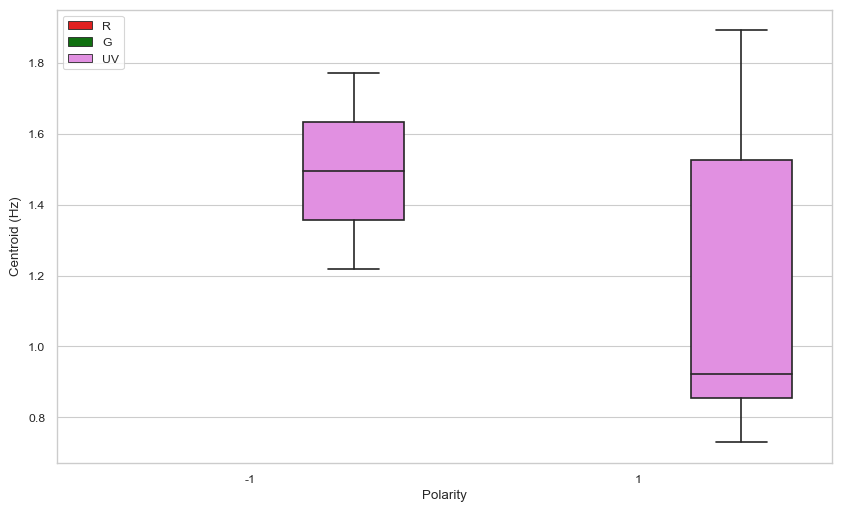

In [ ]:
fig, ax = plt.subplots(figsize = (10, 6))
query = roi_df.query("colour == 'UV' & size == 200")
sns.boxplot(data = query, y = "-centroids", x = "polarities", hue = "colour", 
    order = [-1, 1], hue_order=("R", "G", "UV"), palette= rgbuv_palette, ax = ax)
handles, labels = ax.get_legend_handles_labels()
sns.boxplot(data = query, y = "+centroids", x = "polarities", hue = "colour", 
    order = [-1, 1], hue_order=("R", "G", "UV"), palette= rgbuv_palette, ax = ax)
plt.legend(handles, labels)
plt.ylabel("Centroid (Hz)")
plt.xlabel("Polarity")

Text(0.5, 0, 'Polarity')

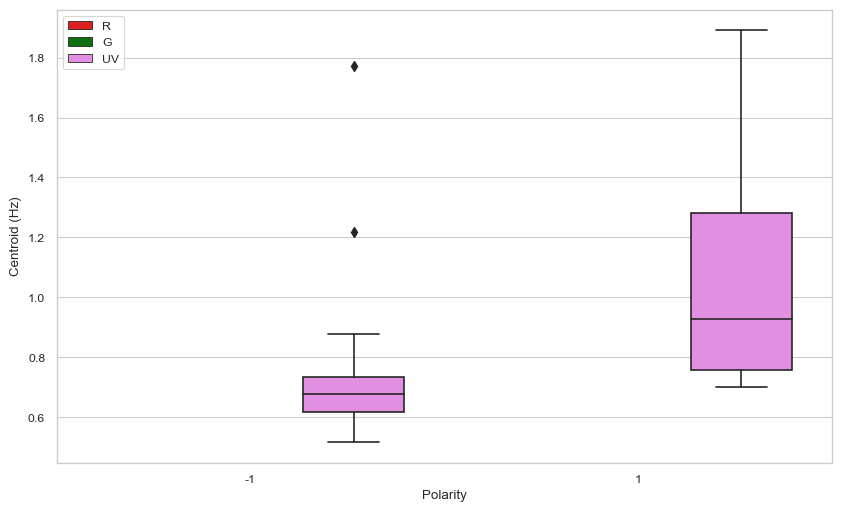

In [ ]:
fig, ax = plt.subplots(figsize = (10, 6))
query = roi_df.query("colour == 'UV' & size == [100, 200]")
sns.boxplot(data = query, y = "-centroids", x = "polarities", hue = "colour", 
    order = [-1, 1], hue_order=("R", "G", "UV"), palette= rgbuv_palette, ax = ax)
handles, labels = ax.get_legend_handles_labels()
sns.boxplot(data = query, y = "+centroids", x = "polarities", hue = "colour", 
    order = [-1, 1], hue_order=("R", "G", "UV"), palette= rgbuv_palette, ax = ax)
plt.legend(handles, labels)
plt.ylabel("Centroid (Hz)")
plt.xlabel("Polarity")

<Axes: xlabel='polarities', ylabel='+centroids'>

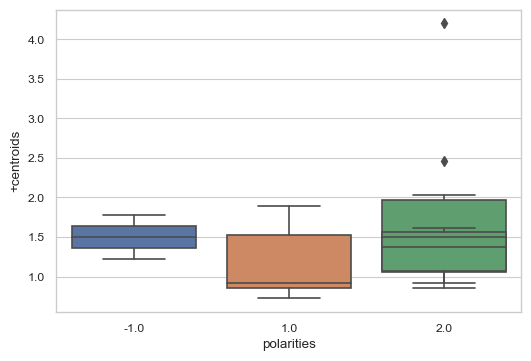

In [ ]:
sns.boxplot(query.query("size == 200 & contour_area_total > 0"), y = "-centroids", x = "polarities")
sns.boxplot(query.query("size == 200 & contour_area_total > 0"), y = "+centroids", x = "polarities")

<Axes: xlabel='polarities', ylabel='+centroids'>

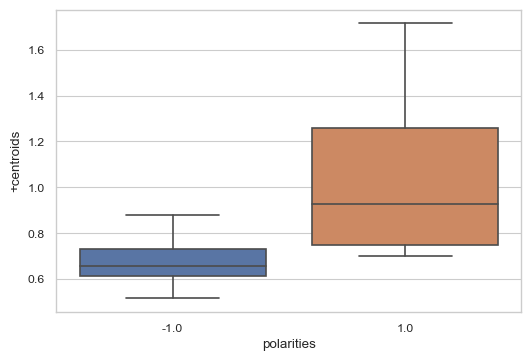

In [ ]:
sns.boxplot(query.query("size == 100 & contour_area_total > 0"), y = "-centroids", x = "polarities")
sns.boxplot(query.query("size == 100 & contour_area_total > 0"), y = "+centroids", x = "polarities")

<Axes: xlabel='polarities', ylabel='+centroids'>

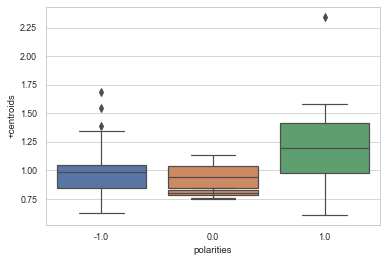

In [ ]:
sns.boxplot(query.query("contour_area_total > 0"), y = "-centroids", x = "polarities")
sns.boxplot(query.query("contour_area_total > 0"), y = "+centroids", x = "polarities")

<Axes: xlabel='-centroids', ylabel='Count'>

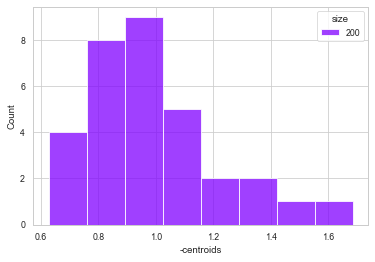

In [ ]:
sns.histplot(data = roi_df, x = "-centroids", hue = "size", palette="rainbow", multiple = "stack")

<Axes: xlabel='+centroids', ylabel='Count'>

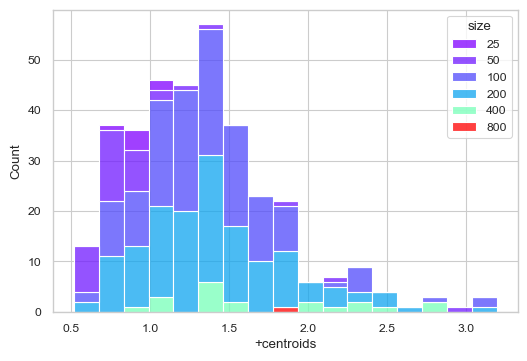

In [ ]:
sns.histplot(data = roi_df, x = "+centroids", hue = "size", palette="rainbow", multiple = "stack")

In [ ]:
fig.savefig(r"C:\Users\SimenLab\OneDrive\Universitet\PhD\Conferences\Life Sciences PhD Careers Symposium 2023\centroids.svg")

In [ ]:
1 - (1/1.33)

0.24812030075187974

In [ ]:
df.query("colour == 'UV'")[["-centroids", "+centroids"]].describe()

,-centroids,+centroids
count,18.000000,40.000000
mean,0.675542,1.165983
std,0.095425,0.473668
min,0.517121,0.699791
25%,0.614541,0.812437
50%,0.662850,1.060814
75%,0.729738,1.417680
max,0.890719,2.768247


In [ ]:
df.query("colour == 'UV'")[["-centroids", "+centroids"]].describe()

,-centroids,+centroids
count,18.000000,40.000000
mean,0.675542,1.165983
std,0.095425,0.473668
min,0.517121,0.699791
25%,0.614541,0.812437
50%,0.662850,1.060814
75%,0.729738,1.417680
max,0.890719,2.768247


In [ ]:
name_it = "Centroids by colour and polarity"
fig.savefig(rf"C:\Users\SimenLab\OneDrive\Universitet\PhD\Thesis committee\Report 2\{name_it}.svg")

In [ ]:
roi_df["-contour_areas"]

0                      [0.0]
1       [20.865186813186813]
2                      [0.0]
3       [17.450883516483515]
4       [16.692149450549447]
                ...         
1391                   [0.0]
1392                   [0.0]
1393                   [0.0]
1394                   [0.0]
1395                   [0.0]
Name: -contour_areas, Length: 1396, dtype: object

Text(0.5, 1.0, 'Size-dependency')

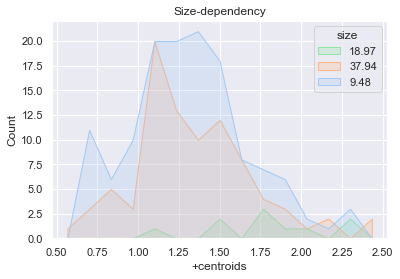

In [ ]:
sns.histplot(data = roi_all_cleaned, x = "+centroids", hue = 'size', element = "poly", 
    multiple = "layer", palette='pastel', hue_order=size_order,
    bins = 15, binrange=(0.5, 2.5))
plt.legend(title='size', loc='upper right', labels = size_labels)
plt.title("Size-dependency")

Text(0.5, 1.0, 'Centroids, negative timecourses')

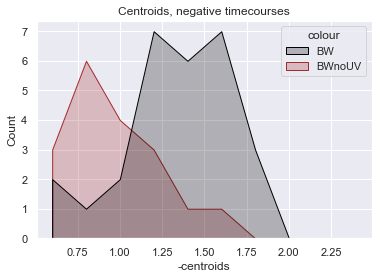

In [ ]:
sns.histplot(data = roi_achromatic, x = "-centroids", hue = 'colour', hue_order=["BW", "BWnoUV"],
    element = "poly",  palette=achromatic_palette, bins = 10, binrange=(0.5, 2.5))
plt.title("Centroids, negative timecourses")

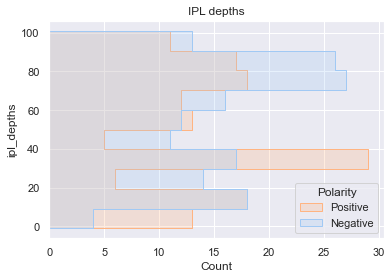

In [ ]:
sns.histplot(data = roi_df.query("polarities == [-1, 1]"), y = "ipl_depths", hue = "polarities",
    element = "step", multiple = "layer", palette='pastel')
plt.title("IPL depths")
plt.legend(loc = 'lower right', labels = ["Positive", "Negative"], title = "Polarity")

Text(0.5, 1.0, 'IPL depths OFF responses')

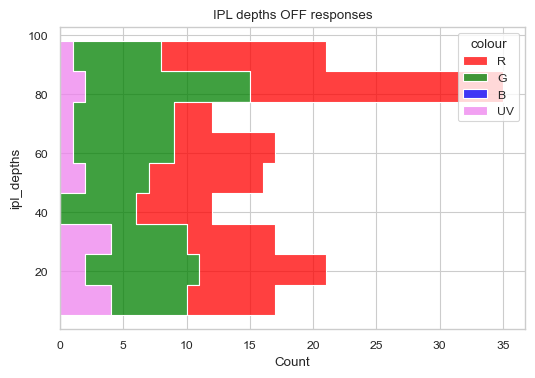

In [ ]:
sns.histplot(data = roi_chromatic.query("polarities == -1"), y = "ipl_depths", hue = "colour", hue_order = ["R", "G", "B", "UV"],
    element = "step", multiple = "stack", palette=chromatic_palette)
plt.title("IPL depths OFF responses")


Text(0.5, 1.0, 'IPL depths ON responses')

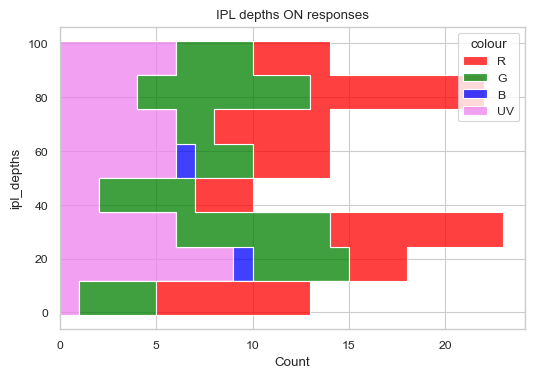

In [ ]:
sns.histplot(data = roi_chromatic.query("polarities == 1"), y = "ipl_depths", hue = "colour", hue_order = ["R", "G", "B", "UV"],
    element = "step", multiple = "stack", palette=chromatic_palette)
plt.title("IPL depths ON responses")

In [ ]:
roi_chromatic.keys()

Index(['ipl_depths', 'roi', 'filename', 'colour', 'paired', 'combo', 'size',
       'frequency', 'noise', 'polarities', '-centroids', '+centroids',
       '-extrema', '+extrema', '-biphasic_index', '+biphasic_index',
       'pols_corr', '-auc', '+auc', '-peaktime', '+peaktime', '-contour_count',
       '+contour_count', 'total_contour_count', '-contour_areas',
       '+contour_areas', '-contour_area_total', '+contour_area_total',
       'contour_area_total', 'notes'],
      dtype='object')

Text(0.5, 1.0, 'Contour counts $(> 0)$')

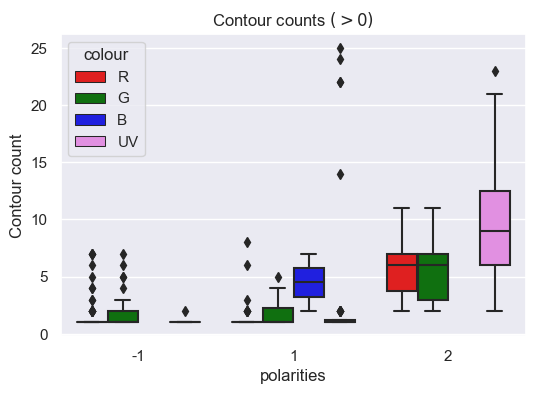

In [ ]:
sns.boxplot(data = roi_chromatic.query("total_contour_count.notna() and total_contour_count > 0"), y = "total_contour_count", x = "polarities", hue = "colour", 
    order = [-1, 1, 2], hue_order=chromatic_hues, palette= chromatic_palette)
plt.ylabel("Contour count")
plt.title("Contour counts $(> 0)$")

Text(0.5, 1.0, 'Contour counts $(> 0)$')

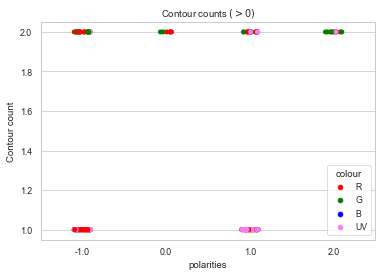

In [ ]:
#roi_chromatic.query("total_contour_count.notna() and total_contour_count > 0")
sns.stripplot(data = df, y = "total_contour_count", x = "polarities", hue = "colour", 
    hue_order=chromatic_hues, palette= chromatic_palette)
plt.ylabel("Contour count")
plt.title("Contour counts $(> 0)$")

Text(0.5, 1.0, 'IPL depths MIXED responses')

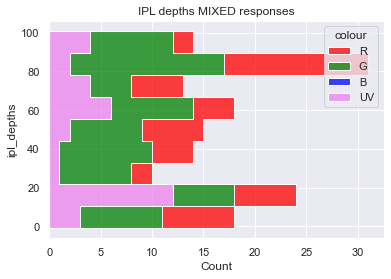

In [ ]:
sns.histplot(data = roi_chromatic.query("polarities == 2"), y = "ipl_depths", hue = "colour", hue_order = ["R", "G", "B", "UV"],
    element = "step", multiple = "stack", palette=chromatic_palette)
plt.title("IPL depths MIXED responses")

In [ ]:
roi_df.keys()

Index(['ipl_depths', 'roi', 'filename', 'colour', 'paired', 'combo', 'size',
       'frequency', 'noise', 'polarities', '-centroids', '+centroids',
       '-extrema', '+extrema', '-biphasic_index', '+biphasic_index',
       'pols_corr', '-auc', '+auc', '-peaktime', '+peaktime', '-contour_count',
       '+contour_count', 'total_contour_count', '-contour_areas',
       '+contour_areas', '-contour_area_total', '+contour_area_total',
       'contour_area_total', 'notes'],
      dtype='object')

In [ ]:
roi_all_cleaned["contour_area_total"].describe()

count      479.000000
mean      2831.679278
std       3042.358143
min         41.619244
25%        647.628797
50%       1081.775193
75%       5387.090893
max      21142.575945
Name: contour_area_total, dtype: float64

Text(0.5, 0, 'vis.ang.$\\degree^2$')

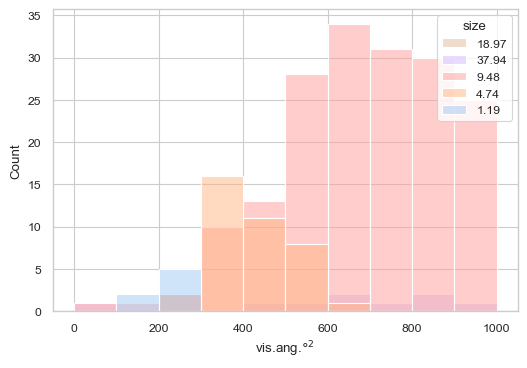

In [ ]:
sns.histplot(data = roi_all_cleaned, x = "contour_area_total", 
    hue = "size", palette="pastel", hue_order=size_order, multiple="layer", binrange = (0, 1000))
plt.legend(title='size', loc='upper right', labels = size_labels)
# plt.title("RF area in vis.ang.$\degree^2$");
plt.xlabel("vis.ang.$\degree^2$")

Text(0.5, 0, 'vis.ang.$\\degree^2$')

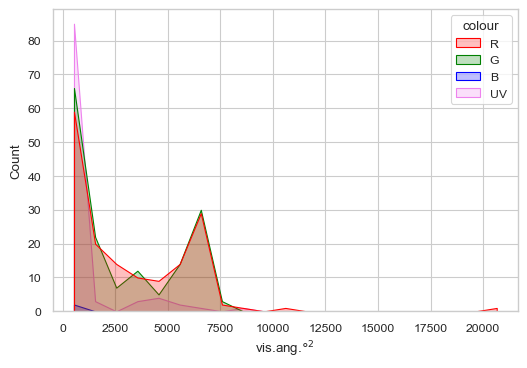

In [ ]:
sns.histplot(data = roi_chromatic, x = "contour_area_total", hue = "colour", hue_order = ["R", "G", "B", "UV"],
    element = "poly", multiple = "layer", palette=chromatic_palette)#, binrange = (0, 3000))
plt.xlabel("vis.ang.$\degree^2$")

### Make beutiful RF plot with contour 

## Per file analysis

Grab specific file if need be 

In [ ]:
# Specify file
file_path =r"D:\Igor analyses\230505\2023-5-5_MP_0_1_SWN_R_25_.h5"
# Get the data
Data = filehandling.load_strf_data(file_path)

C:\Users\SimenLab\AppData\Local\Temp\ipykernel_23776\456684172.py:7: UserWarning: HDF5 key 'Positions' not found for file D:\Igor analyses\230505\2023-5-5_MP_0_1_SWN_R_25_.h5
  Data = filehandling.load_strf_data(file_path)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Upper contour did not pass arithmetic threshold criteria (half abs-max = 7.0558716639776495)
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\contouring.py:178: UserWarning: Passed array did not meet absolute threshold criteria of 4
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)


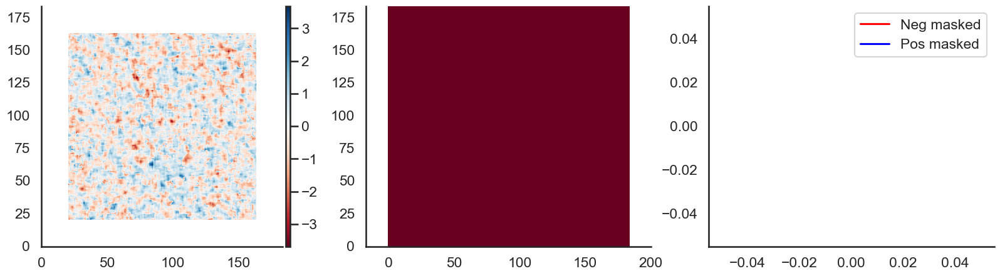

In [ ]:
# # Get contours
roi = 12
neg_contour, pos_contours = Data.contours[roi]
plotting.contouring_demo(Data.strfs[roi])

In [ ]:
plotting.play_movie(Data.strfs[roi])

c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:438: UserWarning: Lower contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:438: UserWarning: Upper contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\SimenLab\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\utilities.py:116: UserWarning: Destructive method. You lose data, with no way of recovering original shape!
  warnings.warn("Destructive method. You lose data, with no way of recovering original shape!")


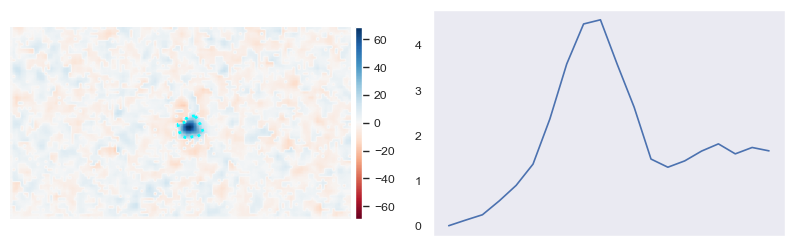

In [ ]:
sns.set_theme('paper')
# Load up the data 
lower_contour, upper_contour = load_file.contours[roi]
# Create the image 
fig, ax = plt.subplots(1, 2, figsize = (10, 3))
# Kil the mask, fill it with 0s, and remove those 0s 
original = load_file.collapse_times()[roi].filled(0)
picutre = utilities.auto_remove_border(original)
# Work out how much border was killed 
centre_coordinate = (round(original.shape[0] / 2), round(original.shape[1] / 2))
lower_border_wdith = np.count_nonzero(original[centre_coordinate[0]:, centre_coordinate[1]:centre_coordinate[1]+1] == 0) 
left_border_width  = np.count_nonzero(original[centre_coordinate[0]:centre_coordinate[0]+1, centre_coordinate[1]:] == 0) 
# Plot image and contours 
im = ax[0].imshow(picutre, origin = "lower", cmap = 'RdBu')
for j in lower_contour:
    ax[0].plot(j[:, 1]-left_border_width, j[:, 0]-lower_border_wdith, lw = 2, ls = 'dotted', c = 'red')# contour
for j in upper_contour: # corrected by killed information
    ax[0].plot(j[:, 1]-left_border_width, j[:, 0]-lower_border_wdith, lw = 2, ls = 'dotted', c = 'cyan')# contour 
# Correct colourmap and such, add 
max_Val = np.max(np.abs(load_file.collapse_times()[roi]))
im.set_clim(-max_Val, max_Val)
ax[0].axis('off')
divider1 = make_axes_locatable(ax[0])
cax1 = divider1.append_axes('right', size='2%', pad=0.05) #autoscaling "pretend" axis to append colorbar to
fig.colorbar(im, cax = cax1)
# Plot the timecourse
ax[1].plot(load_file.timecourses[roi][0], c = 'r')
ax[1].plot(load_file.timecourses[roi][1], c = 'b')
ax[1].set_xticks([])
ax[1].grid(False)


### If happy, save it

In [ ]:
fig.savefig(rf"C:\Users\SimenLab\OneDrive\Universitet\PhD\Thesis committee\Report 2\{file_loc.name}_roi_{roi}.svg")

# Tangential analysis stuff

9.1 boxes across 85.306 degrees. That means each box is very nearly 9.5 degree vis ang (more like 9.387 smth)
Each box is 200pix * 9.1 boxes = 1820 pix across screen, which agrees with QDSpy.ini (and 200*5.7 = 1140 in height)
The STA is 20 boxes wide and 15 boxes tall, * 4 = 80, 60

The bigger the box size on display, the more the values should be scaled UP because the input STA is the same size. So, responses to for example 6 x 2 boxes (in extreme cases like 800um), will lead to just a small amount of pixels in the 15 x 20 condition. Thus, the size is UNDER-exaggurated. If the displayed boxes are smaller (100, 12x18), it will be more comparable to the 15x20 array and the scaling should be far closer to 0. If the box size is so small that the displayed checkerboard is smaller than the screen size, then we should get a value scale by lower than 1. 

In [ ]:
# Initialise phyisical parameters
fish_screen_dist_mm = 160 # measured from fish to center
screen_width_mm = 300 # total width 
screen_half_width_mm = screen_width_mm/2 # right-angle
# According to pythagorean theorem 
hypoth_mm = np.sqrt(fish_screen_dist_mm**2 + screen_half_width_mm**2)
# Compute angle between fish and one side of screen (such that we get a right angel) 
sin = screen_half_width_mm / hypoth_mm # oppose/hypth
cos = fish_screen_dist_mm / hypoth_mm # adjecent/hypth
tan =  screen_half_width_mm /fish_screen_dist_mm # opposite/adjecent 
# Sanity check 
arcsin = np.round(np.arcsin(sin), 8)
arccos = np.round(np.arccos(cos), 8)
arctan = np.round(np.arctan(tan), 8)
assert np.isclose(arcsin, arccos, arctan)
# Get screen width in degrees vis ang 
half_screen_vis_ang = np.rad2deg(arcsin)
screen_vis_ang = half_screen_vis_ang * 2 # because two right angle triangles added, e.g. 2x the angle 
print("Screen is", np.round(screen_vis_ang, 3), "degrees wide")

Screen is 86.305 degrees wide


In [ ]:
1140/1820 * 86.305

54.05917582417583

In [ ]:
# Initilaise software parameters
screen_width_pix_au = 1820 # QDSpy display area in QDSpy units (confusingly named 'um' but is arbitrary unit (so 'au'))
screen_height_pix_au = 1140
block_size_au = 25 # squared
# Calculte the visang per pix 
single_pix_visang = screen_vis_ang / screen_width_pix_au
# Calculate block vis ang 
block_visang = single_pix_visang * block_size_au
# Work out how many blocks fit on on screen 
blocks_on_screen_horz = screen_width_pix_au/block_size_au
blocks_on_screen_vert = screen_height_pix_au/block_size_au

print("Screen is", (blocks_on_screen_vert, blocks_on_screen_horz), "pix")
print("Pix size vis ang", block_visang)

Screen is (45.6, 72.8) pix
Pix size vis ang 1.1855052109581246


In [ ]:
54.059 / 9.5

5.690421052631579

# Work in progres stuff 

### Stuff that needs to be implemented

- I have planned to add more metrics such as:
    - [x] Amplitudes for timecourses
    - Onset timing (spectral centroid kinda does this indirectly)
    - [x] Time-to-extrema
    - [x] Polarity-index which is relative weighting of positive and negative comopnents (AUC)
 - ... + morphology
    - Centroids on grid (positioning, coverage, etc)
    - [x] Number of contours
    - Size
    - Complexiy of contour (https://iapg.jade-hs.de/files/iapg/mitglieder/brinkhoff/paper/GIS95.pdf)
    - Eccentricity

## Need to 
- Get combiend area of all contours --> See notes
    - For contours need to do this: https://stackoverflow.com/questions/50102650/how-to-get-contour-area-in-skimage
    - For mask just take number of pixels masked 
    - Just do both and comapre how different they are, might be useful to know anyways 
- Correlation coefficinet (Pearson's should do) for negative and positive components (call it 'negposcorrcoef' for maximum confusion and typos)

In [ ]:
# Specify file and ROI
filename = "2022-10-20_SMP_0_3_SWN_200_R_0.h5"
roi = 6
# Get the content 
path = rec_df.query(f'filename == "{filename}"').iloc[0]["path"]
print(path)
# Get the data
Data = filehandling.load_strf_data(path)
# # Get contours
neg_contour, pos_contours = Data.contours[roi]

C:\Users\Simen\Downloads\All H5s\2022-10-20_SMP_0_3_SWN_200_R_0.h5


c:\Users\Simen\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:410: UserWarning: Upper contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)
c:\Users\Simen\OneDrive\Universitet\PhD\GitHub repos\RF_analysis\space.py:410: UserWarning: Lower contour did not pass threshold criteria
  contour_lower, contour_upper = _draw_contour_bipolar(arr_2d, abs_criteria)


In [ ]:
# print(len([i for i in Data.contours_area]))
# print(len(Data.strfs))
neg_contour_areas, pos_contour_areas = [i[0] for i in Data.contours_area], [i[1] for i in Data.contours_area]
tot_neg_contour_areas, tot_pos_contour_areas = [np.sum(i) for i in neg_contour_areas], [np.sum(i) for i in pos_contour_areas]
np.sum((tot_neg_contour_areas, tot_pos_contour_areas), axis = 0)

array([ 0.  ,  0.  , 83.31,  0.  ,  0.  ,  0.  , 87.32, 50.62,  0.  ,
        0.  , 38.95,  0.  , 65.64,  0.  , 59.04, 64.96, 77.33, 69.49,
        0.  , 82.52,  0.  ])

In [ ]:
# Data.contours_area

21

### Area 

Areas as sum of masked pixels
78 51


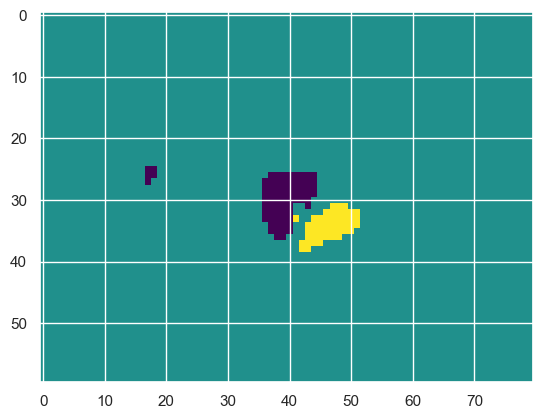

In [ ]:
# (np.unique(Data.rf_masks_combined()[5].flatten(), return_counts=True))
print("Areas as sum of masked pixels")
neg_areas = np.sum(np.invert(Data.rf_masks())[0], axis = (1, 2))[roi]
pos_areas = np.sum(np.invert(Data.rf_masks())[1], axis = (1, 2))[roi]
neg_areas, pos_areas
plt.imshow(Data.rf_masks_combined()[roi], cmap = 'viridis')
print(neg_areas, pos_areas)

In [ ]:
Data.contours_area()[6]
plotting.contouring(Data.strfs[4])

TypeError: 'list' object is not callable

In [ ]:
np.sum(Data.contours_area[6], axis = 1)

# for i in Data.contours_area():
#     print(",", np.sum(i[0]), np.sum(i[1]))

[(np.sum(i[0])) for i in Data.contours_area]

[0.0,
 0.0,
 36.92,
 0.0,
 0.0,
 0.0,
 53.37,
 50.62,
 0.0,
 0.0,
 0.0,
 0.0,
 65.64,
 0.0,
 59.04,
 16.62,
 74.80000000000001,
 9.709999999999999,
 0.0,
 53.63,
 0.0]

In [ ]:
1.3/20

0.065

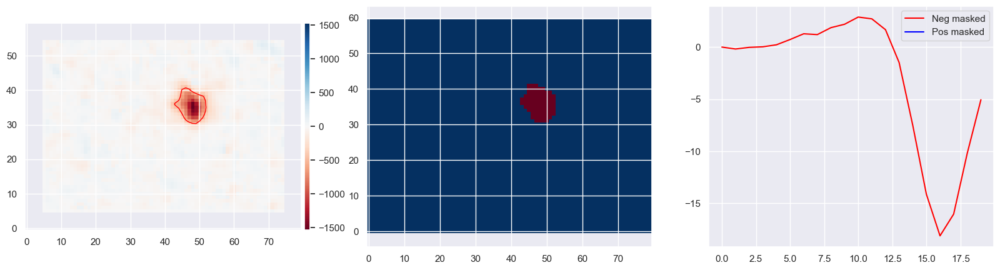

In [ ]:
fig, ax, im = plotting.contouring(Data.strfs[4], returns = True)

In [ ]:
3**2

9

In [ ]:
# Working on a df implementation of this
space.contour_centroid(Data.contours[roi][0])

array([[25.56156014, 17.0436908 ],
       [29.97874641, 39.36513216]])

In [ ]:
# DONT DELETE;THIS IS RECIPE
# VVV This should just work within the class

neg_contours, pos_contours = Data.contours[roi]
neg_centroids = space.contour_centroid(neg_contours)
neg_centroid_avg = np.average(neg_centroids, axis = 0, weights=Data.contours_area[roi][0]) # These might have to be weighted by relative contribution (so... area)
pos_centroids = space.contour_centroid(pos_contours)
pos_centroid_avg = np.average(pos_centroids, axis = 0, weights=Data.contours_area[roi][1])

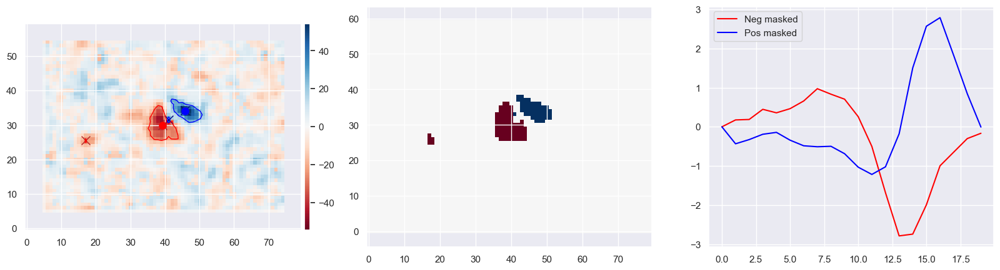

In [ ]:
fig, ax, im = plotting.contouring(Data.strfs[roi], returns = True)
ax[0].scatter(pos_centroids[:, 1], pos_centroids[:, 0], c = 'navy', marker = 'x', lw=1, s = 100)
ax[0].scatter(pos_centroid_avg[1], pos_centroid_avg[0], c = 'blue', marker = 'o', lw=2, s = 50)
ax[0].scatter(neg_centroids[:, 1], neg_centroids[:, 0], c = 'firebrick', marker = 'x', lw=1, s = 100)
ax[0].scatter(neg_centroid_avg[1], neg_centroid_avg[0], c = 'red', marker = 'o', lw=2, s = 50)